* This is the attenuation for 60 lines laterally and 15 mm axially. It depends on the threshold. So I should change the threshold to get maximum separation. The problem is if I change the threshold to get a good BSC separation then the ATT won't be good. 

* If I change the threshold to get good ATT, then the BSC won't be good. 

* But the threshold has to be around 9% +- 3% 

* The BSC is very robust once the ATT is fixed, somewhat. It is less variant than the ATT

* It doesn't matter if I change the size of the ROI window of the ATT, the result doesn't seem like it improves at alll. So it makes sense to look at the attenuation result first before looking at the BSC. 

* There is a deeper issue here, I don't think that I can fix it. The more I fix it, the worse it get. 

The problem is the fix does not have a physical based values. 


In [2]:
import h5py
import os
import scipy.io
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import glob, os
from sklearn.utils import shuffle

# Machine learning
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn import svm
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import scale
from scipy.stats import ttest_ind

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/Users/trongnguyen/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
sns.set_context("poster", rc={"font.size":20,"axes.titlesize":20,"axes.labelsize":20}) 
import matplotlib 
matplotlib.rc('xtick', labelsize=10) 
matplotlib.rc('ytick', labelsize=16) 
sns.set_style('darkgrid')

In [5]:
os.chdir('/Users/trongnguyen/Dropbox/FattyLiver/src/hydrogen/')
from helper_brl.visualizeHelper import extract_segment_points, envDetection, filter_frame
from helper_brl import fattyLiver
from helper_brl.fattyLiver import get_training_data, get_testing_data, choose_testing_rabbits_indices
from helper_brl.outlierDetection import getBSC_Att, getBSC_Att_old, filter_bsc, \
filter_BSC_based_on_depth, findOutliers, filter_ATT_curve
from helper_brl import frequencyAnalysis
from helper_brl.formFactor import get_ESD_EAC, gaussian_form_factor_bsc, exponential_form_factor_bsc

In [6]:
%qtconsole

# Load Data

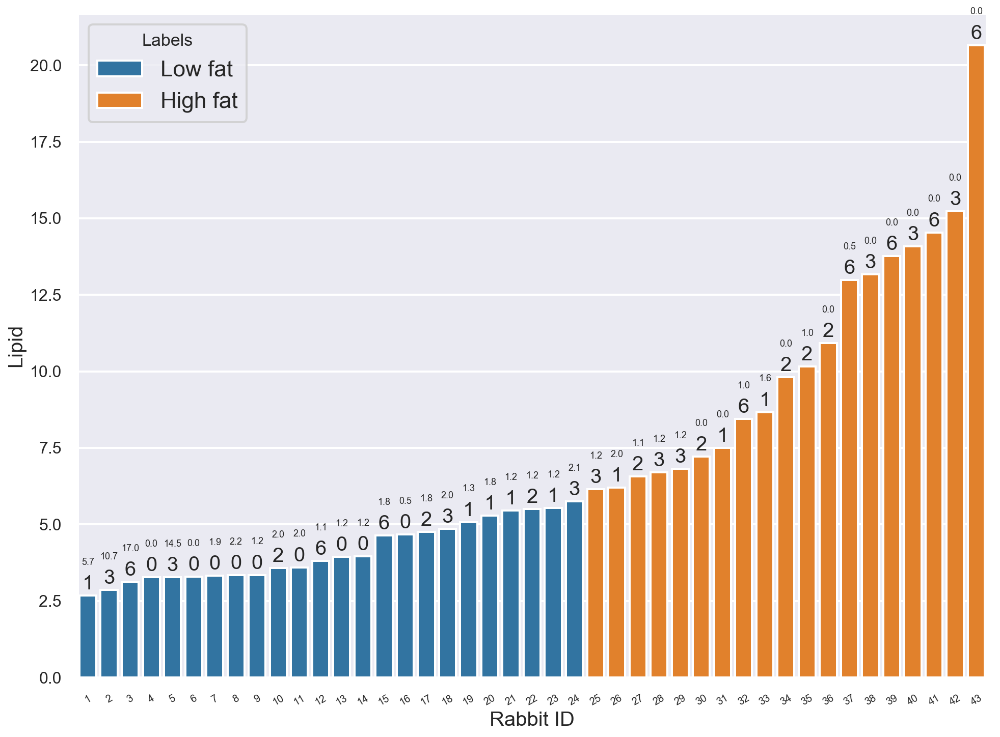

In [7]:
newdataBase = pd.read_excel('/Users/trongnguyen/Dropbox/FattyLiver/Rabbit_Liver_40.xlsx', sheet_name=0)
dataBase = newdataBase[['Rabbit', 'Injection level', 'Weeks on diet','Lipid', 'Timely death',\
                        'Injection amount', 'New_Hydro']]
dataBase = dataBase[dataBase['Timely death'] == 1]
dataBase = dataBase[dataBase['Injection level'] >=0]
dataBase = dataBase.dropna()

badRabbits = [748, 763, 787] # 
for bad_rabbit in badRabbits:
    dataBase = dataBase[dataBase.Rabbit != bad_rabbit]
    
threshold_lipid = 6
dataBase['High'] = dataBase.Lipid > threshold_lipid
dataBase = dataBase.sort_values(['Lipid'])
dataBase.index = range(1, len(dataBase)+1)
dataBase['Labels'] = dataBase['High'].apply(lambda x: 'High fat' if x else 'Low fat')

dataBase['Rabbit ID'] = np.arange(1,len(dataBase)+1)

plt.figure(figsize = (16, 12))
ax = sns.barplot(x = 'Rabbit ID', y = 'Lipid', data = dataBase, hue = 'Labels', \
            order=dataBase['Rabbit ID'], dodge = False)
for item in ax.get_xticklabels():
    item.set_rotation(30)
count = 1
for p in ax.patches:
    height = p.get_height()
    if np.isnan(height):
        continue
    no_weeks = dataBase['Weeks on diet'][count]
    injection_amount = dataBase['Injection amount'][count]
    count = count + 1
    plt.text(p.get_x()+p.get_width()/2.,
            height + 0.2,
            int(no_weeks),
            ha="center") 
    plt.text(p.get_x()+p.get_width()/2.,
            height + 1,
            np.round(injection_amount, 1),
            ha="center", fontsize = 9) 

# Divide the database by lipid and by injection amount

In [7]:
df_weeks = dataBase.groupby('Weeks on diet')

temp = (dataBase['Injection amount'] <=1.5) & dataBase['Injection amount'] >0
#temp  = dataBase['Injection amount'] ==0
temp1 = dataBase[temp].groupby('Weeks on diet')

In [ ]:
for name, group in temp1:
    print(group.to_string())
    lipid_group = group.Lipid
    print(np.mean(lipid_group), np.std(lipid_group))

## Load BSC and ATT

In [9]:
RIGHT_SIDE = ['754', '751', '729']

In [10]:
ATTs_dict, freq_att_dict, freq_bsc_dict, depth_dict, BSCs_dict = {}, {}, {}, {}, {} 
left_dict, right_dict, top_dict, bottom_dict = {}, {}, {}, {} # ROIs of each BSC
att_bottom, bad_BSC = {}, {}

#name_tag = 'fix_bug_average_ref_phantom_6MHz_v7_10a_30b'
#name_tag = 'fix_bug_average_ref_phantom_6MHz_v7_15a_30b'
#name_tag = 'fix_bug_average_ref_phantom_3_6MHz_v8_12a40_30b'
name_tag = 'fix_bug_average_ref_phantom_3_6MHz_v8_10a40_30b_v3'
for idx, row in dataBase.iterrows():
    number = str(int(row.Rabbit))
    print(number, end = ', ')
    if number in RIGHT_SIDE:
        path = "/Volumes/TrongDrive/Liver_Study/PostProcessedFiles/L" + number + "/L94_right/BSC_ATT/"
    else:
        path = "/Volumes/TrongDrive/Liver_Study/PostProcessedFiles/L" + number + "/L94_left/BSC_ATT/"
    ATTs_dict[number], freq_att_dict[number], BSCs_dict[number], freq_bsc_dict[number], \
    depth_dict[number], left_dict[number], right_dict[number], \
    top_dict[number], bottom_dict[number], att_bottom[number], bad_BSC[number] = getBSC_Att(path,name_tag)

732, 735, 738, 729, 737, 749, 770, 760, 759, 764, 780, 777, 769, 779, 778, 741, 774, 776, 761, 772, 781, 773, 771, 766, 785, 782, 783, 775, 765, 730, 739, 746, 747, 754, 745, 753, 743, 740, 731, 755, 757, 756, 758, 

In [31]:
rf_hdf5_path = '/Volumes/TrongDrive/Liver_Study/RF_hdf5/'
root_path = '/Volumes/TrongDrive/Liver_Study/PostProcessedFiles/L'

# Attenuation 

Initialization 

In [32]:
dataBase['att slope'] = 0
dataBase['att intercept'] = 0
dataBase['midband fit'] = 0
dataBase['bad Rabbit'] = False

In [33]:
for k, v in ATTs_dict.items():
    if (len(v) < 11):
        print(k, len(v), end = ',')
        dataBase.loc[dataBase.Rabbit == int(k), 'bad Rabbit'] = True

760 4,764 1,769 2,772 5,781 10,771 3,766 1,775 3,765 1,747 0,754 6,745 0,753 9,743 9,756 1,

In [13]:
dataBase.loc[dataBase.Rabbit == 751, 'bad Rabbit'] = True
#dataBase.loc[dataBase.Rabbit == 729, 'bad Rabbit'] = True

In [34]:
dataBase['High'] = dataBase.Lipid >= threshold_lipid

Plot and filter

Threshold lipid 6.000000


(0, 10)

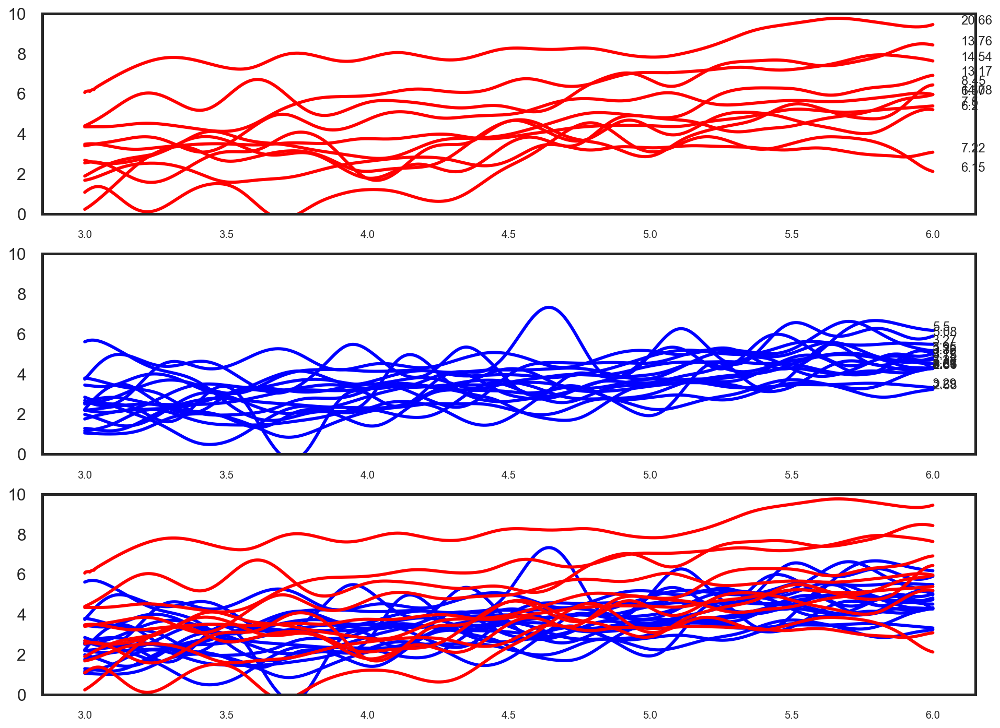

In [35]:
f, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (16, 12))
mean_att_red  = []
mean_att_blue = []
slope_intercept_att = np.zeros((15, 2))
print("Threshold lipid %f" % threshold_lipid )
for idx, row in dataBase.iterrows():
    lipid = row.Lipid
    rabbit_number = str(int(row.Rabbit))
    if row['bad Rabbit']:
        continue
    atts = ATTs_dict[rabbit_number]
    if (len(atts) == 0):
        dataBase.loc[dataBase.Rabbit == int(rabbit_number), 'bad Rabbit'] = True
        continue 
        print(rabbit_number)
    freq_key = next(iter(freq_att_dict[rabbit_number]))
    freq = freq_att_dict[rabbit_number][freq_key].flatten()
    
    rabbit_att = []
    for frame_ in atts:
        if (atts[frame_].shape[1] > 0):
            bottom_depth = att_bottom[rabbit_number][frame_].flatten()
            filter_att = []
            for idx in range(bottom_depth.shape[0]): # goes through all the ROIs
                if ((bottom_depth[idx] < 37) and (bottom_depth[idx] >5)):
                    single_att = atts[frame_][:,idx]
                    filter_att.append(single_att)
            if not filter_att:
                continue
            avg_att = np.mean(np.vstack(filter_att), axis = 0)
            rabbit_att.append(avg_att) #mean att in each frame

    #rabbit_att  = filter_ATT_curve(freq, np.vstack(rabbit_att))  
    if not rabbit_att:
        print(rabbit_number)
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'bad Rabbit'] = True
        continue
    rabbit_att  = np.mean(np.vstack(rabbit_att), axis = 0) #mean att for each rabbit
    idx = (freq >=4.0) & (freq <=5.0)
    if (lipid > threshold_lipid):
        ax1.plot(freq, rabbit_att, color = 'red') 
        ax3.plot(freq, rabbit_att, color = 'red') 
        
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att slope'] = slope
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att intercept'] = intercept
        dataBase.loc[dataBase.Rabbit == row.Rabbit, 'midband fit'] = rabbit_att[idx].mean()
        mean_att_red.append(rabbit_att)
        ax1.text(freq[-1] + 0.1, rabbit_att[-1], str(lipid), fontsize = 12)
    else:
        #continue
        ax2.plot(freq, rabbit_att, color = 'blue')
        ax3.plot(freq, rabbit_att, color = 'blue') 
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att slope'] = slope
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att intercept'] = intercept
        dataBase.loc[dataBase.Rabbit == row.Rabbit, 'midband fit'] = rabbit_att[idx].mean()
        mean_att_blue.append(rabbit_att)
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
        ax2.text(freq[-1] , rabbit_att[-1], str(lipid), fontsize = 12)

ax1.set_ylim([0, 10])
ax2.set_ylim([0, 10])
ax3.set_ylim([0, 10])
#plt.xlabel('Frequency (MHz)')
#plt.ylabel('dB/cm')
#plt.title('Attenuation for all of the rabbits')

In [36]:
dataBase_filter = dataBase[dataBase['bad Rabbit'] == False]

# Plot att vs hydroxyproline

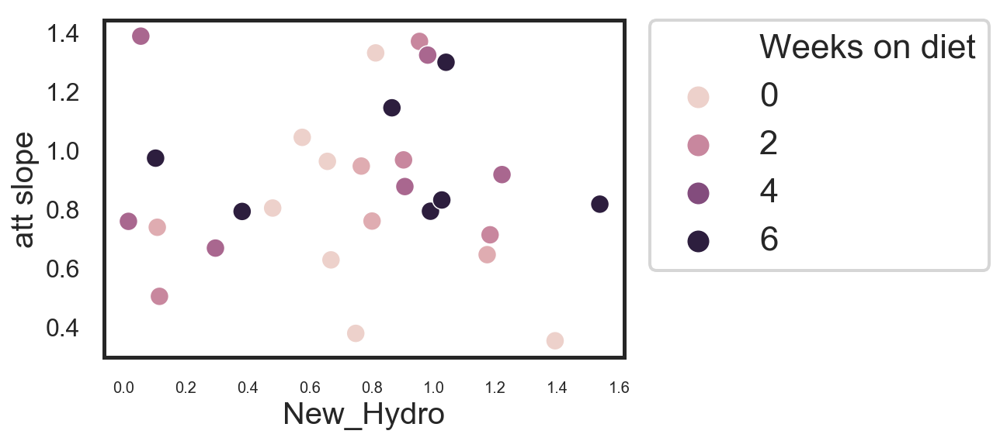

In [59]:
sns.scatterplot(x = 'New_Hydro', y = 'att slope', hue = 'Weeks on diet', data = dataBase_filter)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

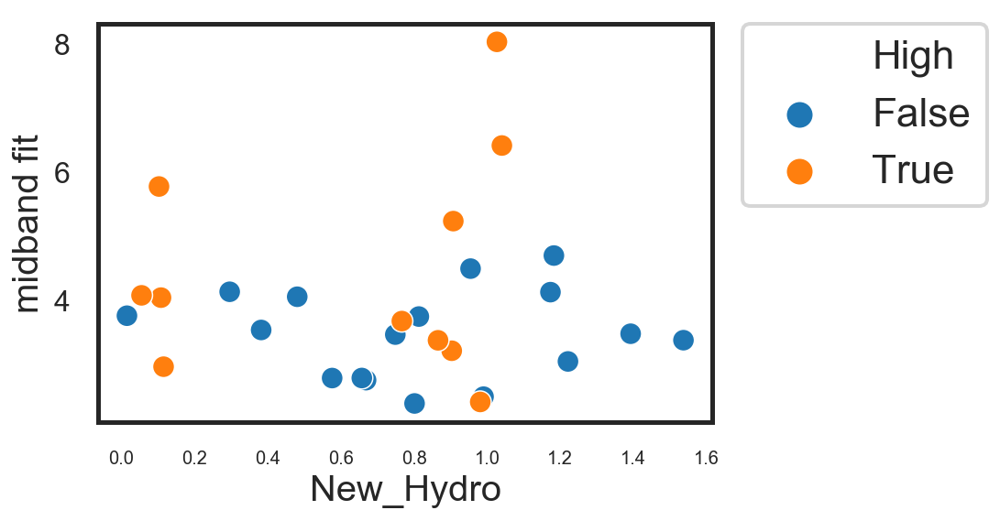

In [56]:
sns.scatterplot(x = 'New_Hydro', y = 'midband fit',hue = 'High', data = dataBase_filter)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [37]:
att_mbf = dataBase_filter['midband fit'].as_matrix()
att_slope = dataBase_filter['att slope'].as_matrix()

In [38]:
att_label = dataBase_filter['High'].as_matrix().astype(int)

In [39]:
X_att = np.vstack((att_mbf, att_slope)).T

In [45]:
clf = svm.SVC(kernel = 'linear') # 
#clf = svm.SVC(kernel = 'linear', class_weight={1: 3})

In [46]:
clf.fit(X_att, att_label)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='linear',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [42]:
from mlxtend.plotting import plot_decision_regions

In [43]:
sns.set_style('white')

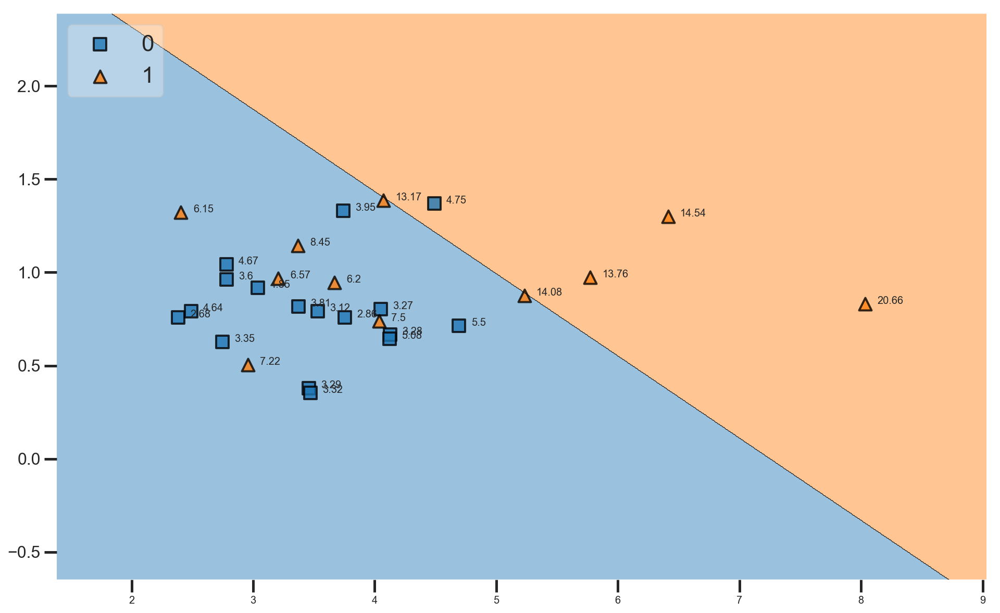

In [47]:
fig, ax = plt.subplots(1, 1, figsize = (16, 10))
plot_decision_regions(X_att, att_label, clf=clf, legend=2)
#ax = sns.scatterplot(x = 'midband fit', y = 'att slope', data = dataBase_filter, hue = 'Labels')
for idx, row in dataBase_filter.iterrows():
    temp1 = dataBase_filter['Rabbit'][idx]
    temp2 = dataBase_filter['Lipid'][idx]
    temp3 = str(temp1)+ ':' + str(temp2)
    ax.text(dataBase_filter['midband fit'][idx]+ 0.1, dataBase_filter['att slope'][idx],\
            (temp2), fontsize = 10)
#plt.legend(loc='lower right')

In [ ]:
plt.figure(figsize = (10, 8))
g = sns.barplot(x = 'Lipid', y = 'att slope', data = dataBase_filter, \
                dodge = False, color = 'cornflowerblue')
#g.set_xticklabels(g.get_xticklabels(), rotation=45)
plt.xticks(rotation=40)

In [ ]:
plt.figure(figsize = (10, 8))
sns.barplot(x = 'Lipid', y = 'midband fit', data = dataBase_filter, dodge = False, color = 'cornflowerblue')

In [58]:
ttest_ind(dataBase_filter['att slope'][dataBase_filter.High == False],dataBase_filter['att slope'][dataBase_filter.High == True])

Ttest_indResult(statistic=-3.1720305876391226, pvalue=0.0025874237903952863)

In [59]:
ttest_ind(dataBase_filter['att intercept'][dataBase_filter.High == False],dataBase_filter['att intercept'][dataBase_filter.High == True])

Ttest_indResult(statistic=0.9060082181825961, pvalue=0.369276969547667)

In [60]:
ttest_ind(dataBase_filter['midband fit'][dataBase_filter.High == False],dataBase_filter['midband fit'][dataBase_filter.High == True])

Ttest_indResult(statistic=-2.4992615681644055, pvalue=0.015774069016951536)

In [61]:
dataBase_filter['att slope'].groupby(dataBase_filter['High']).describe()

,count,mean,std,min,25%,50%,75%,max
High,,,,,,,,
False,31.0,0.710097,0.340053,-0.035347,0.580413,0.712492,0.927832,1.369186
True,21.0,0.994848,0.280646,0.503588,0.830714,0.966834,1.143695,1.717909


In [62]:
dataBase_filter['midband fit'].groupby(dataBase_filter['High']).describe()

,count,mean,std,min,25%,50%,75%,max
High,,,,,,,,
False,31.0,3.690646,1.026446,1.987537,3.065088,3.489344,4.149701,6.849025
True,21.0,4.603417,1.610665,2.406725,3.380661,4.036501,5.772623,8.032260


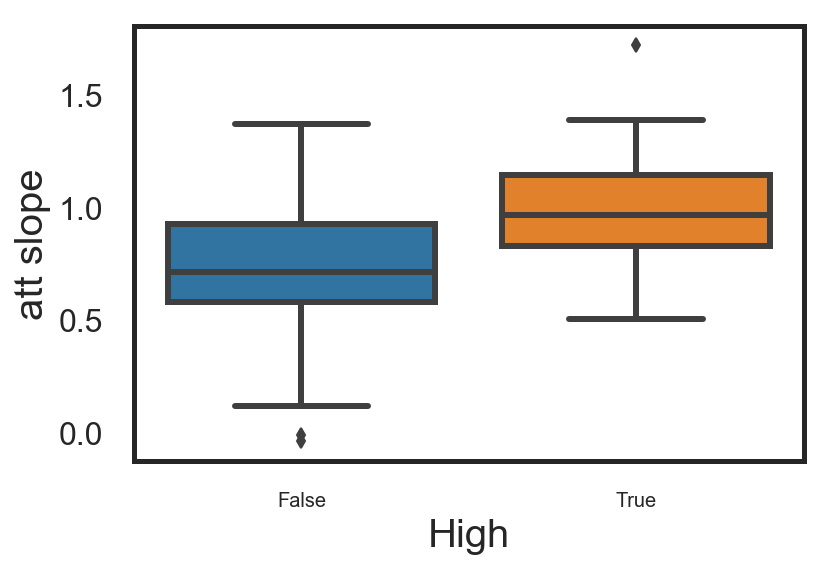

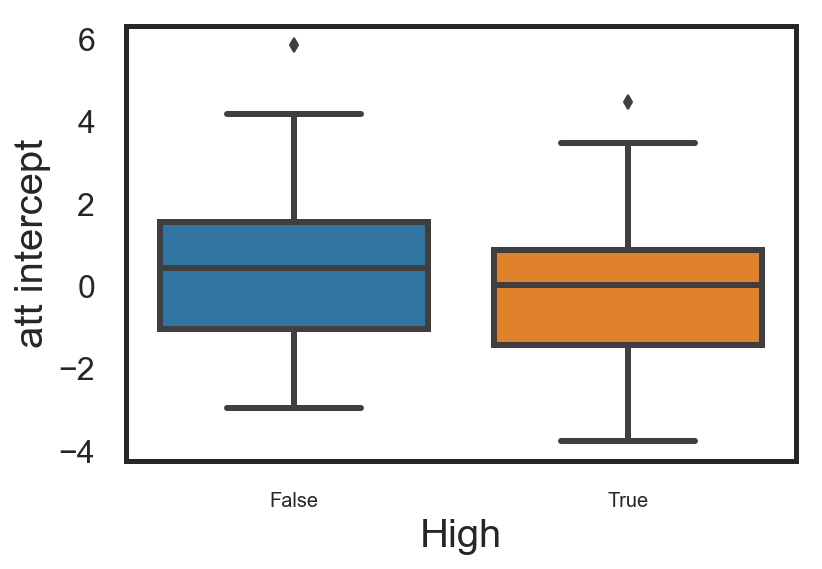

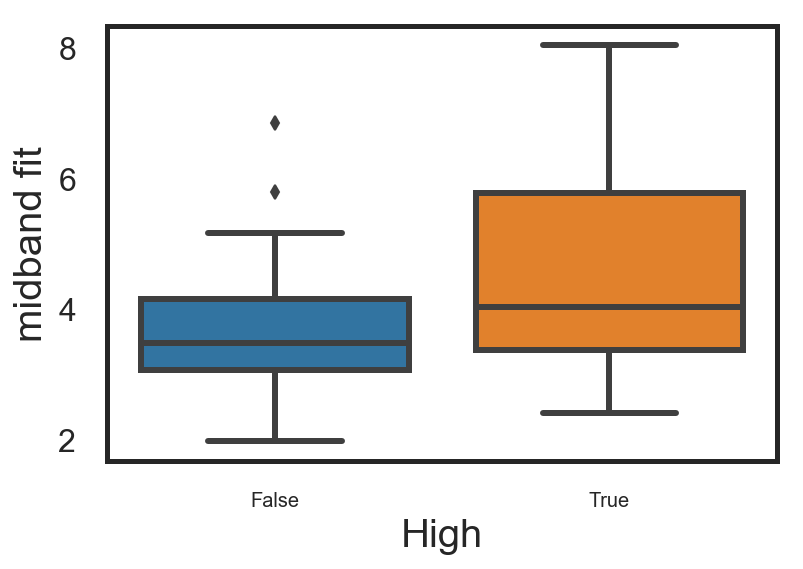

In [63]:
sns.boxplot(x = 'High', y = 'att slope', data = dataBase_filter)
plt.figure()
sns.boxplot(x = 'High', y = 'att intercept', data = dataBase_filter)
plt.figure()
sns.boxplot(x = 'High', y = 'midband fit', data = dataBase_filter)

## Attenuation for two classes

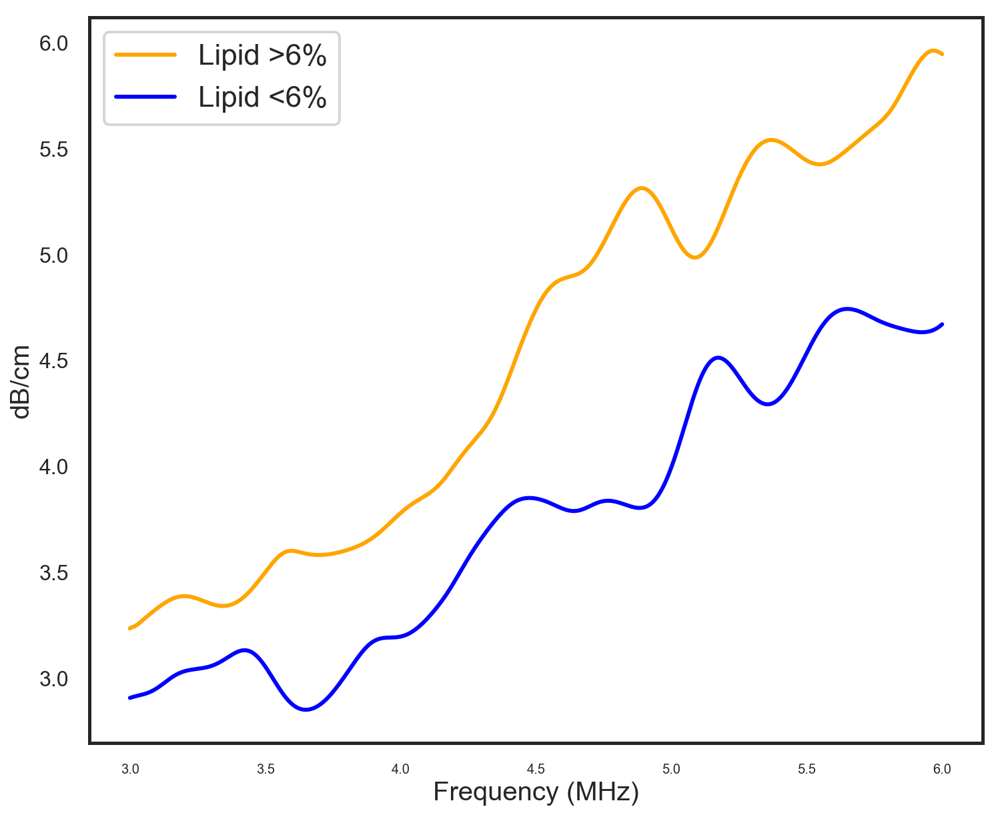

In [64]:
plt.figure(figsize = (12, 10))
high_fat_att = np.mean(np.vstack(mean_att_red), axis =0)
low_fat_att = np.mean(np.vstack(mean_att_blue), axis =0)
plt.plot(freq, high_fat_att, color = 'orange', label = 'Lipid >' + str(threshold_lipid)+ '%')
plt.plot(freq, low_fat_att, color = 'blue', label = 'Lipid <' + str(threshold_lipid)+ '%')
plt.xlabel('Frequency (MHz)')
plt.ylabel('dB/cm')
plt.legend()

In [95]:
slope1, intercept1 = np.polyfit(freq, high_fat_att, 1)

print(slope1, intercept1)
print(slope1 * 4.25 + intercept1)

slope2, intercept2 = np.polyfit(freq, low_fat_att, 1)

print(slope2, intercept2)
print(slope2 * 4.25 + intercept2)

1.093058841396079 0.5661055635243192
5.211605639457654
0.8031803433611159 0.09356054893474376
3.5070770082194866


# BSC analysis

## Average BSC for all rabbits

101.20437111811125 39.384102746052875 2.63 734
120.65015159001861 24.63838402685095 2.68 732
118.44530680995553 33.5460244218398 2.86 735
113.7462292889873 33.85695331217086 3.12 738
135.38491355768826 31.455177718491903 3.27 729
135.58271481359148 33.59207806713891 3.28 737
161.334661023944 23.159195207564693 3.29 749
172.23631559854283 29.521902897700976 3.31 736
165.90706727237077 30.129136895786445 3.32 770
115.02364065455356 36.53571066471695 3.34 760
142.41124249103058 28.502484824342147 3.35 759
185.27366127415357 27.86399219363941 3.57 764
99.38403960155323 33.28817351907055 3.6 780
137.57769278748566 25.79312272067455 3.81 777
139.29349921205977 29.382440630470835 3.82 767
205.04789455275798 25.358422907282883 3.94 769
8.145957142678533 104.56832848587077 3.95 779
188.7184173181063 12.68328161247225 4.1 750
152.09232402400997 29.53777822111199 4.23 762
130.83101431531915 26.580634499442507 4.51 768
135.93835696095095 30.414061321585173 4.64 778
84.81568693423253 32.71990402398

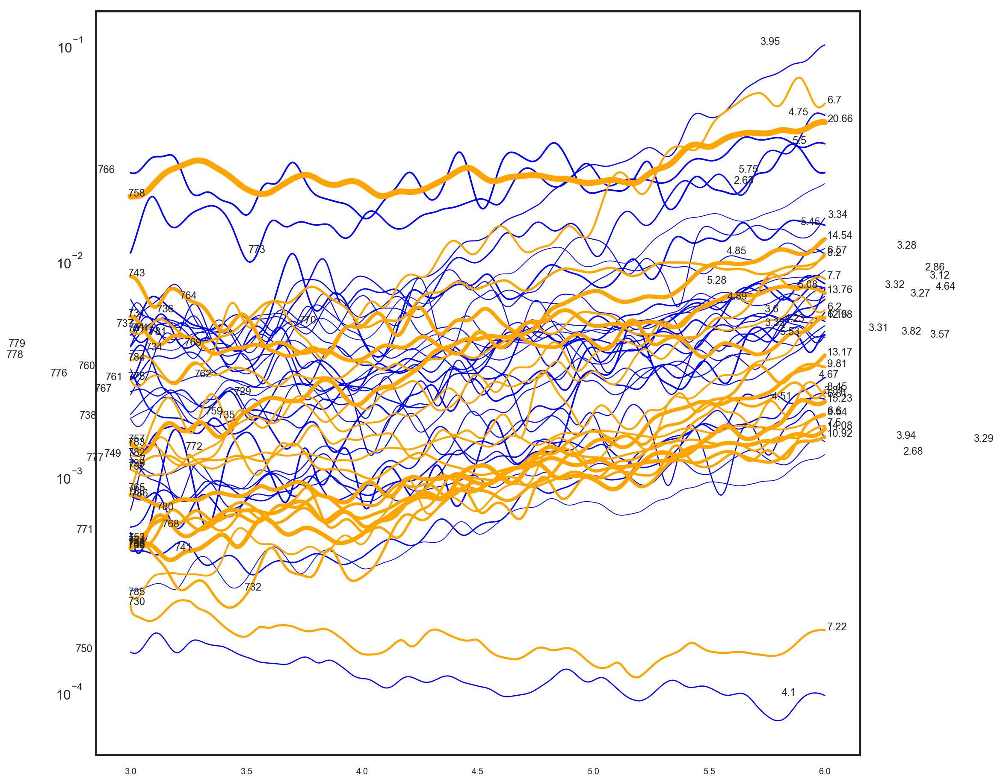

In [65]:
mean_red  = []
mean_blue = []

plt.figure(figsize = (16, 16))
for idx, row in dataBase_filter.iterrows():
    lipid = row.Lipid
    rabbit_number = str(int(row.Rabbit))
    bscs = BSCs_dict[rabbit_number]
    if (len(bscs) == 0):
        print(rabbit_number)
        continue
    freq_key = next(iter(freq_bsc_dict[rabbit_number]))
    freq = freq_bsc_dict[rabbit_number][freq_key].flatten()
    
    rabbit_bsc = []
    for frame_ in bscs:
        if (bscs[frame_].shape[1] > 0):
            bsc_filter, good_idxs = filter_bsc(bscs[frame_])
            if (len(bsc_filter)>0):
                avg_bsc = np.mean(bsc_filter, axis = 1)
                rabbit_bsc.append(avg_bsc)

    if (len(rabbit_bsc) ==0):
        continue
    rabbit_bsc  = np.mean(np.vstack(rabbit_bsc), axis = 0)
    if (np.isnan(rabbit_bsc).any()):                
        bsc_nan = rabbit_bsc
        print(bsc_nan)
        print(rabbit_number)
    if (lipid > threshold_lipid):
        plt.semilogy(freq, rabbit_bsc, color = 'orange', linewidth = lipid /3.0) 
       
        if (not np.isnan(rabbit_bsc).any()):
            mean_red.append(rabbit_bsc)
            try:
                esd, eac = get_ESD_EAC(freq, np.mean(np.vstack(rabbit_bsc), axis=1))
            except:
                esd = 0
                eac = 0
            print(esd, eac, lipid, rabbit_number)
            plt.text(freq[-1] + 0.01 , rabbit_bsc[-1], str(lipid), fontsize = 12)
            plt.text(freq[0] - 0.01 , rabbit_bsc[0], rabbit_number, fontsize = 12)
    else:
        plt.semilogy(freq, rabbit_bsc, color = 'blue', linewidth = lipid /3.0)
        if (not np.isnan(rabbit_bsc).any()):
            mean_blue.append(rabbit_bsc)
            try:
                esd, eac = get_ESD_EAC(freq, np.mean(np.vstack(rabbit_bsc), axis=1))
            except:
                esd = 0
                eac = 0
            print(esd, eac, lipid, rabbit_number)
            plt.text(freq[-1] + np.random.normal(scale = 0.3), rabbit_bsc[-1], str(lipid), fontsize = 12)
            plt.text(freq[0] + np.random.normal(scale = 0.3) , rabbit_bsc[0], rabbit_number, fontsize = 12)
    #plt.ylim([10**-5, 10**-1])
    #plt.show()

# PLOT BSC by GROUP

In [69]:
group

,Rabbit,Injection level,Weeks on diet,Lipid,Timely death,Injection amount,High,Labels,Rabbit ID
53,731,0,6,13.76,1,0.0,True,High fat,53
55,757,0,6,14.54,1,0.0,True,High fat,55
57,758,0,6,20.66,1,0.0,True,High fat,57


In [72]:
for name, group in temp1:
    print(name)
    for idx, row in group.iterrows():
        print(row.Lipid, row.Rabbit)

0
3.27 729
3.29 749
4.1 750
1
6.6 752
7.5 739
8.2 751
2
7.22 730
9.81 754
10.92 753
3
13.17 740
14.08 755
15.23 756
6
13.76 731
14.54 757
20.66 758


3.35
3.94
3.95
4.67
5.08
5.45
5.53
5.5
6.57
10.16
6.15
6.7
6.81
3.81
3.82
8.45
12.98


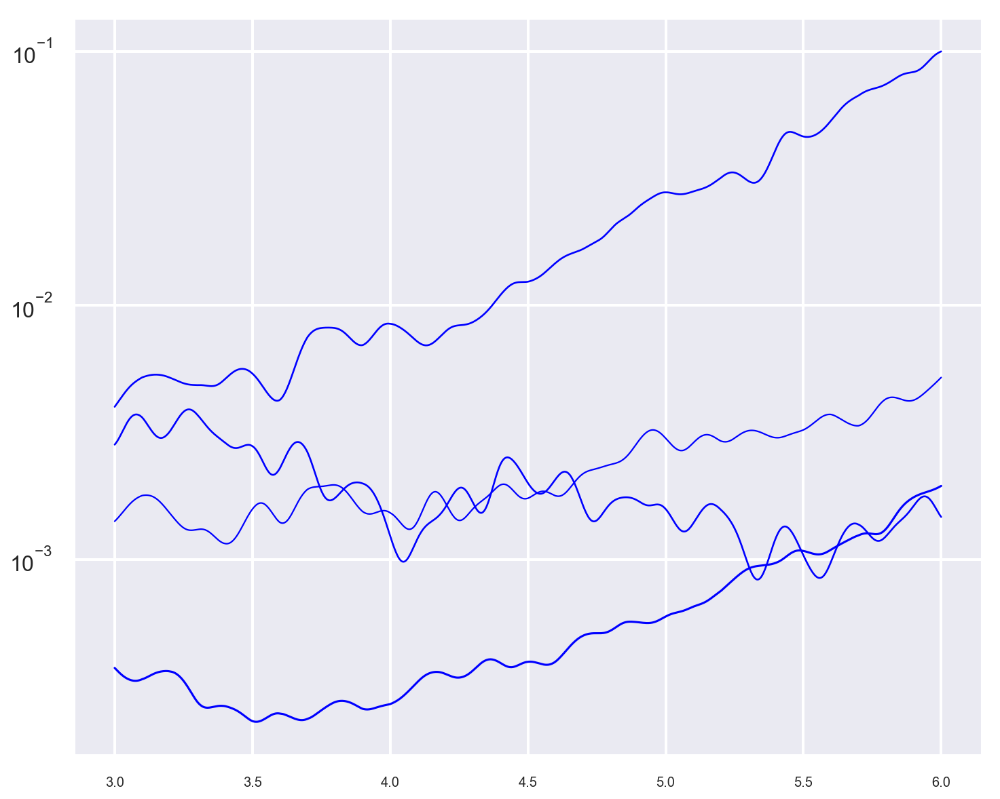

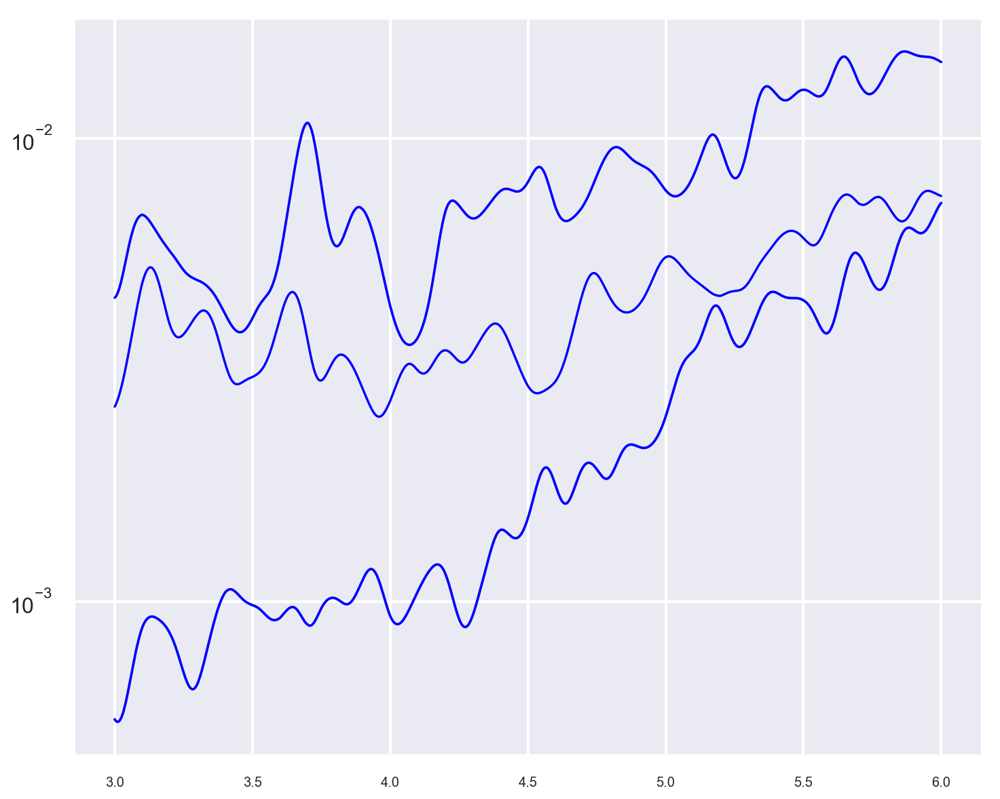

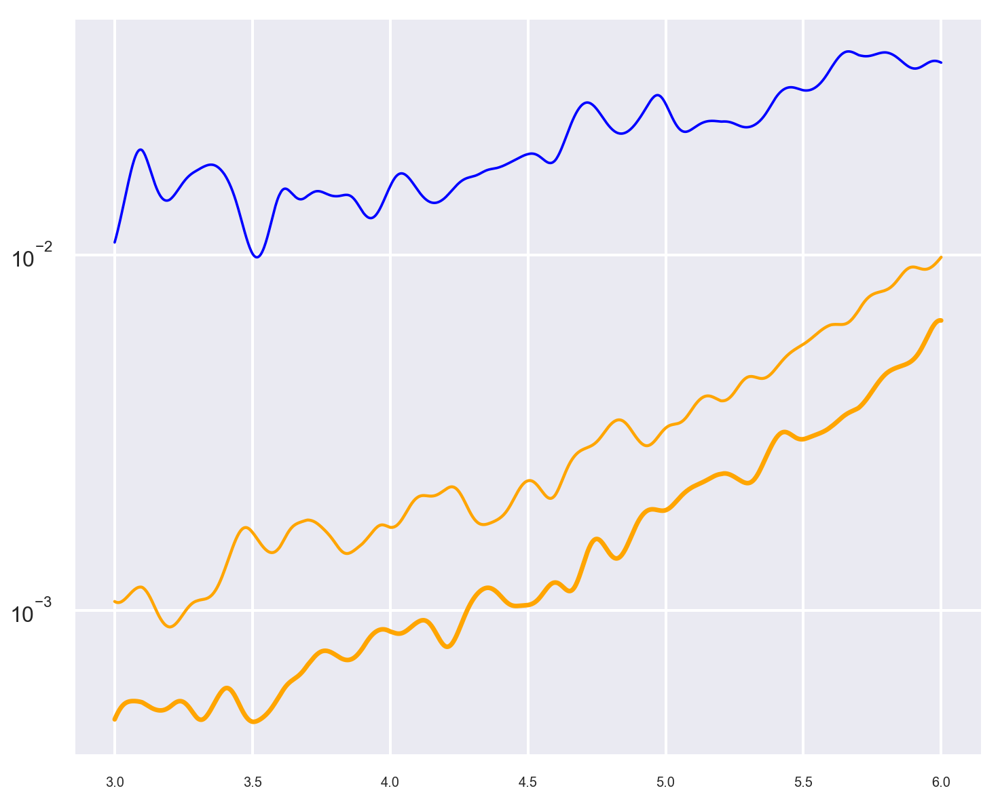

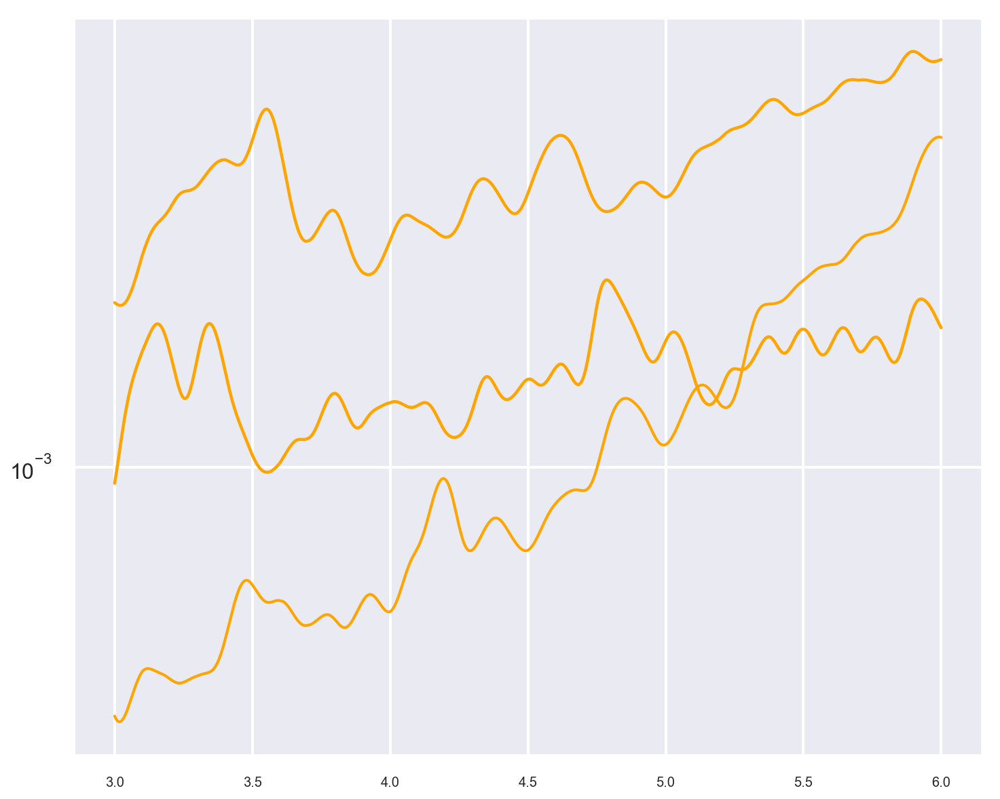

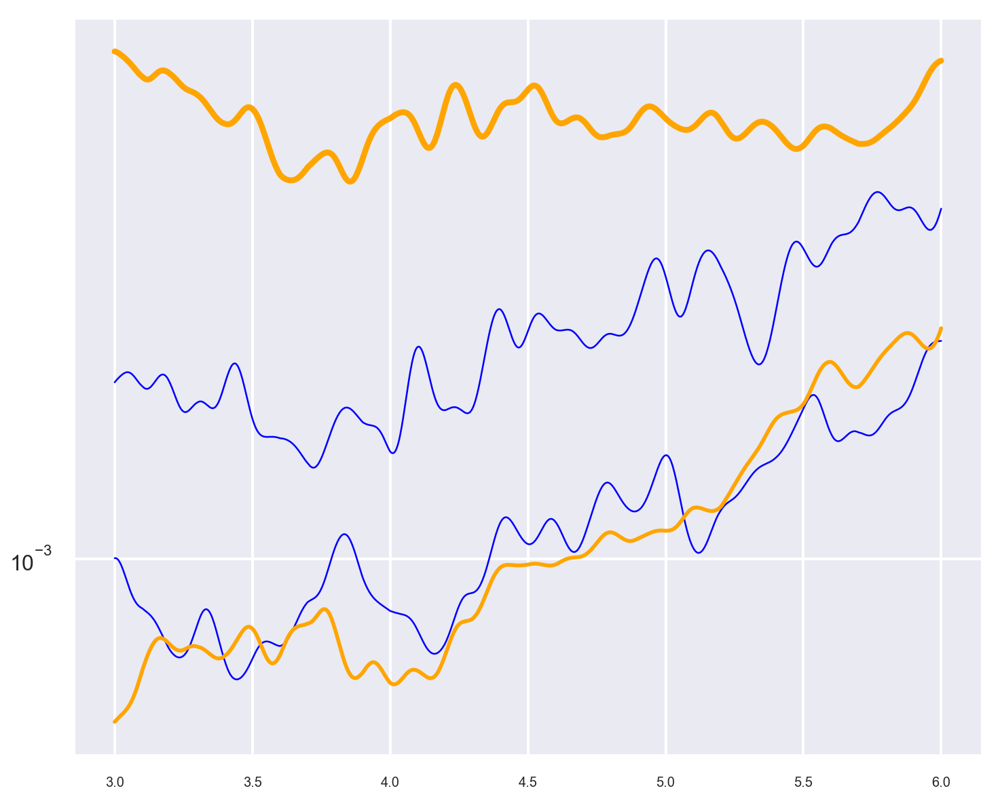

In [73]:
df_weeks = dataBase.groupby('Weeks on diet')

temp = (dataBase['Injection amount'] <=1.5) & dataBase['Injection amount'] >0
#temp  = dataBase['Injection amount'] ==0
temp1 = dataBase[temp].groupby('Weeks on diet')
for name, group in temp1:
    plt.figure(figsize = (12, 10))
    for idx, row in group.iterrows():
        print(row.Lipid)


        lipid = row.Lipid
        rabbit_number = str(int(row.Rabbit))
        bscs = BSCs_dict[rabbit_number]
        if (len(bscs) == 0):
            print(rabbit_number)
            continue
        freq_key = next(iter(freq_bsc_dict[rabbit_number]))
        freq = freq_bsc_dict[rabbit_number][freq_key].flatten()

        rabbit_bsc = []
        for frame_ in bscs:
            if (bscs[frame_].shape[1] > 0):
                bsc_filter, good_idxs = filter_bsc(bscs[frame_])
                if (len(bsc_filter)>0):
                    avg_bsc = np.mean(bsc_filter, axis = 1)
                    rabbit_bsc.append(avg_bsc)

        if (len(rabbit_bsc) ==0):
            continue
        rabbit_bsc  = np.mean(np.vstack(rabbit_bsc), axis = 0)
        if (np.isnan(rabbit_bsc).any()):                
            bsc_nan = rabbit_bsc
            print(bsc_nan)
            print(rabbit_number)
        if (lipid > threshold_lipid):
            plt.semilogy(freq, rabbit_bsc, color = 'orange', linewidth = lipid /3.0) 
        else:
            plt.semilogy(freq, rabbit_bsc, color = 'blue', linewidth = lipid /3.0)
          
     

## Average BSC for two lipid classes

124.34247159706042 32.64782853727827
125.99044393825044 33.730979215458156


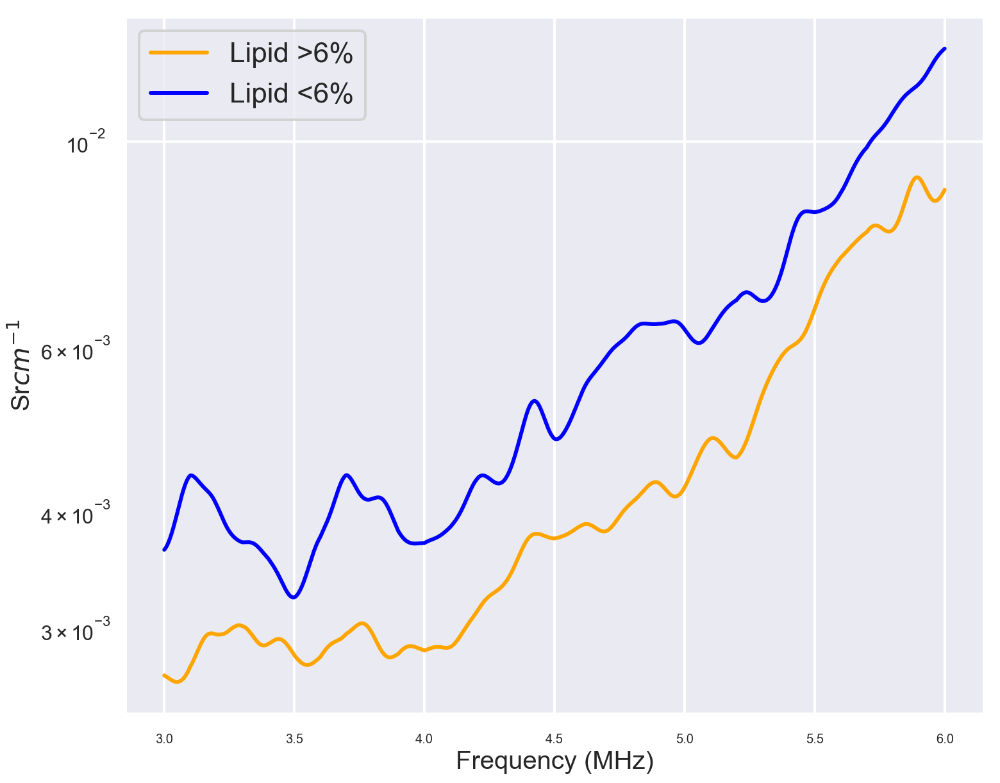

In [29]:
plt.figure(figsize = (12, 10))
bsc_low_lipid = np.mean(np.vstack(mean_blue), axis = 0)
bsc_high_lipid = np.mean(np.vstack(mean_red), axis = 0)
plt.semilogy(freq, bsc_high_lipid, color='orange', \
             label = 'Lipid >' + str(threshold_lipid)+ '%')

esd, eac = get_ESD_EAC(freq, bsc_high_lipid, type = 'gaussian')
print(esd, eac)

plt.semilogy(freq, bsc_low_lipid, color='blue',  \
             label = 'Lipid <' + str(threshold_lipid)+ '%')

esd, eac = get_ESD_EAC(freq, bsc_low_lipid, type = 'gaussian')
print(esd, eac)
plt.xlabel('Frequency (MHz)')
plt.ylabel('Sr$cm^{-1}$')
plt.legend()
#plt.ylim([10**-4, 10**-2])

In [163]:
from scipy.io import savemat

bsc_python = {}
bsc_python['freq'] = freq
bsc_python['bsc'] = np.mean(np.vstack(mean_blue), axis = 0)

In [164]:
savemat('bsc_python_blue.mat', bsc_python)

## Average BSC for two classes

/Users/trongnguyen/anaconda3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


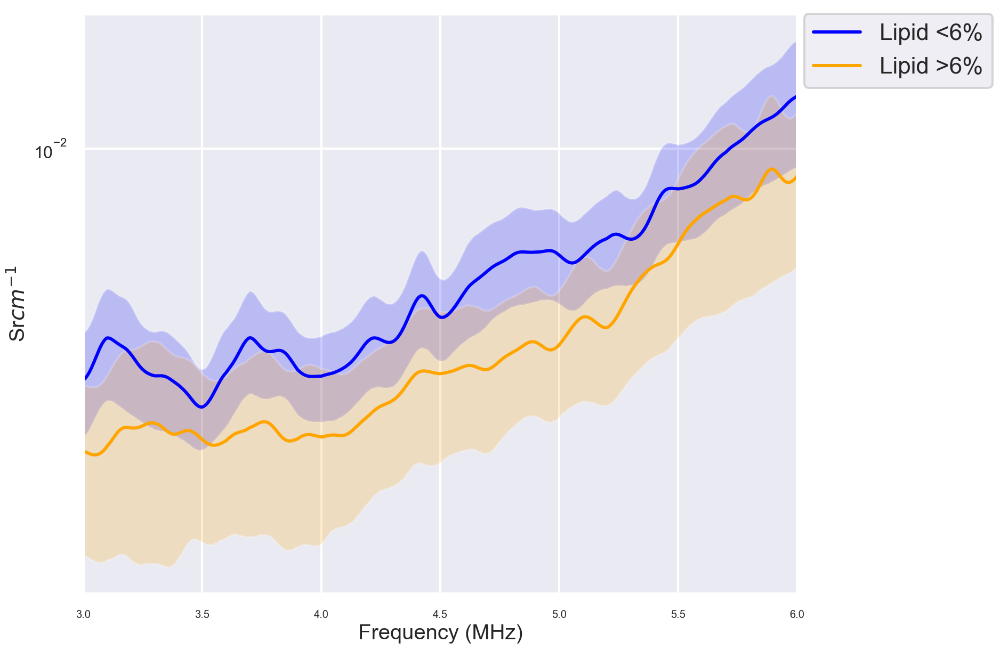

In [30]:
f, ax = plt.subplots(figsize=(12, 10))
ax.set(yscale="log")
sns.tsplot(data = np.vstack(mean_blue), time = freq,  color = 'blue', condition = 'Lipid <' + str(threshold_lipid)+ '%')
sns.tsplot(data = np.vstack(mean_red),time = freq,  color = 'orange', condition = 'Lipid >' + str(threshold_lipid)+ '%')
ax.set_xlabel('Frequency (MHz)')
ax.set_ylabel('Sr$cm^{-1}$')
#ax.set_ylim([ 10**-4,10**-2])
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)

In [33]:
df = pd.DataFrame({'ESD':pd.Series(esd_dict),'EAC':pd.Series(eac_dict)})
df['Lipid'] = df.index
df['High'] = df.Lipid > threshold_lipid
df['High_fat'] = df['High'].apply(lambda x: 'High fat' if x else 'Low fat')

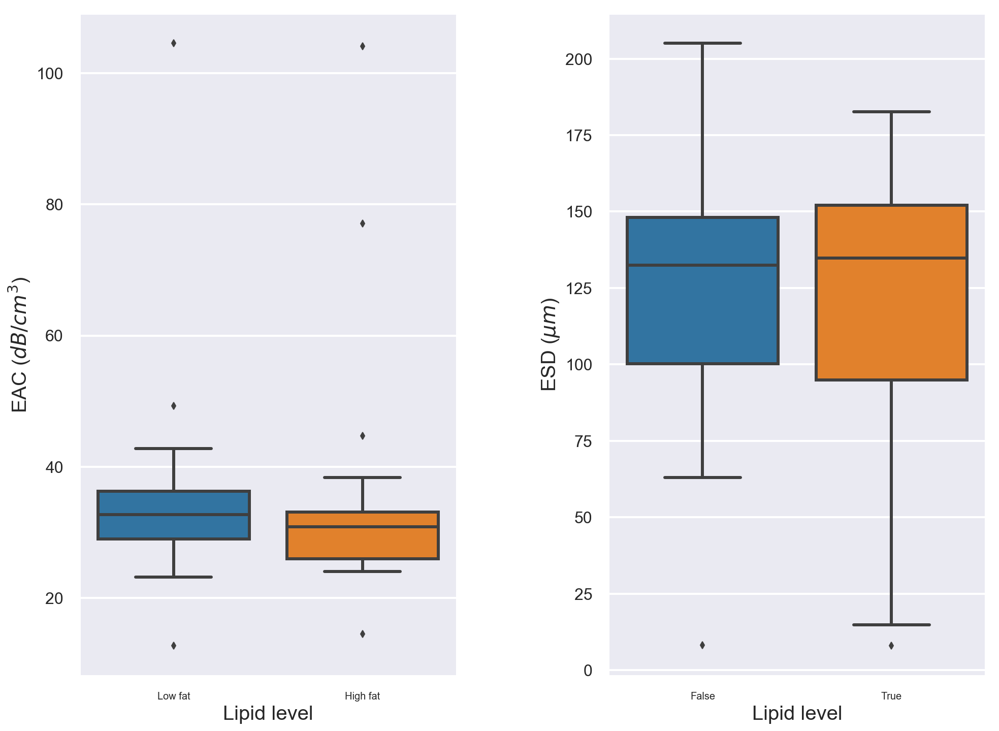

In [34]:
plt.figure(figsize = (16, 12))
plt.subplot(121)
sns.boxplot(x = 'High_fat', y = 'EAC', data = df)
plt.ylabel('EAC ($dB/cm^3$)')
plt.xlabel('Lipid level')
plt.subplot(122)
sns.boxplot(x = 'High', y = 'ESD', data = df)
plt.ylabel('ESD ($\mu m$)')
plt.xlabel('Lipid level')
plt.subplots_adjust(wspace = 0.4)

In [35]:
ttest_ind(df.EAC[df.High == False], df.EAC[df.High == True])

Ttest_indResult(statistic=-0.27783435862984446, pvalue=0.7822851568956073)

In [36]:
ttest_ind(df.ESD[df.High == False], df.ESD[df.High == True])

Ttest_indResult(statistic=0.6810791869265119, pvalue=0.4989636889270027)

In [37]:
df['EAC'].groupby(df['High']).describe()

,count,mean,std,min,25%,50%,75%,max
High,,,,,,,,
False,31.0,34.285326,14.602656,12.683282,28.942463,32.719904,36.235378,104.568328
True,21.0,35.609279,19.769952,14.499824,25.963966,30.863514,33.082521,104.140689


In [38]:
df['ESD'].groupby(df['High']).describe()

,count,mean,std,min,25%,50%,75%,max
High,,,,,,,,
False,31.0,126.867765,40.720542,8.145957,100.294205,132.461372,148.073066,205.047895
True,21.0,118.513444,47.137359,7.938076,94.858610,134.747674,152.050931,182.675513


In [39]:
df['Labels'] = df['High'].apply(lambda x: 'High fat' if x else 'Low fat')

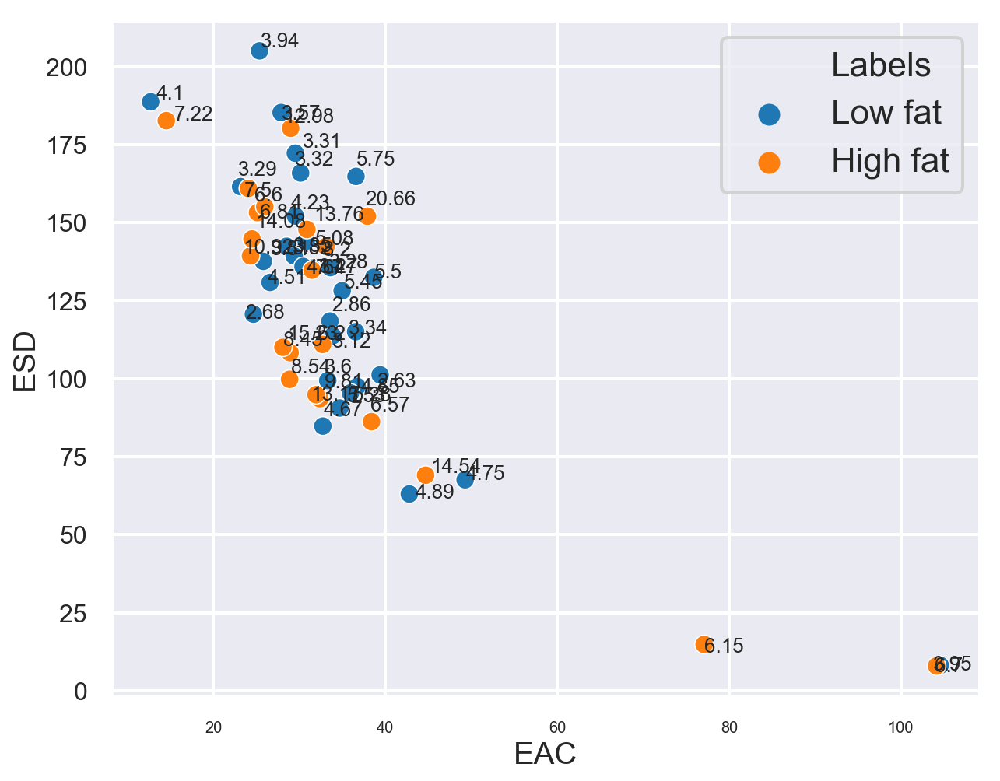

In [40]:
plt.figure(figsize = (10, 8))
ax = sns.scatterplot(x = 'EAC', y = 'ESD', data = df, hue = 'Labels')

for idx, row in df.iterrows():
    pos1 = (np.random.rand(1)- 0.5)*2
    pos2 = (np.random.rand(1)-0.5)*8
    ax.text(df['EAC'][idx]+pos1, df['ESD'][idx]+pos2,\
            df['Lipid'][idx], fontsize = 13)
#plt.legend(loc='lower right')

# BSCs for each rabbits

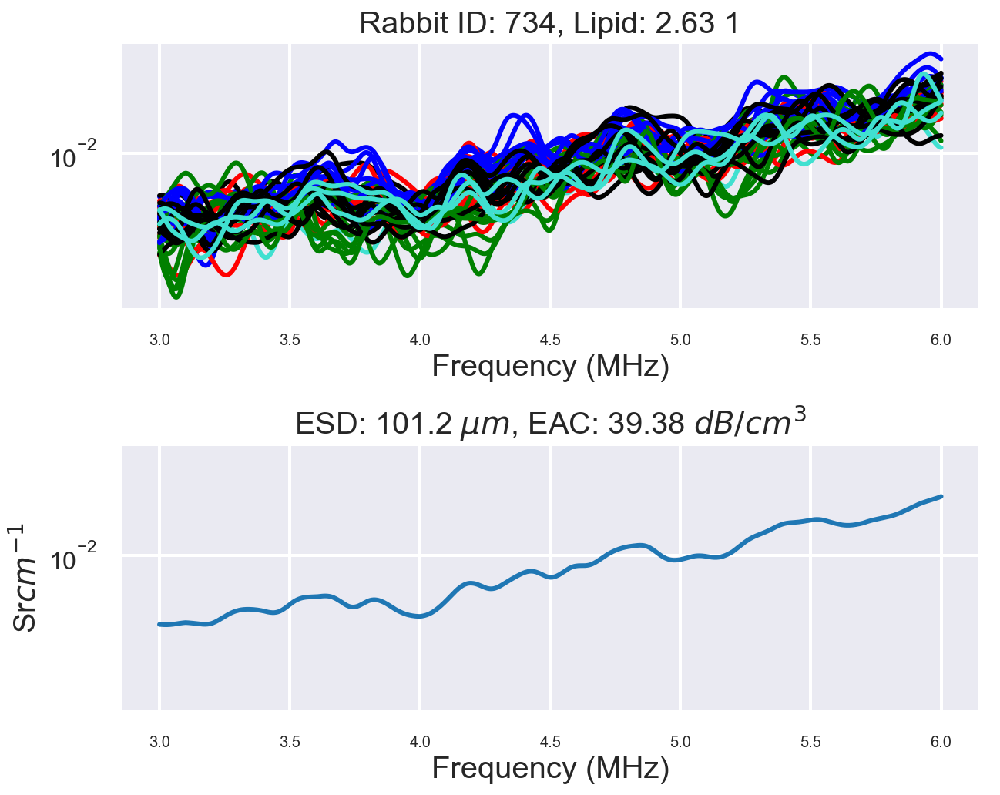

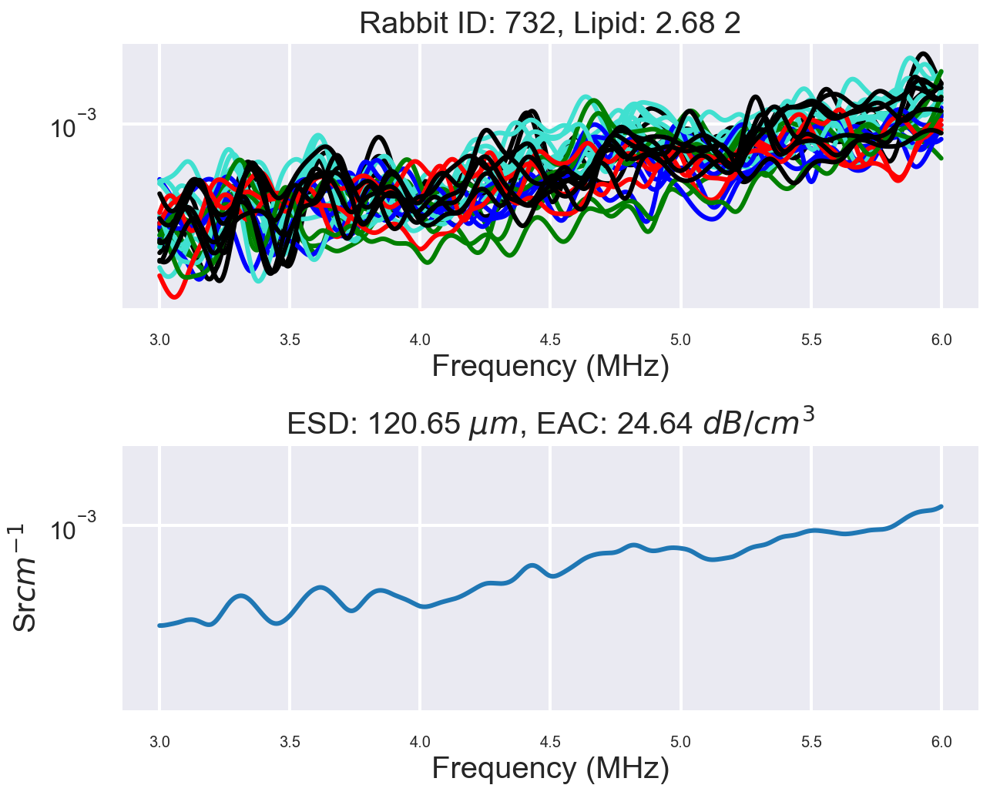

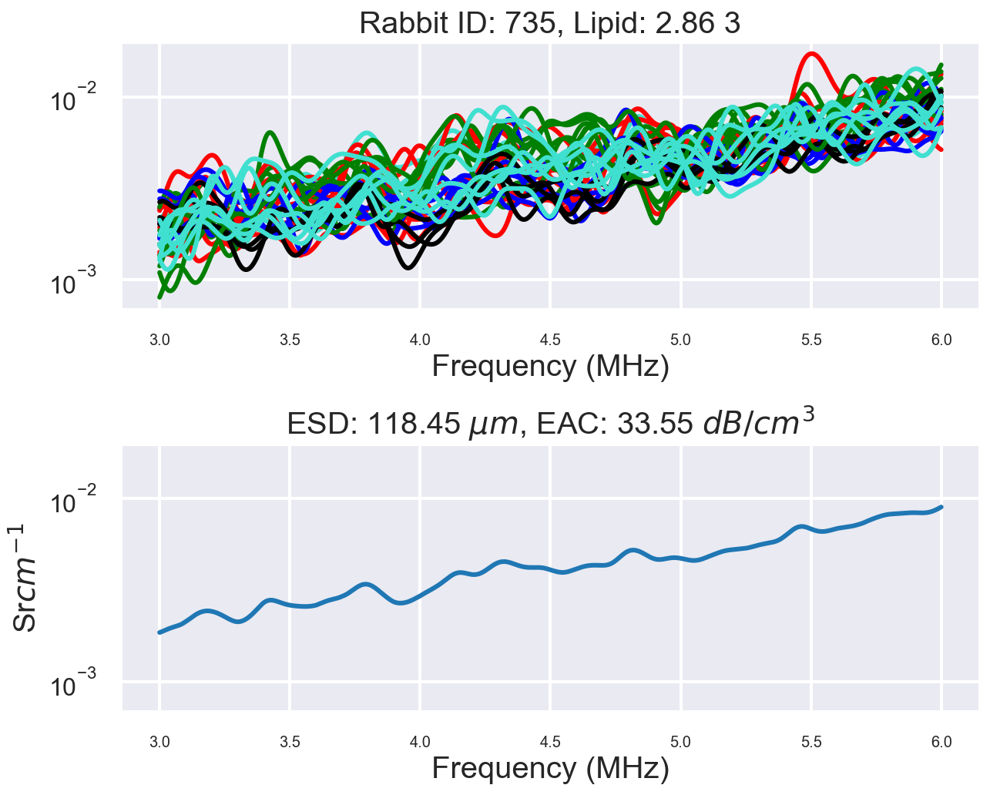

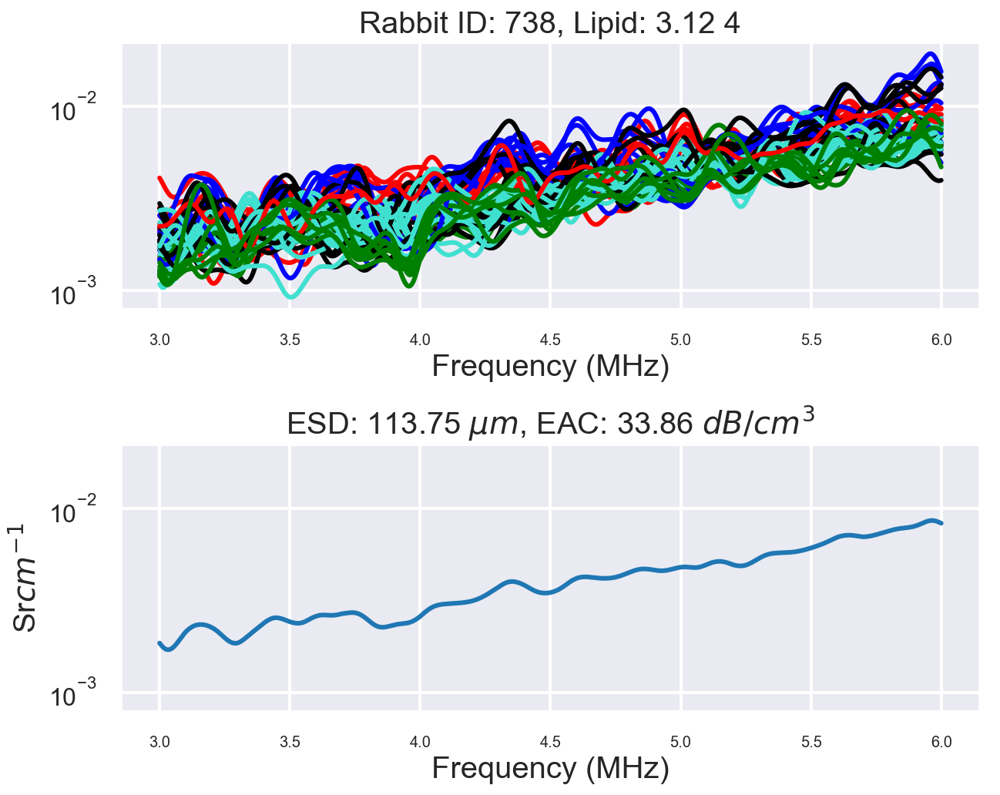

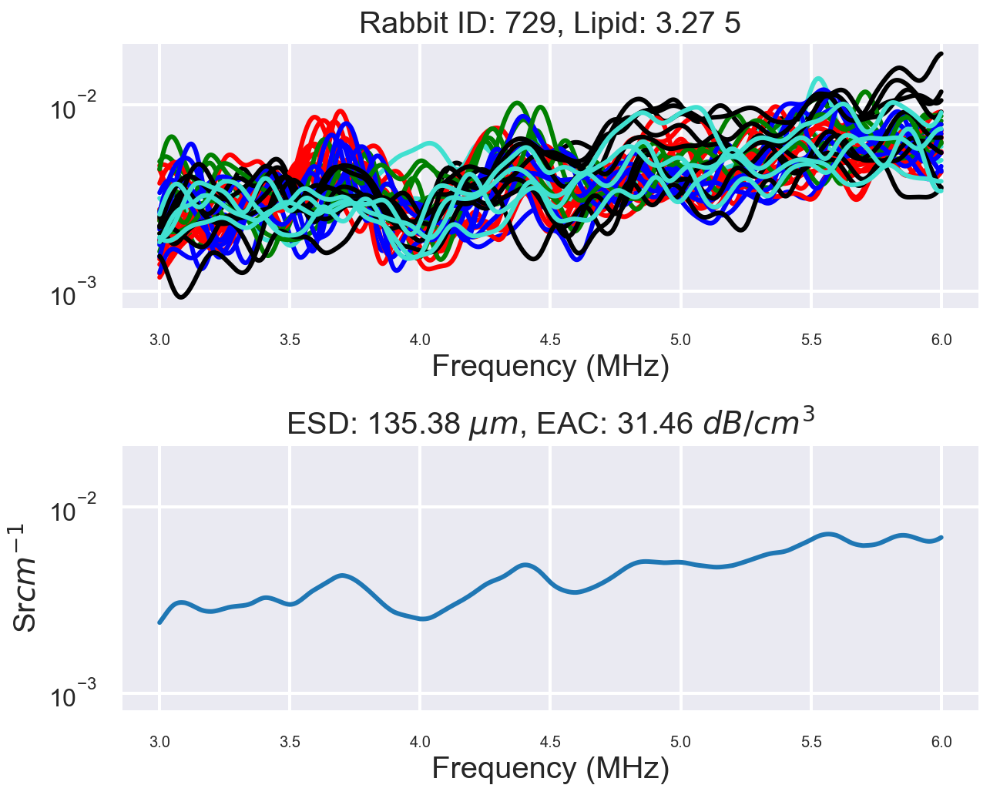

...

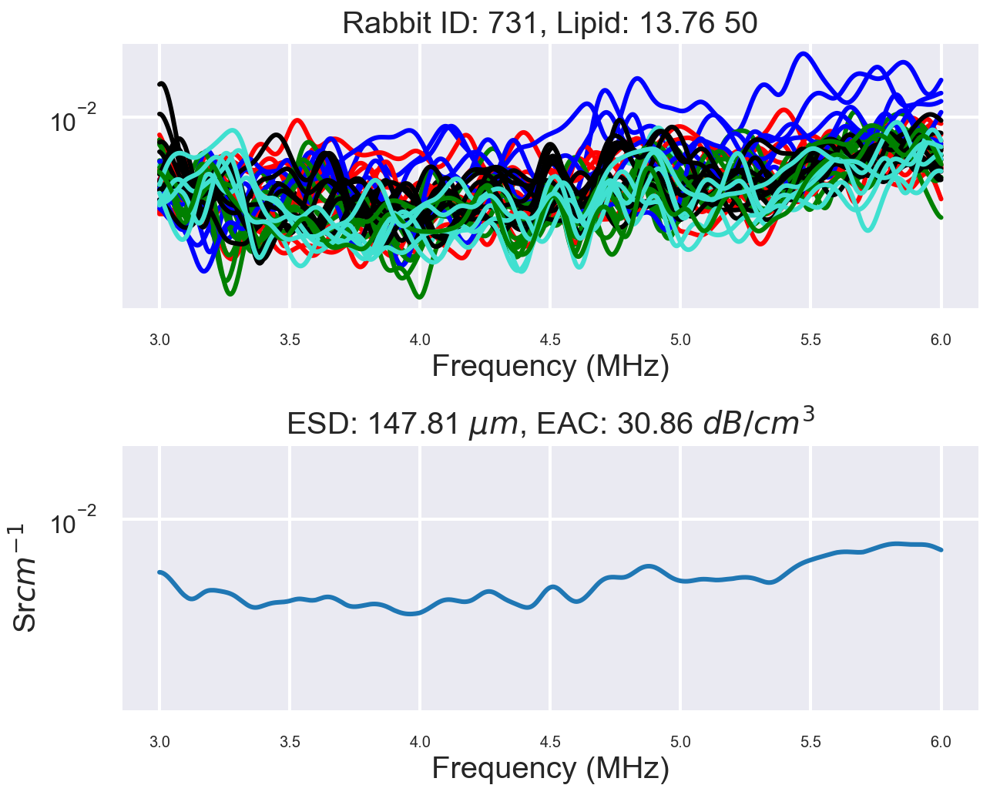

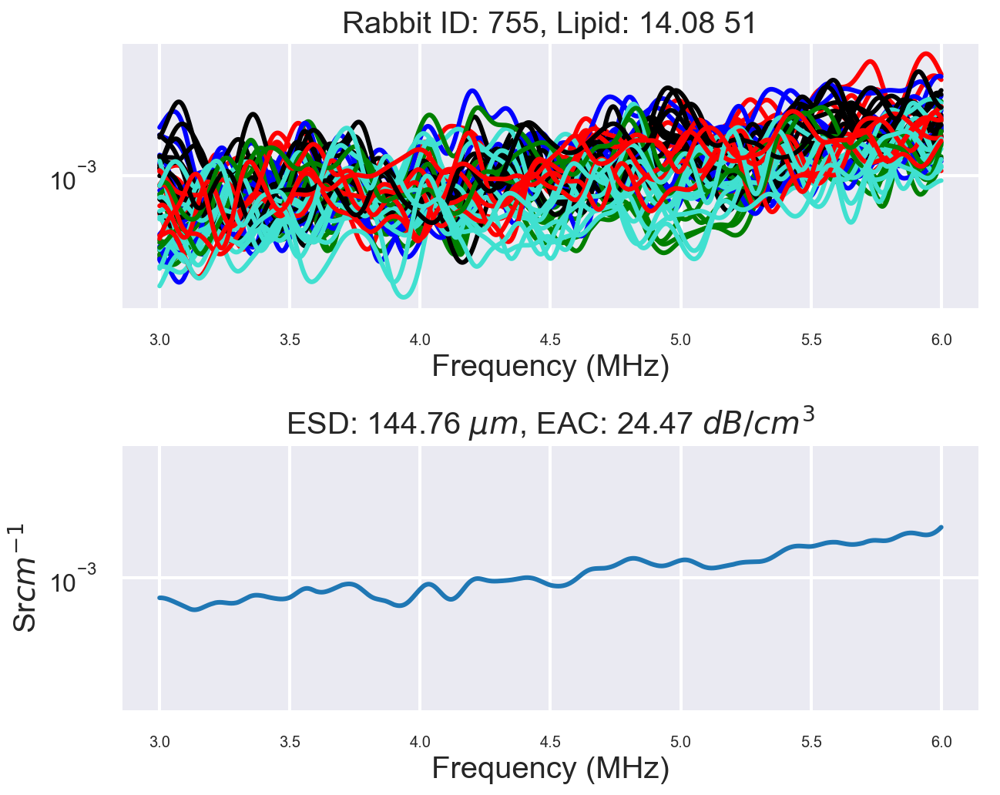

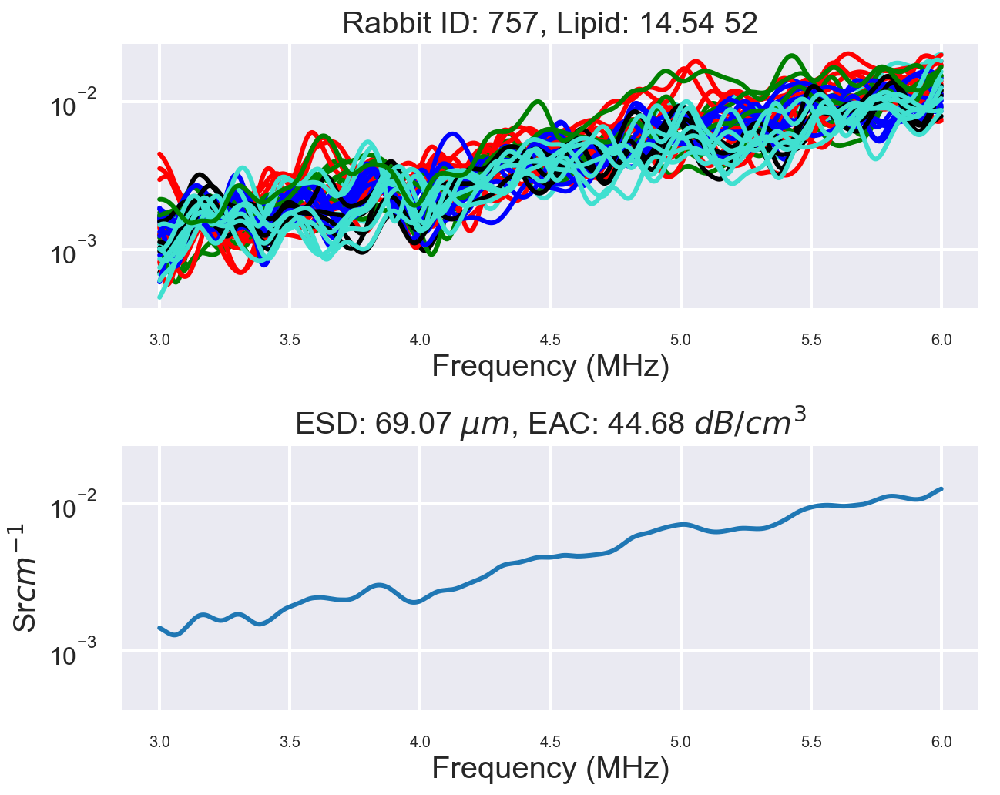

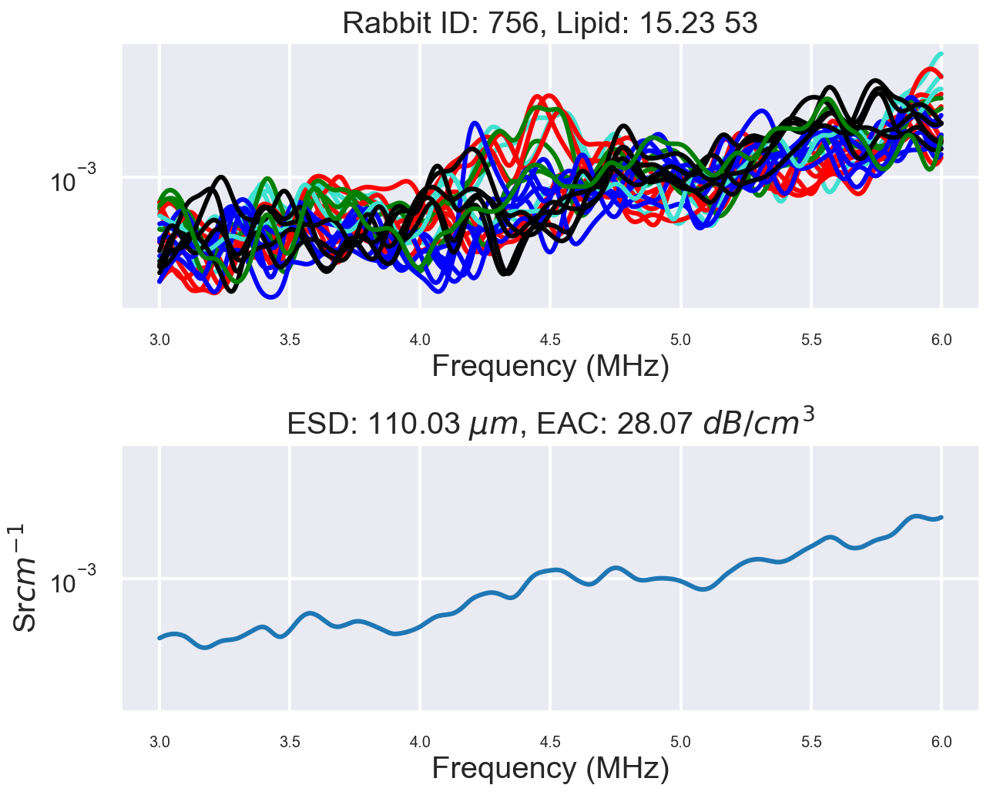

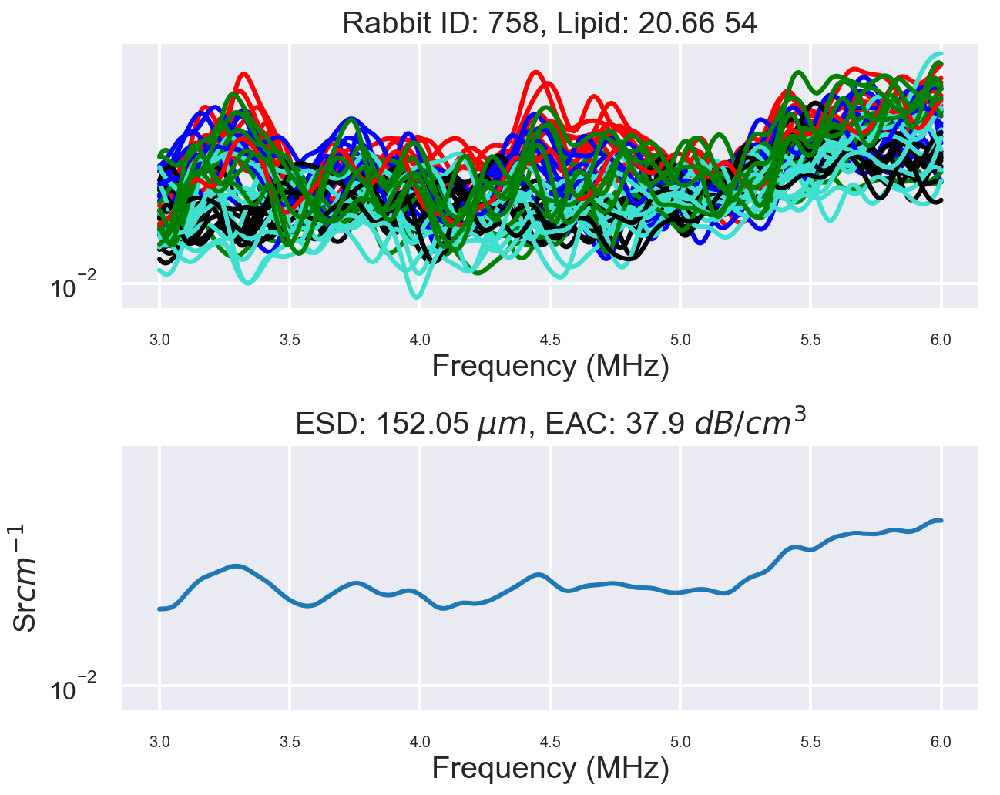

In [32]:
esd_dict = {}
eac_dict = {}

count = 0
for idx, row in dataBase.iterrows():
    count = count + 1
    lipid = row.Lipid
    rabbit_number = str(int(row.Rabbit))
    bscs = BSCs_dict[rabbit_number]
    depth = depth_dict[rabbit_number]
    
    if (len(bscs) == 0):
        continue
    freq_key = next(iter(freq_bsc_dict[rabbit_number]))
    freq = freq_bsc_dict[rabbit_number][freq_key].flatten()
    
    f, (ax1, ax2) = plt.subplots(2, 1, sharey = True, figsize = (10, 8))

    rabbit_bsc = []
    for frame_ in bscs:
        if (bscs[frame_].shape[1] > 0):
            avg_bsc = np.mean(bscs[frame_], axis = 1)
            no_rois = bscs[frame_].shape[1]
            max_depth = np.round(np.max(depth[frame_]))
            min_depth = np.round(np.min(depth[frame_]))
            range_depth = str(min_depth) +'-' +str(max_depth)
            if (no_rois >0):
                ax1.semilogy(freq, avg_bsc, color = filter_frame(frame_), label = str(frame_))
                rabbit_bsc.append(avg_bsc)
    
    ax2.semilogy(freq, np.mean(np.vstack(rabbit_bsc), axis = 0))
    try:
        temp2, idxs = filter_bsc(np.vstack(rabbit_bsc).T)
        esd, eac = get_ESD_EAC(freq, np.mean(temp2, axis = 1))
        esd_dict[lipid] = esd
        eac_dict[lipid] = eac
    except:
        esd = 0
        eac = 0
    
    ax1.set_title("Rabbit ID: " + rabbit_number + ", Lipid: " + str(lipid) +" "+ str(count))
    #ax1.set_ylim([10**-5, 10])
    ax1.set_xlabel('Frequency (MHz)')
    ax2.set_xlabel('Frequency (MHz)')
    ax2.set_ylabel('Sr$cm^{-1}$')
                           
    ax2.set_title("ESD: " + str(np.round(esd,2)) + " $\mu m$, EAC: " \
                  + str(np.round(eac, 2)) + " $dB/cm^3$")
    f.subplots_adjust(hspace = 0.5)
    #plt.legend(bbox_to_anchor=(1.1, 1.05), ncol=3)
    #plt.xlabel('Frequency (MHz)')
    #plt.ylabel('Sr$cm^{-1}$')
    plt.show()

# ATT for each rabbit

734


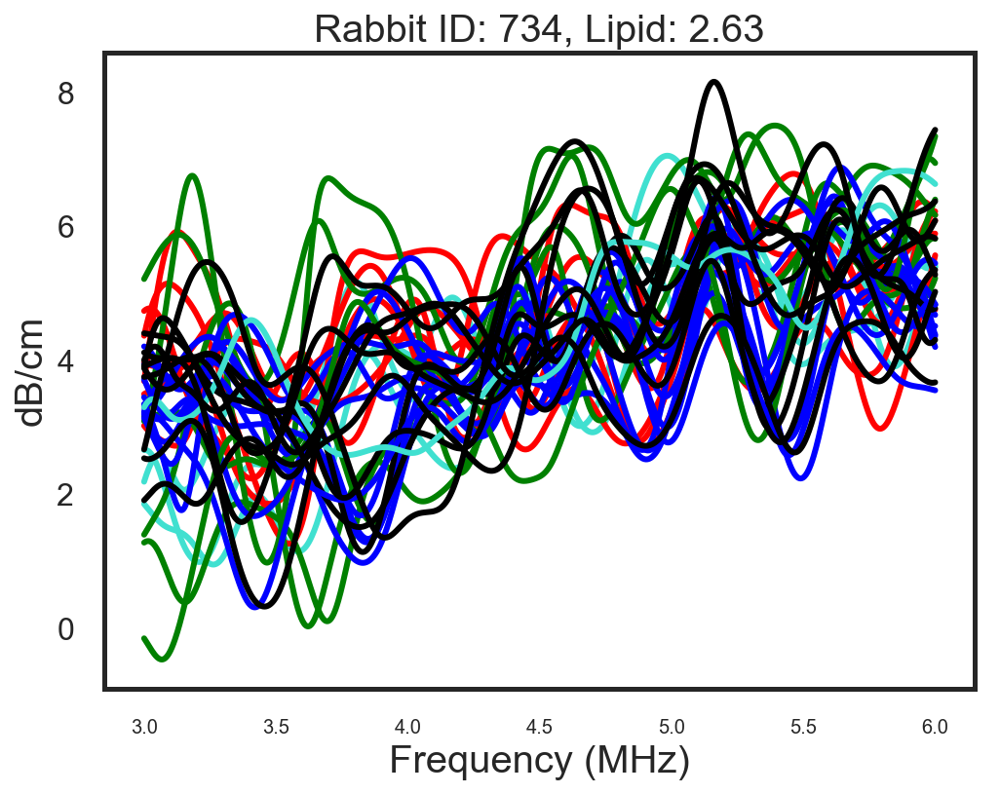

732


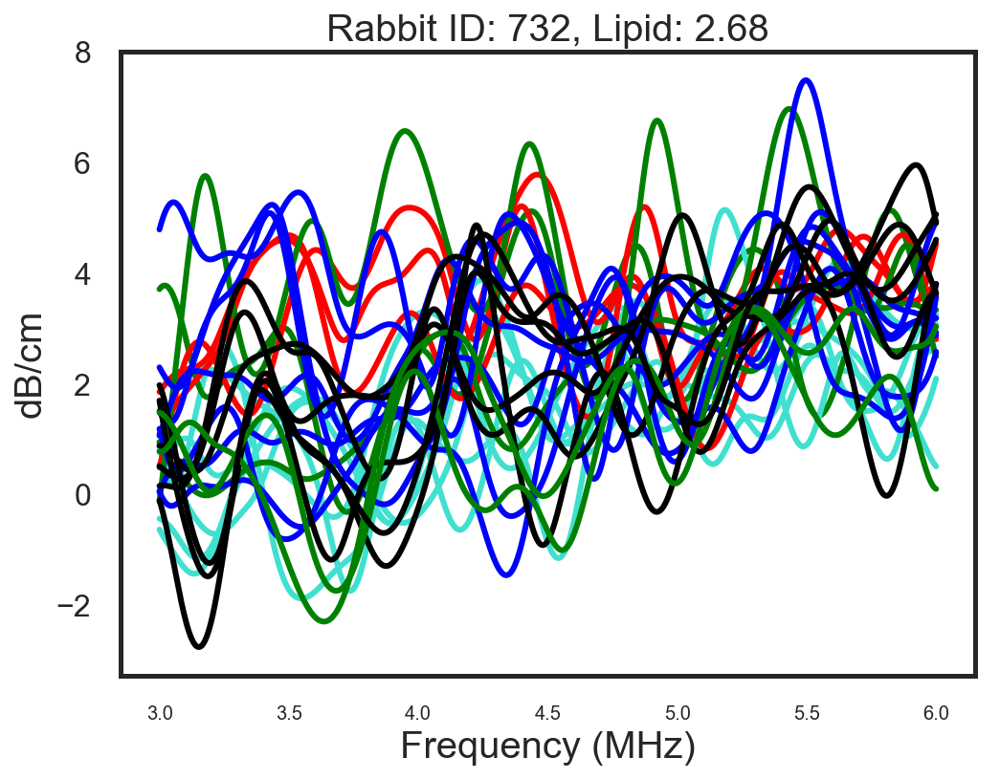

735


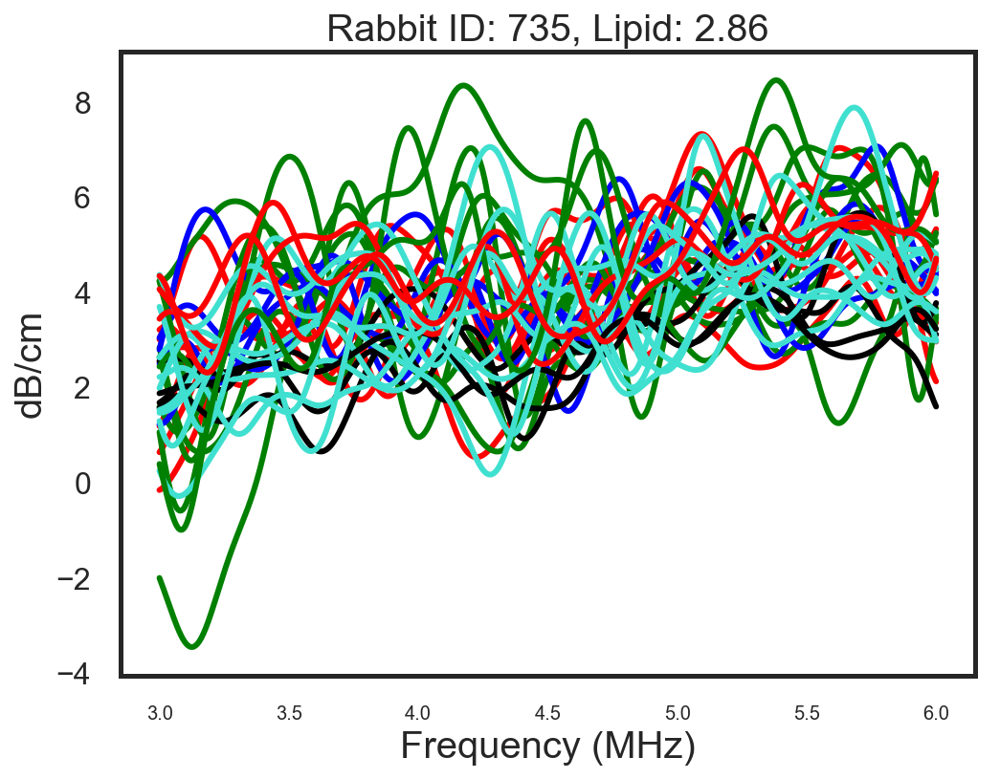

738


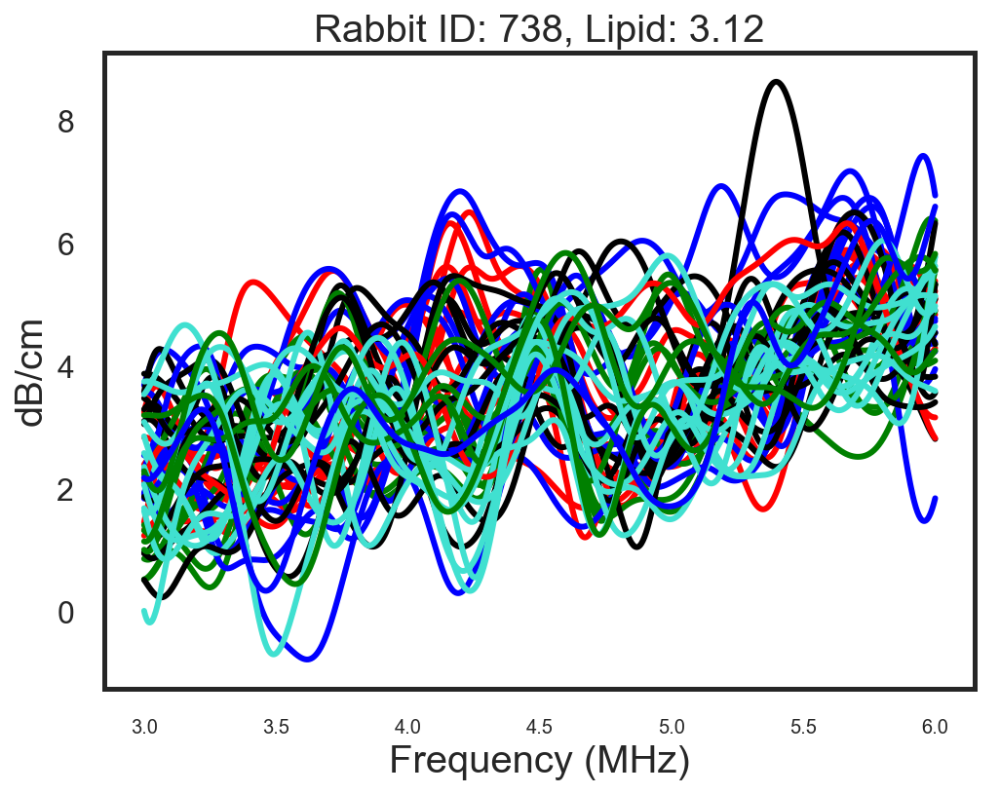

729


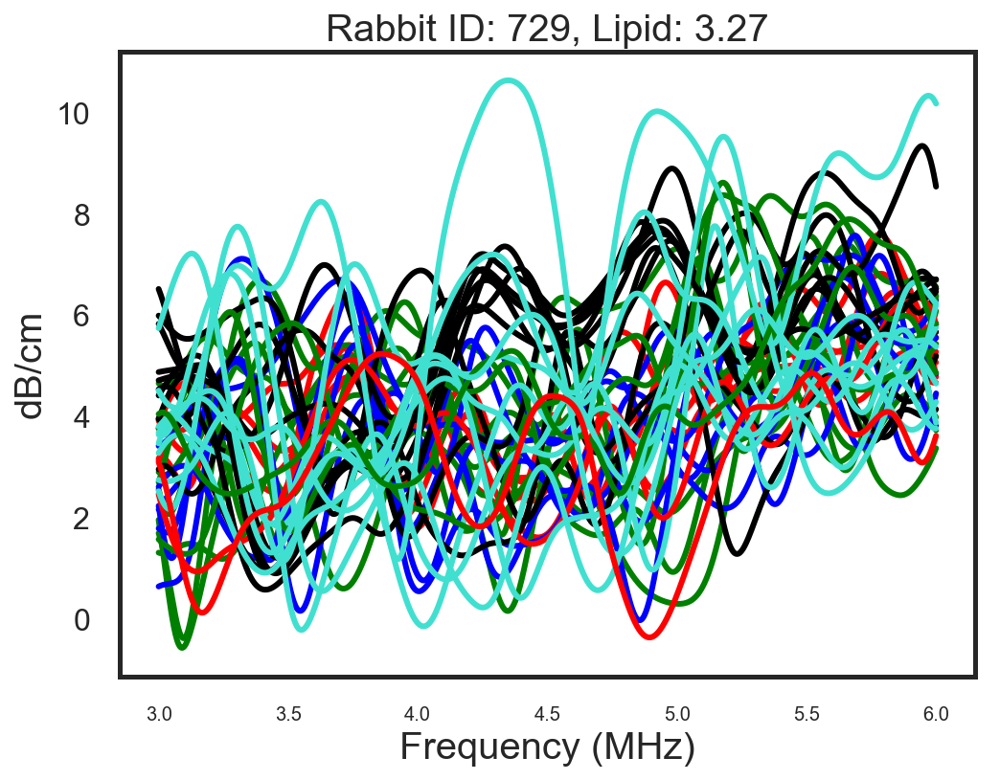

737


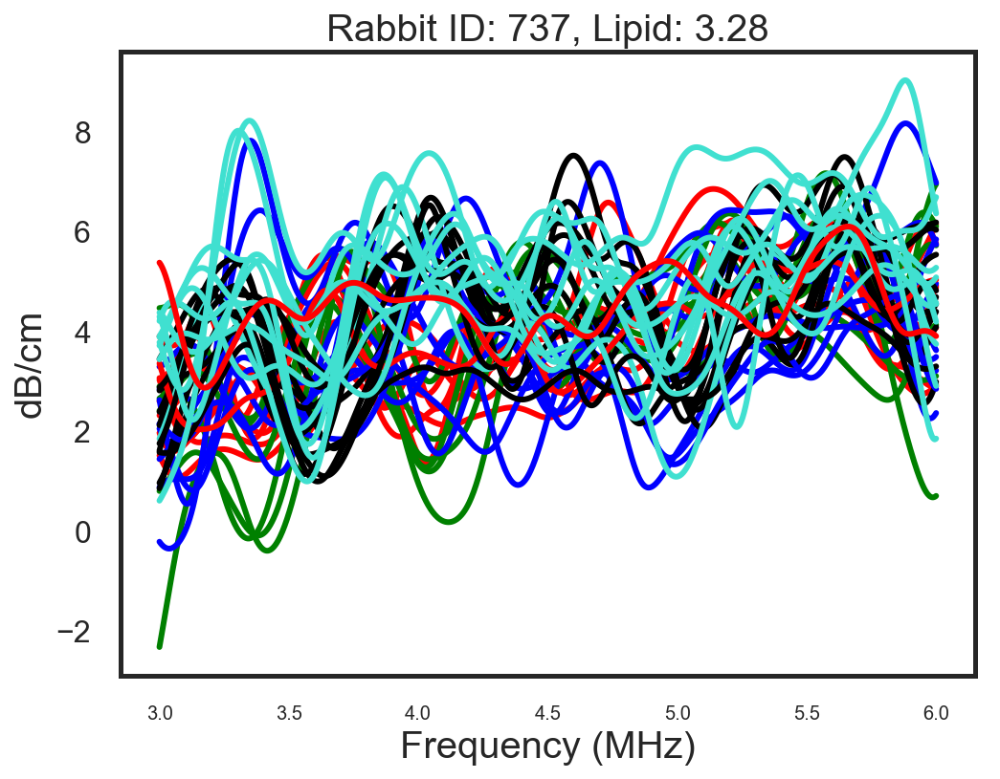

749


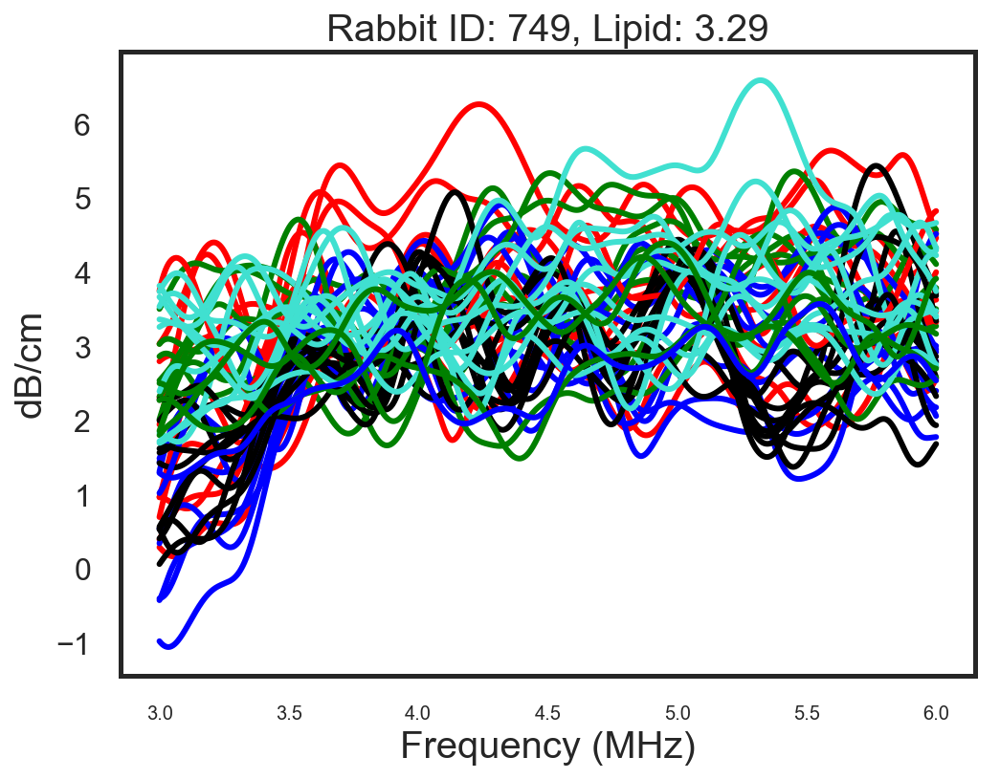

736


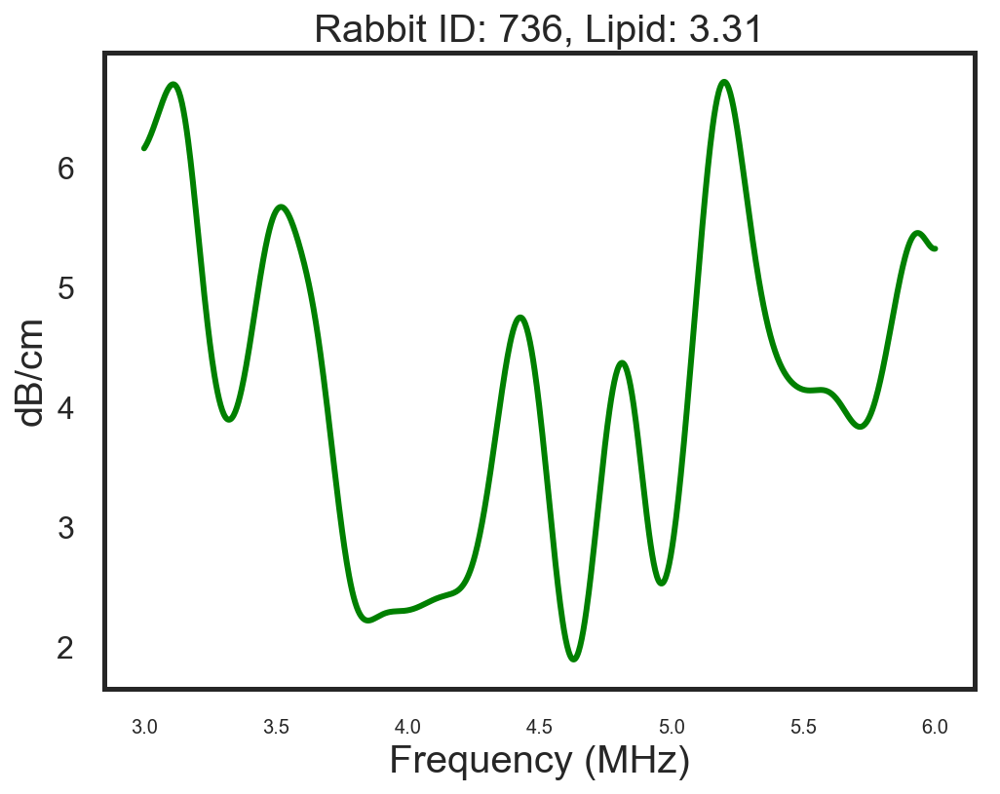

770


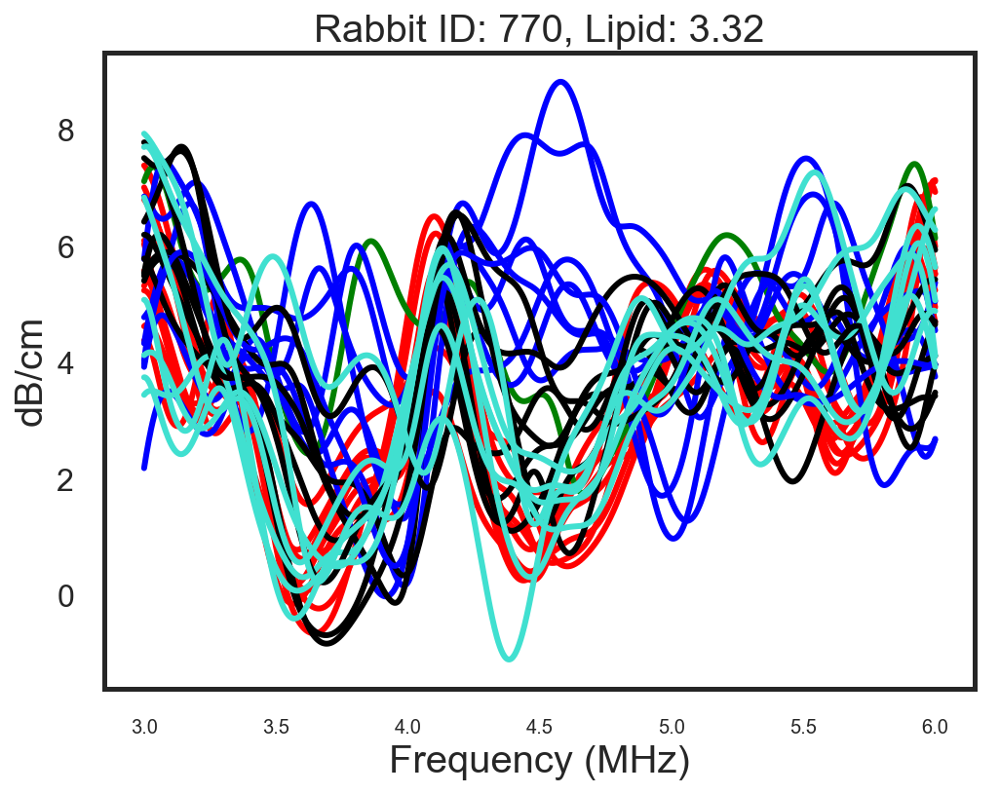

760


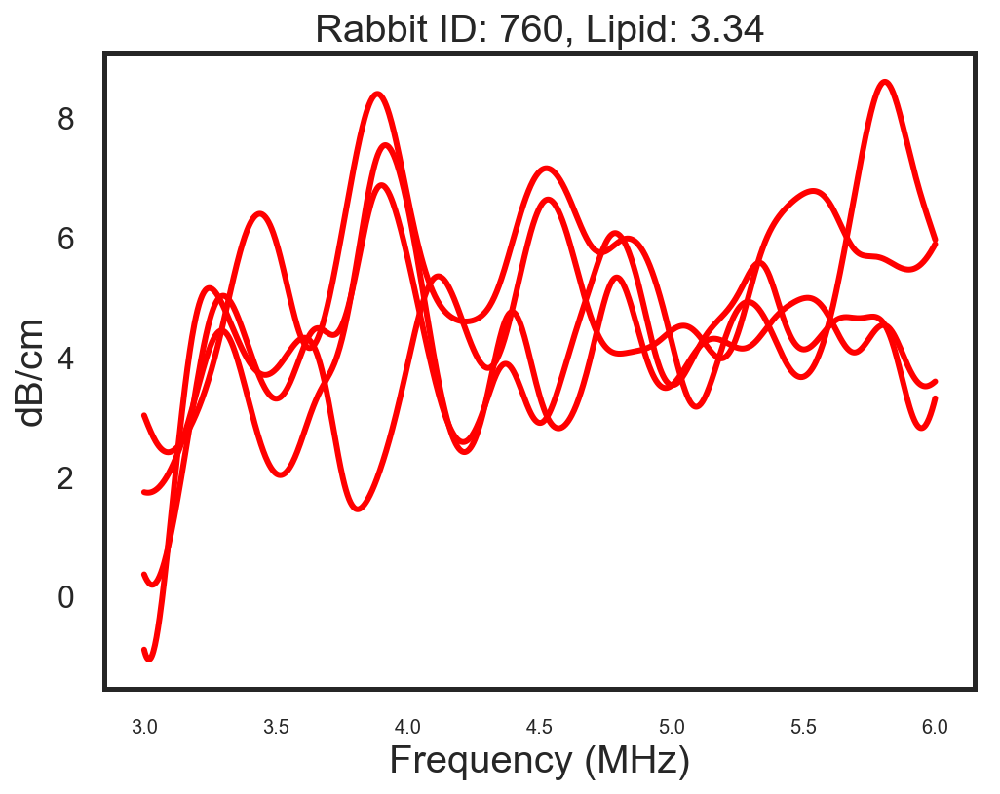

759


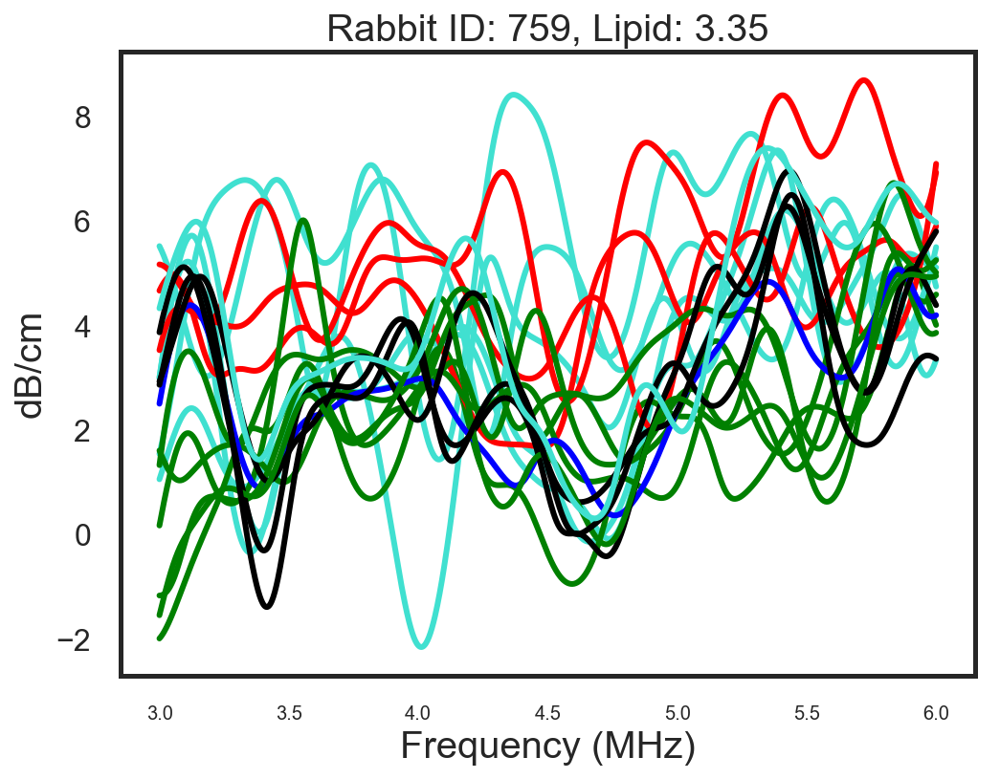

764


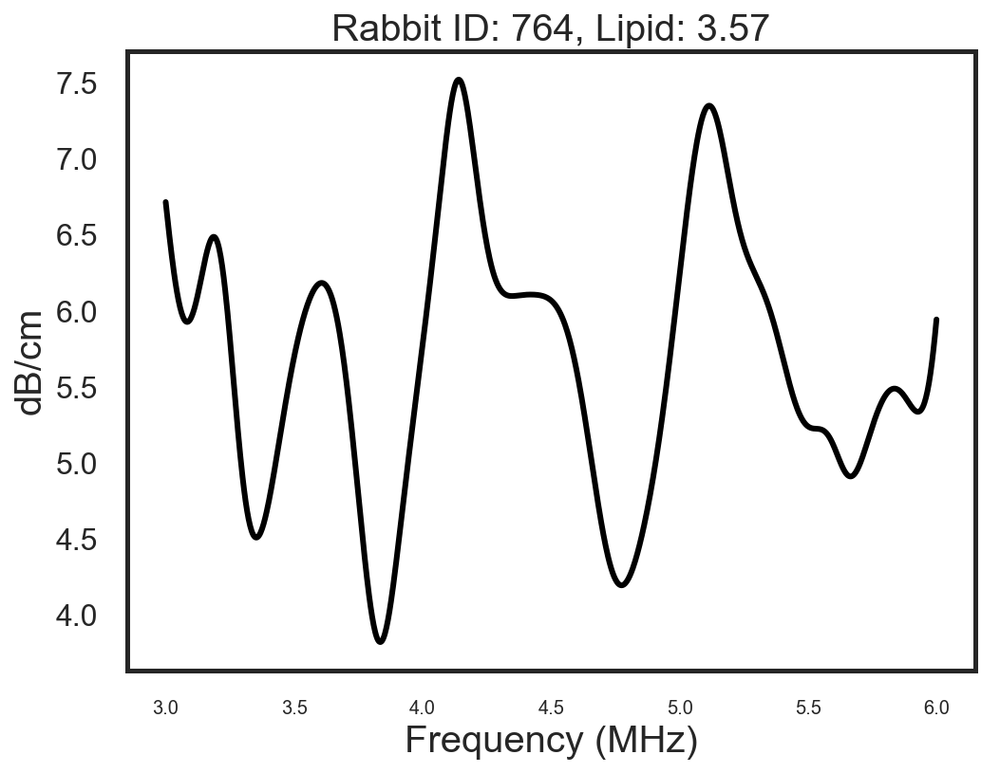

780


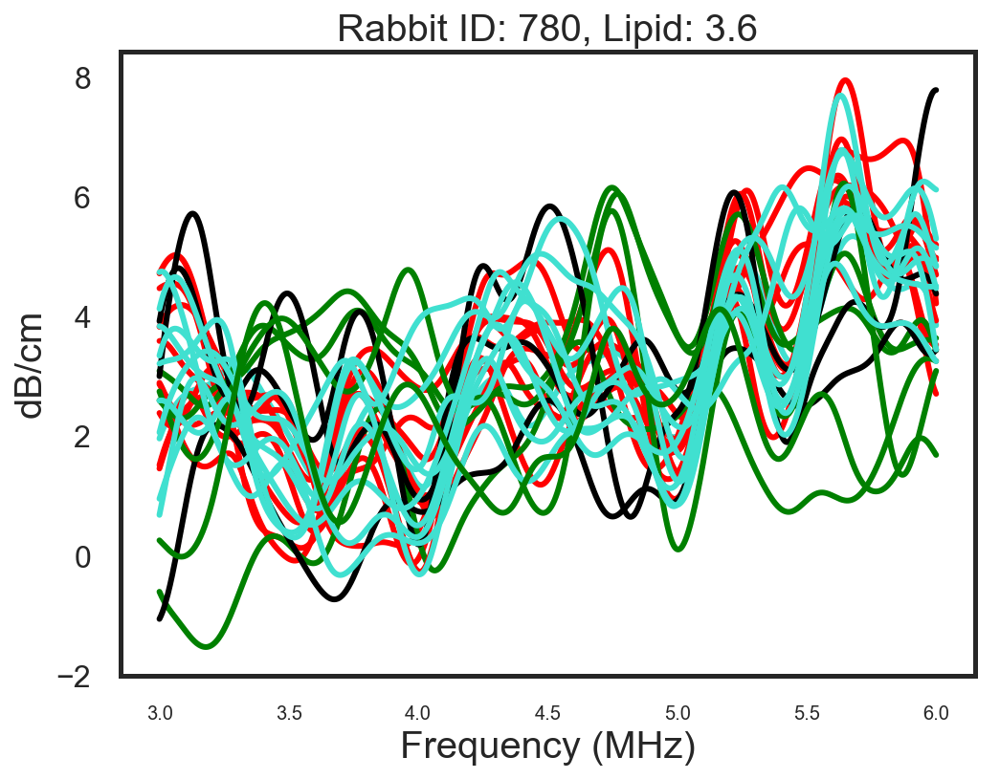

777


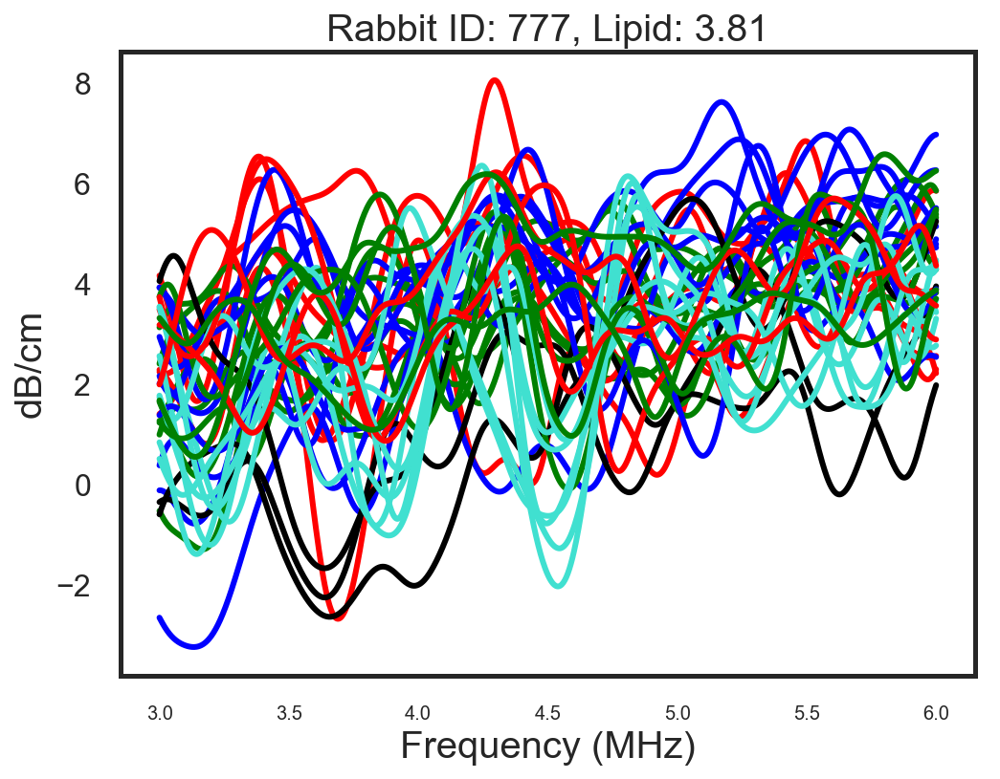

767


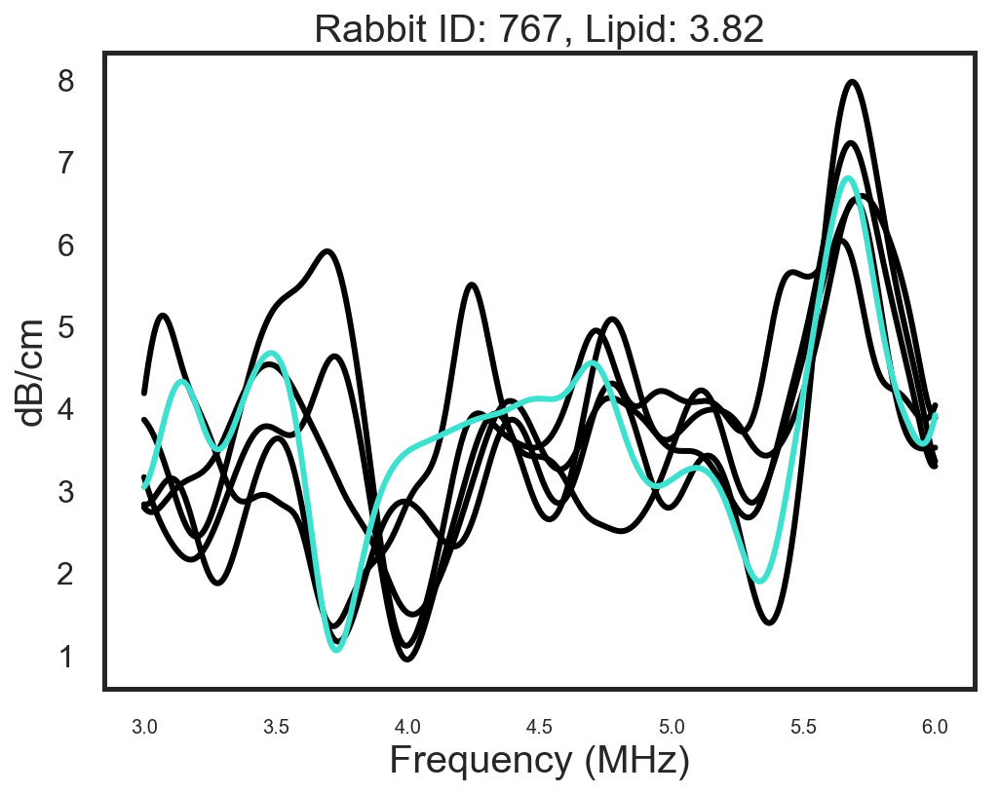

769


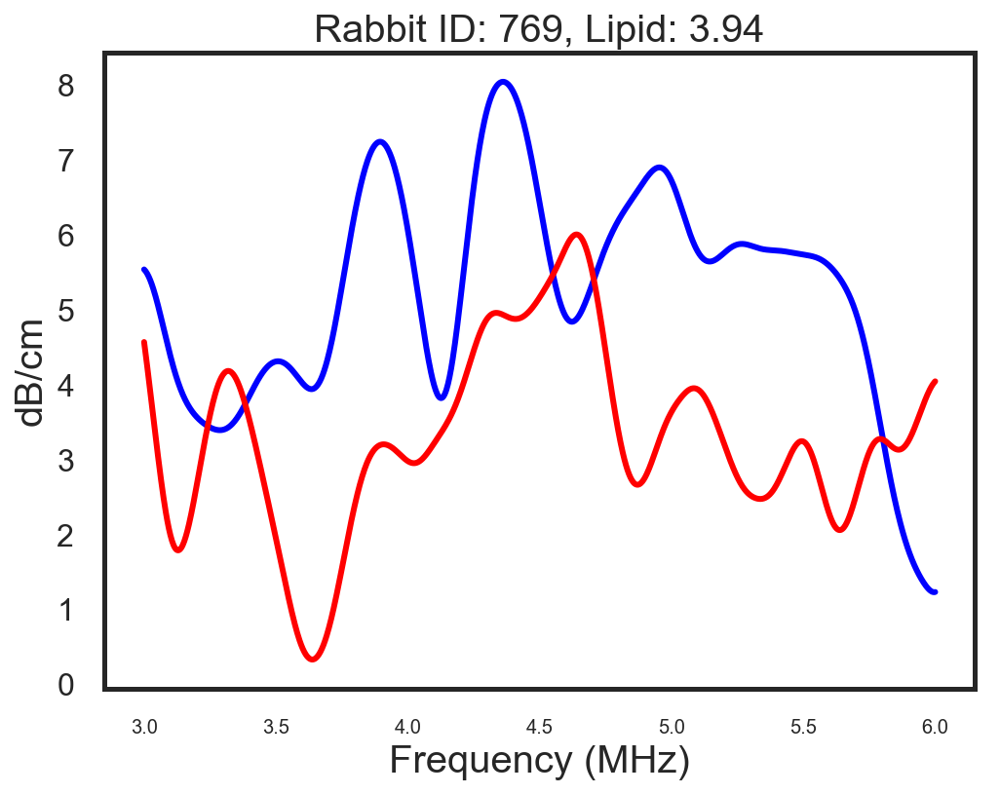

779


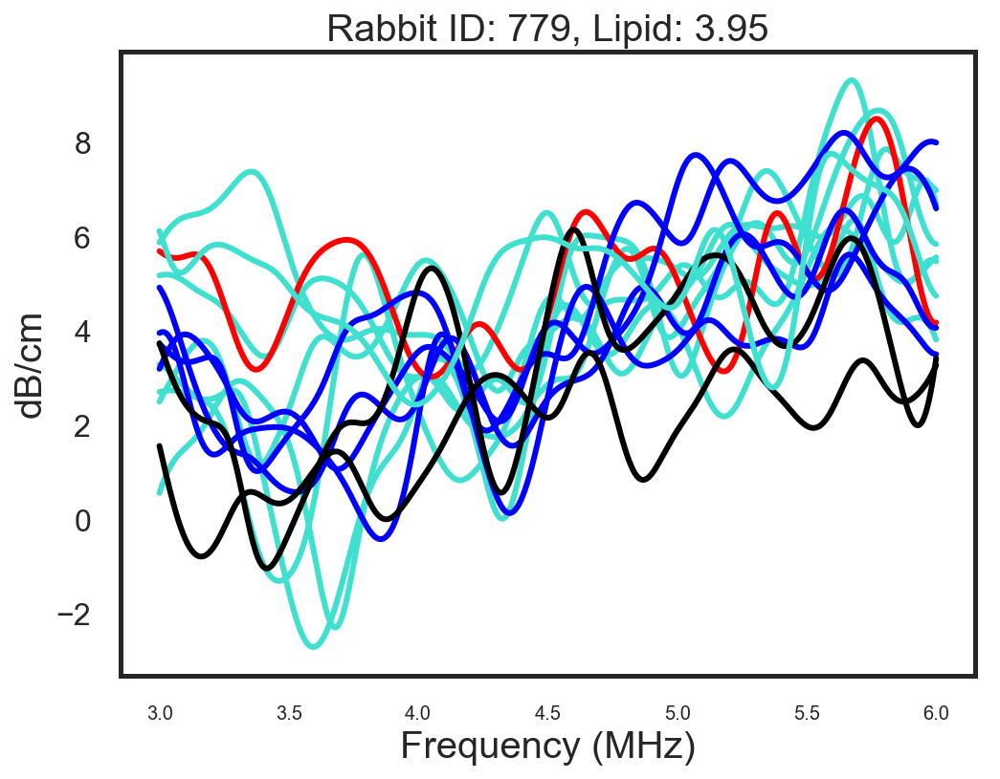

750


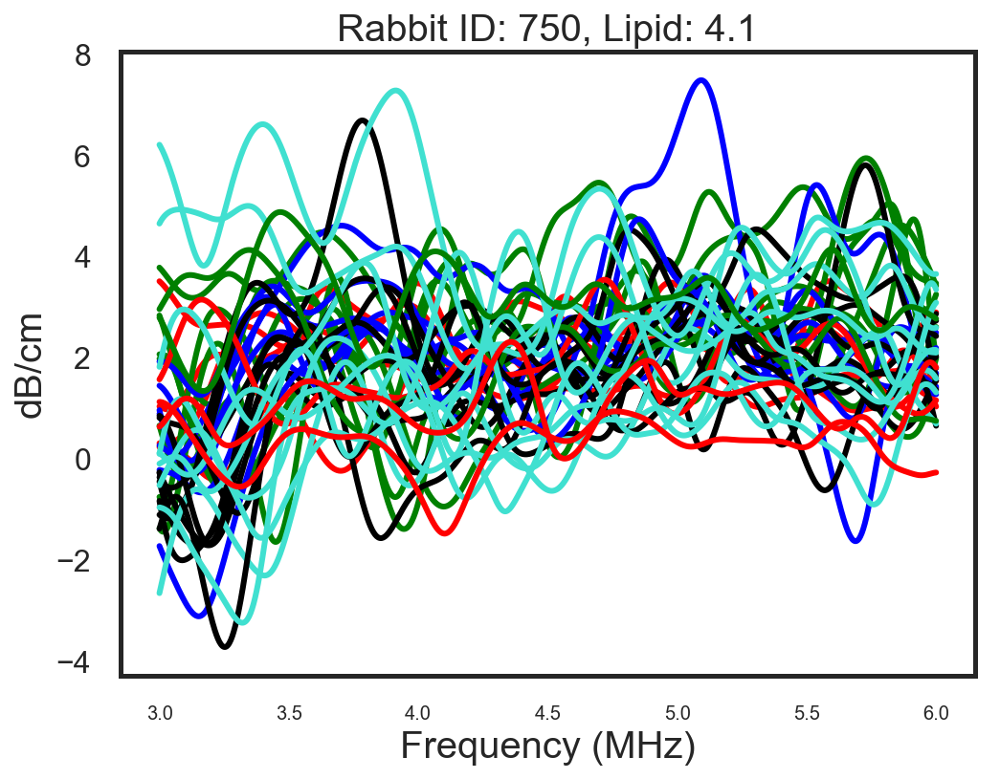

762


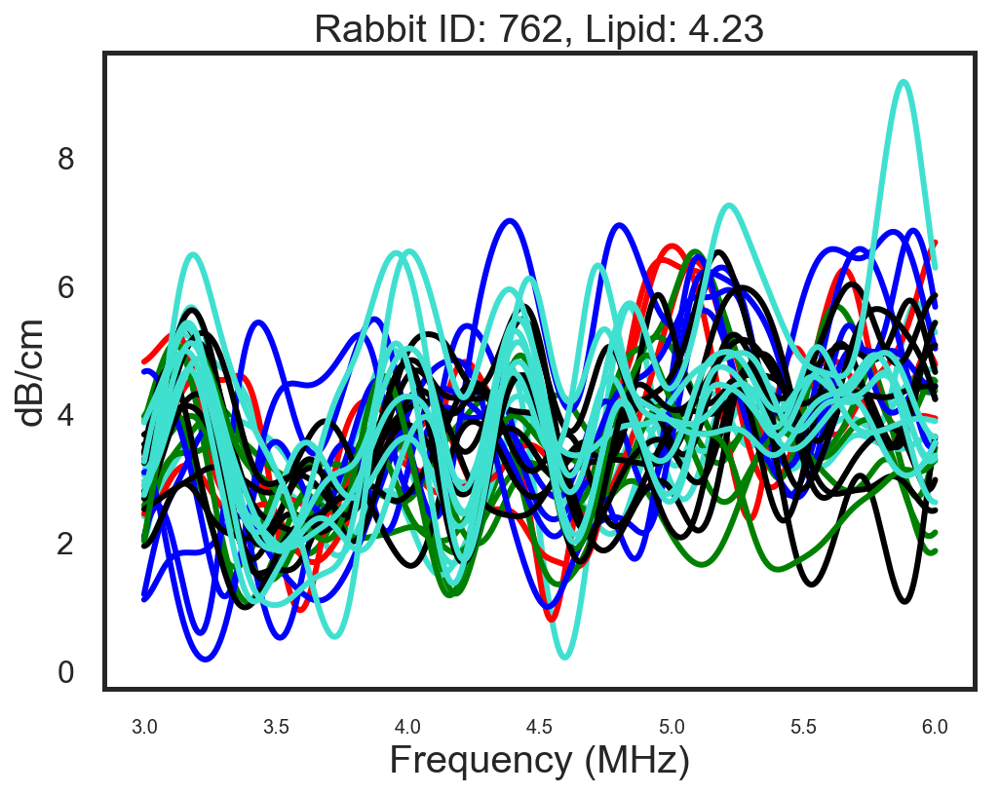

768


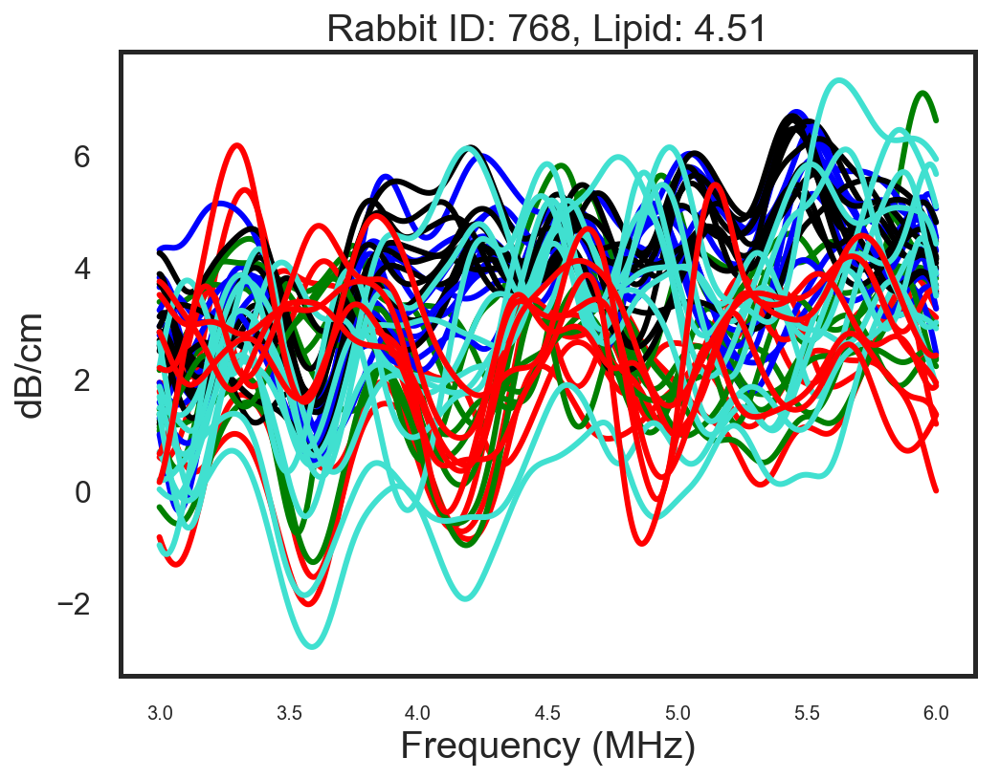

778


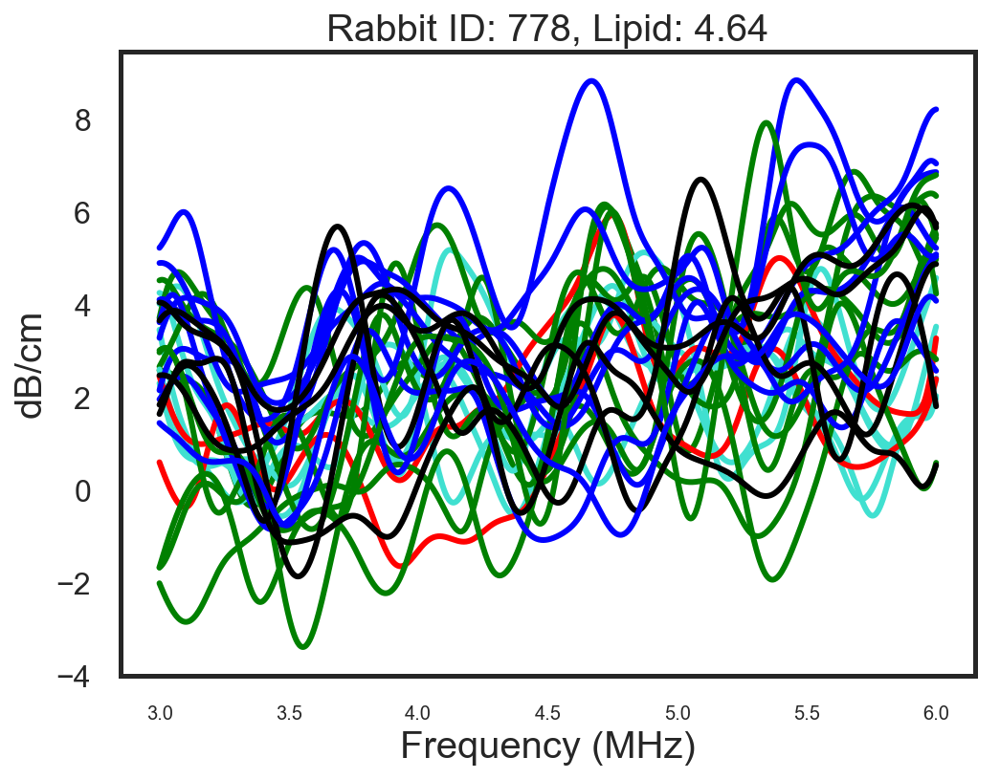

741


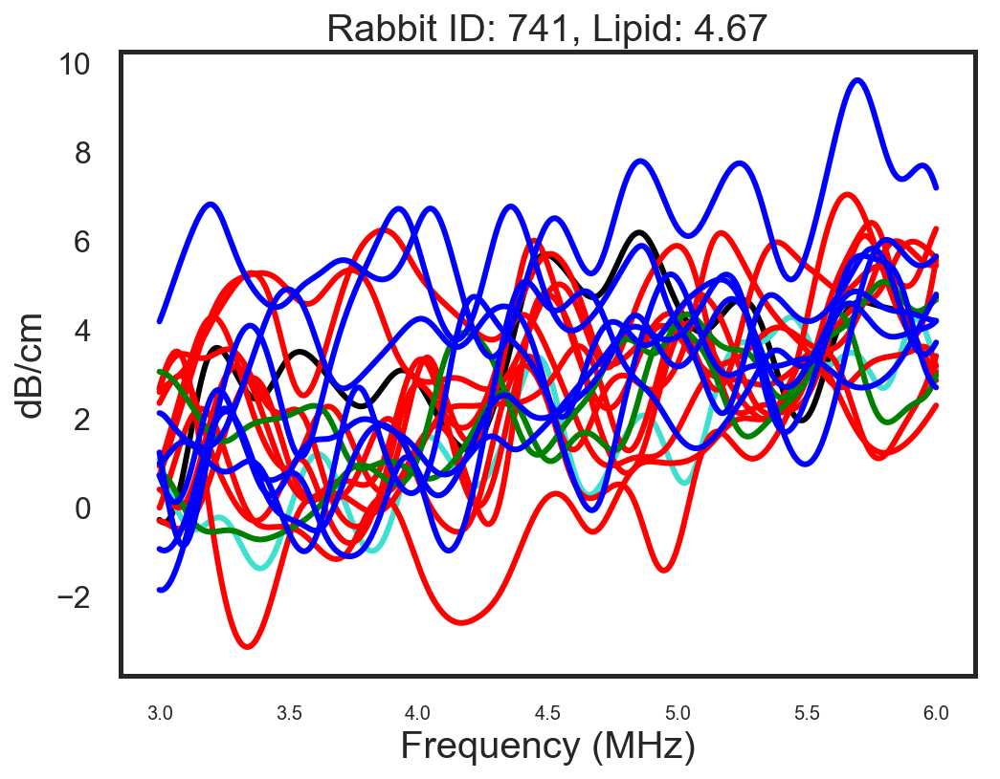

774


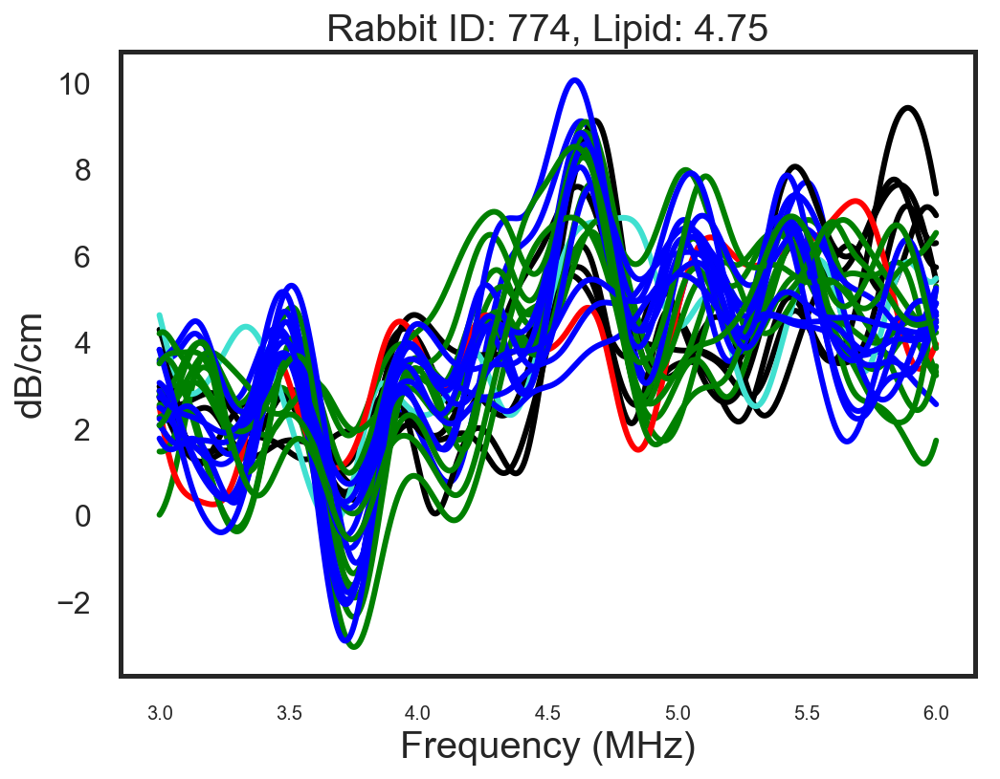

776


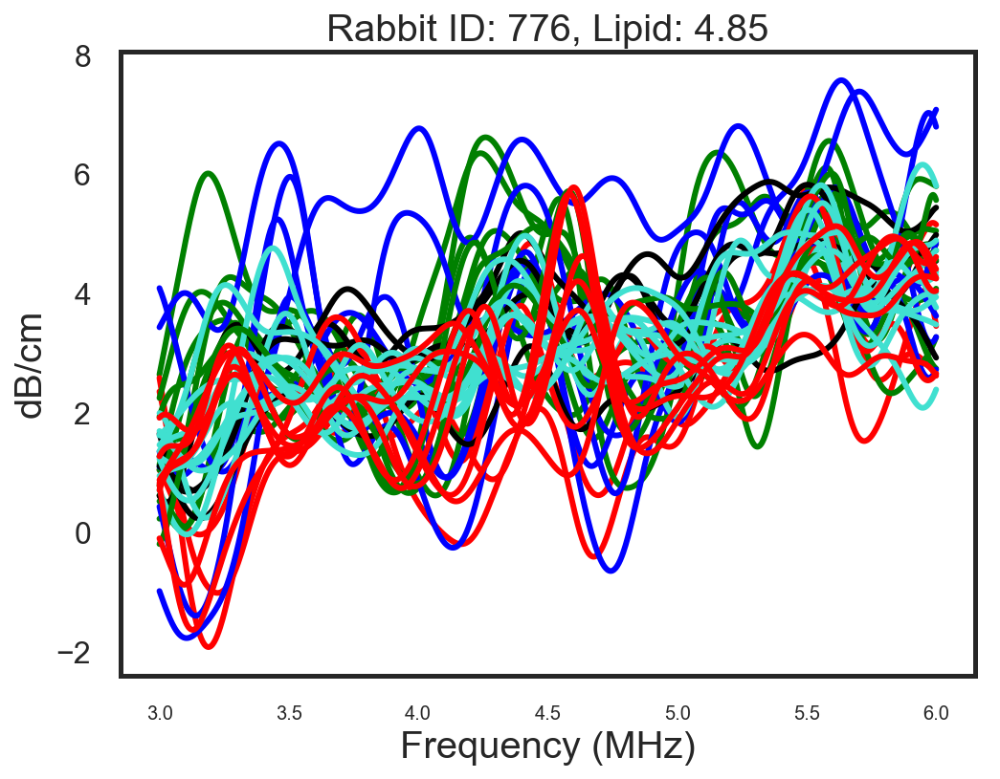

786


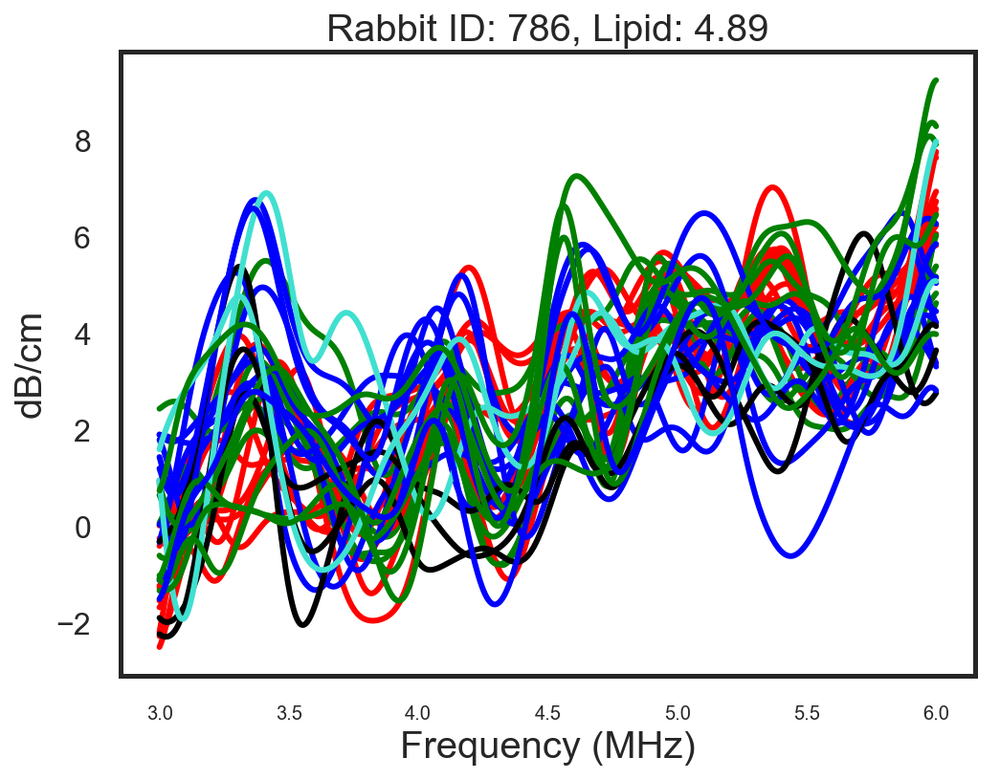

761


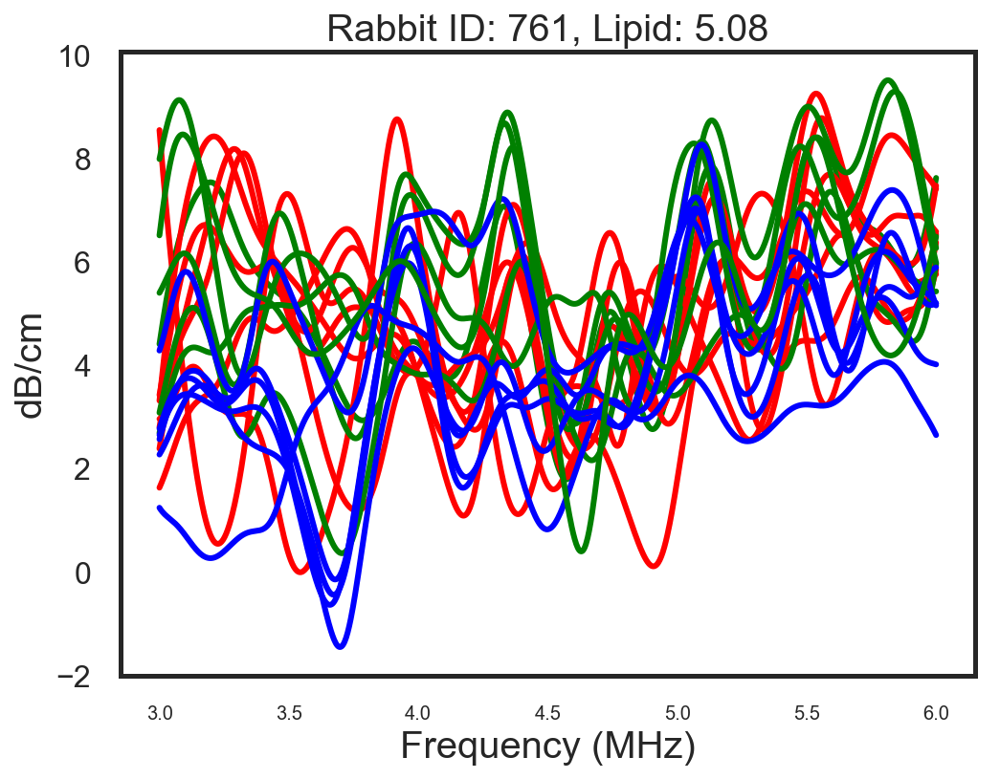

772


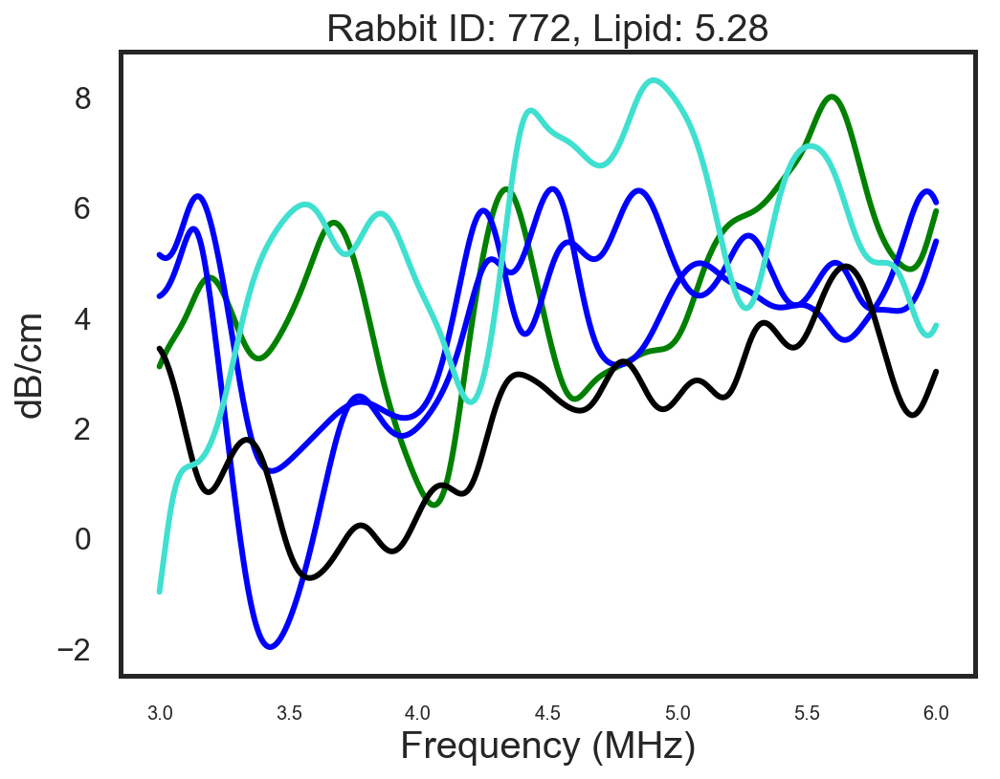

781


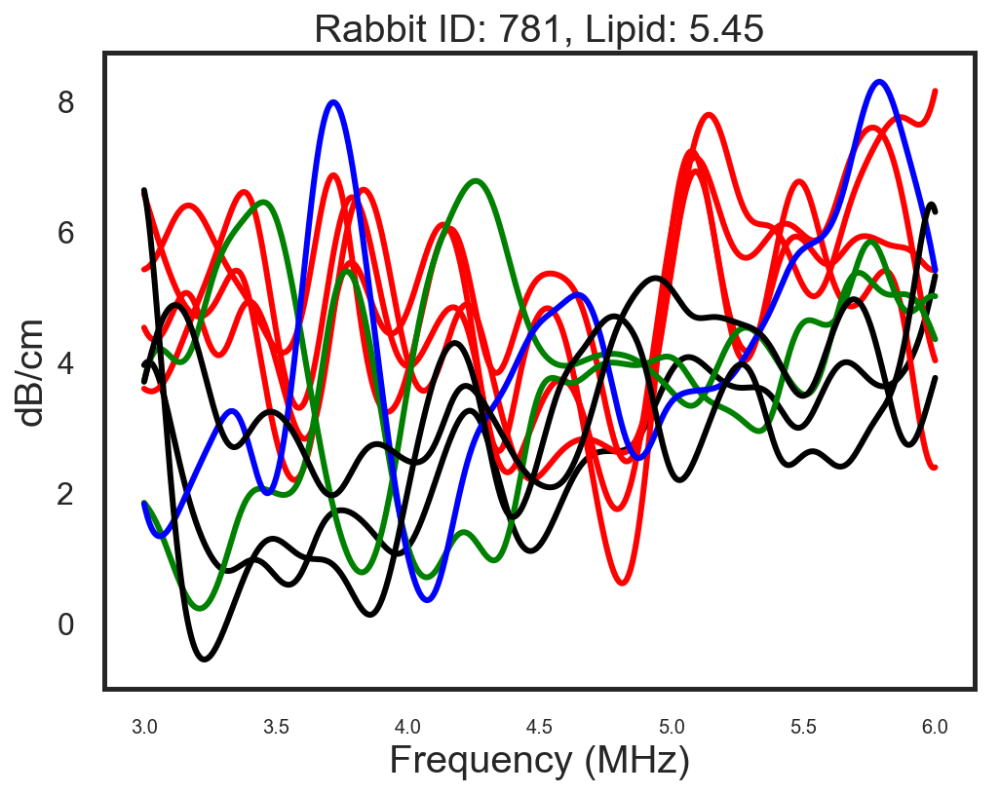

773


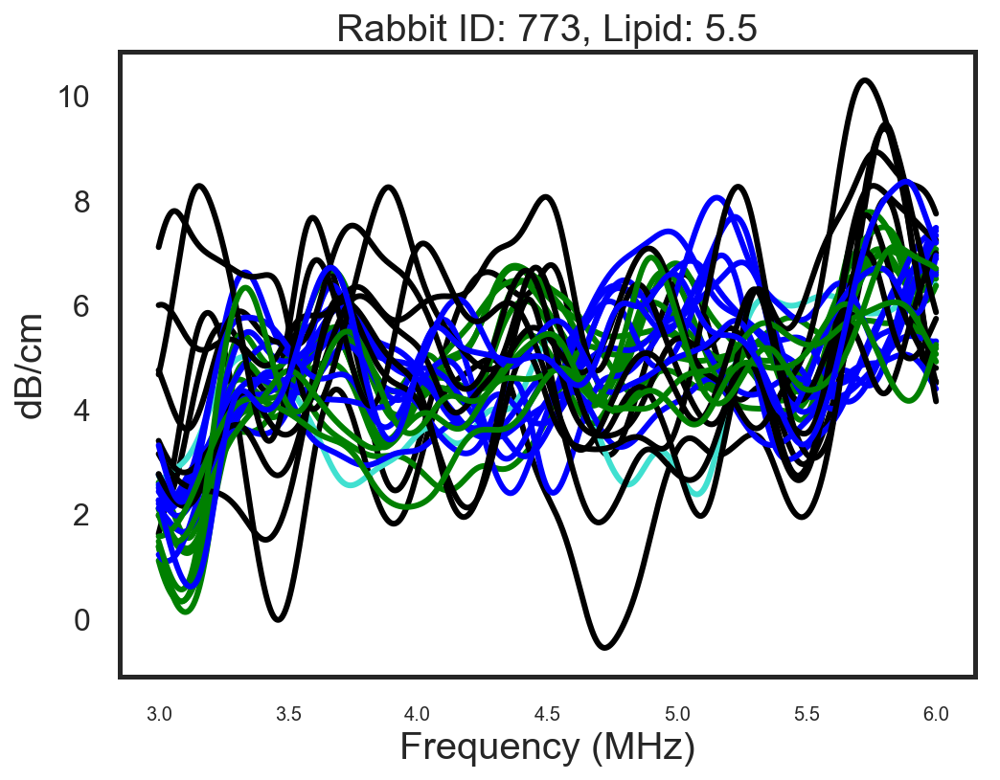

771


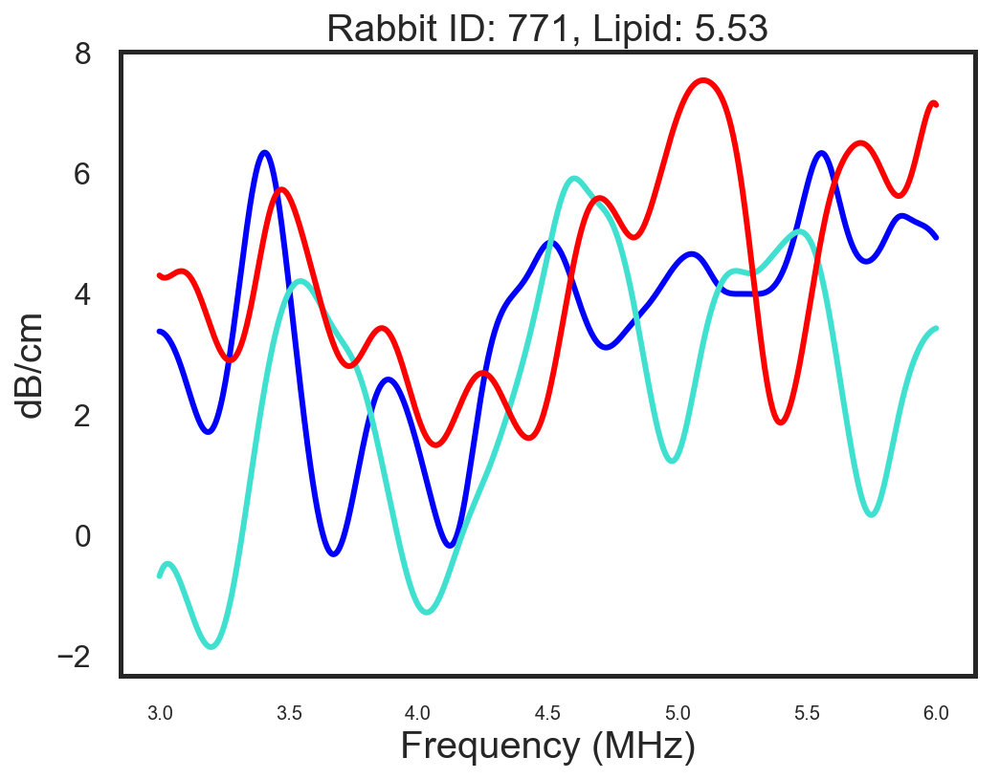

766


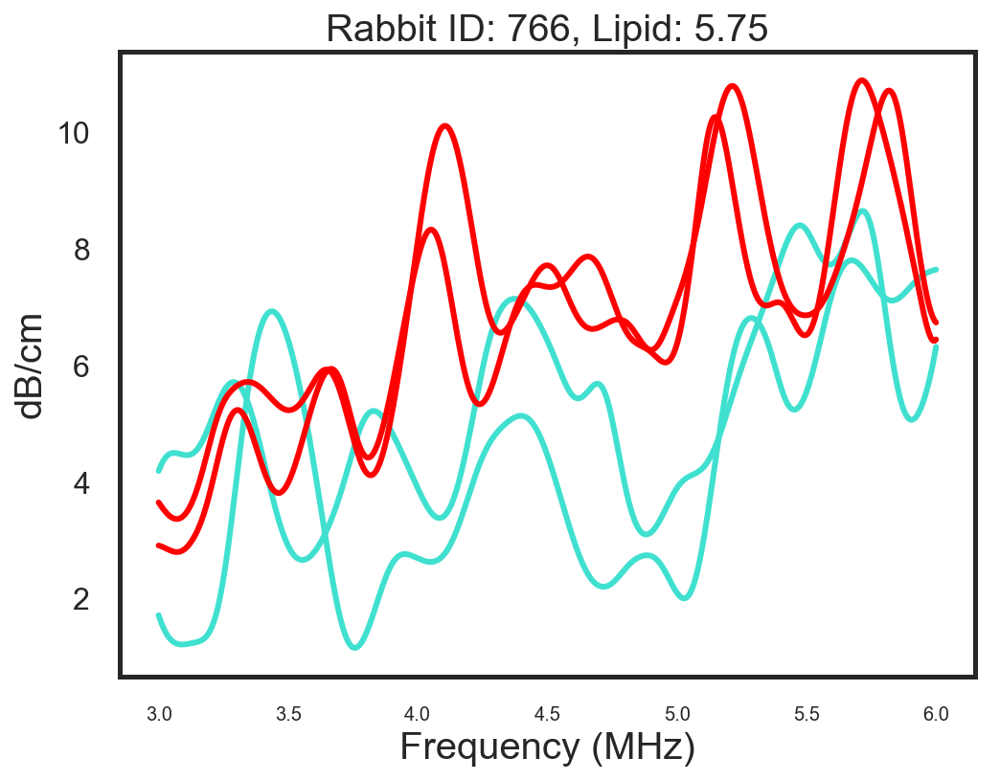

785


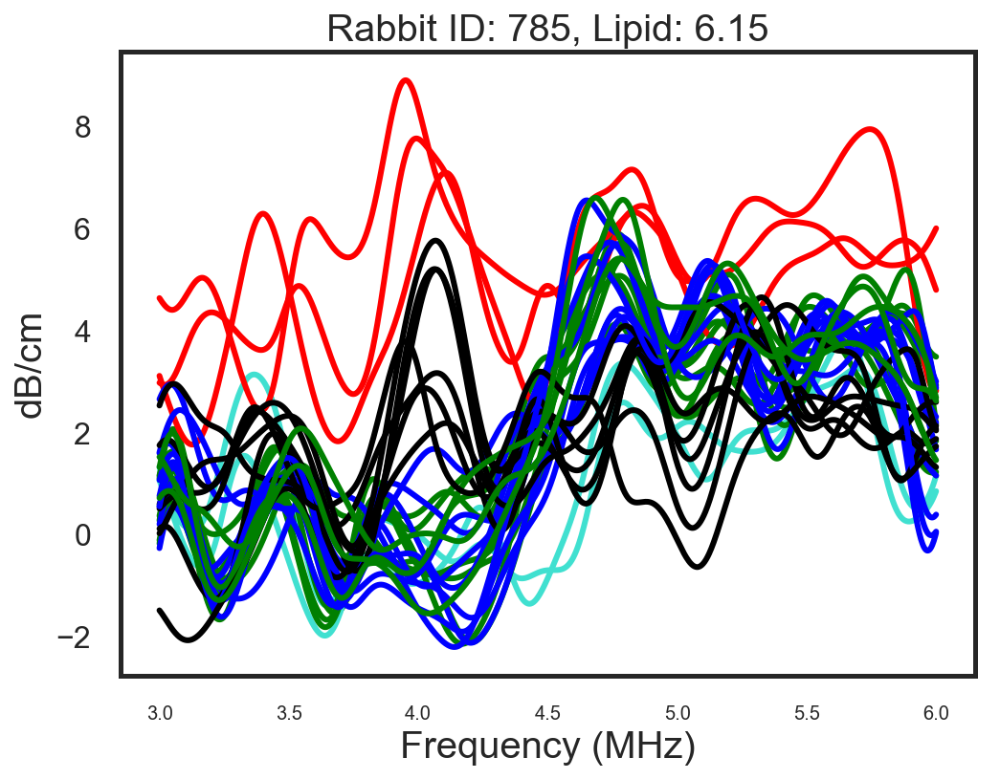

782


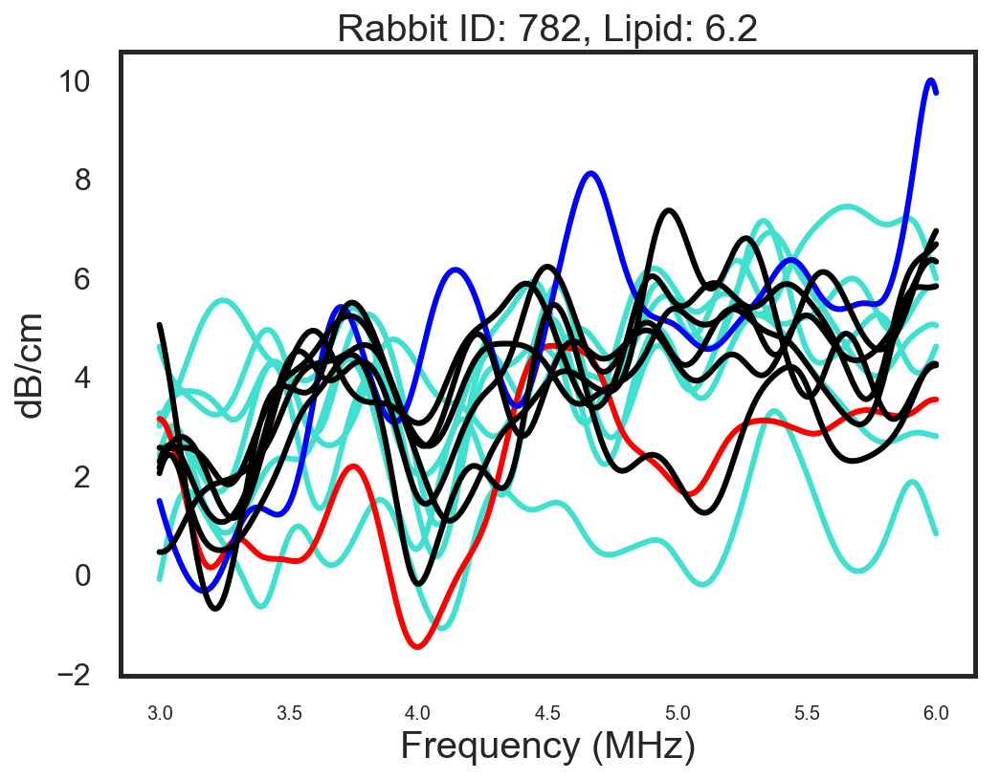

783


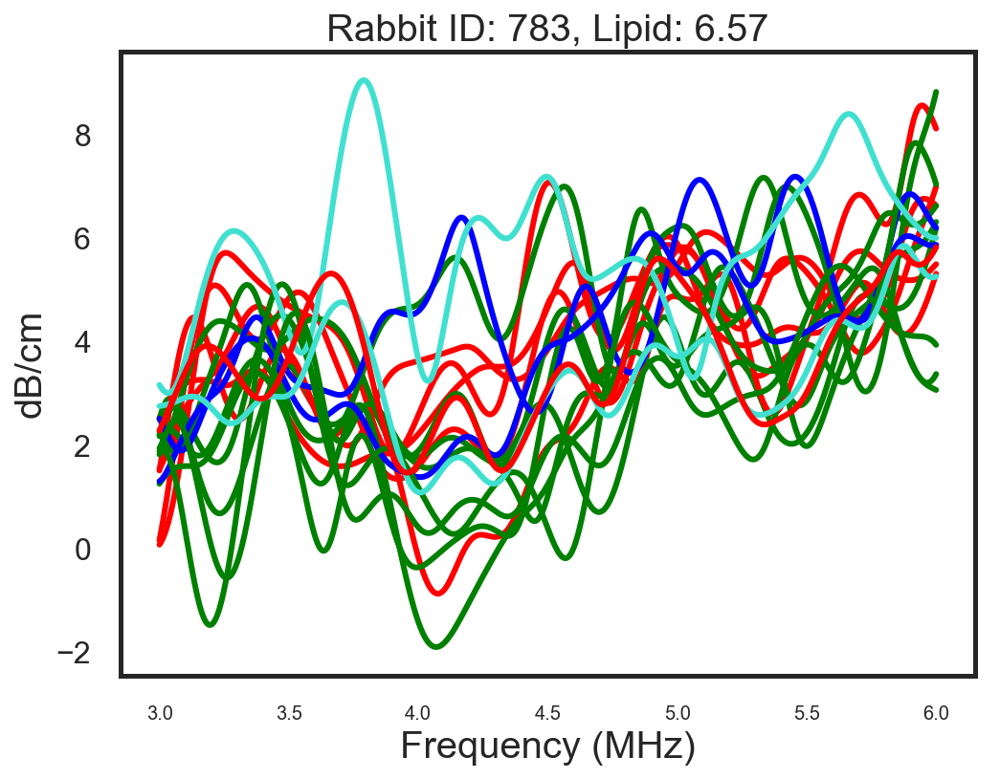

752


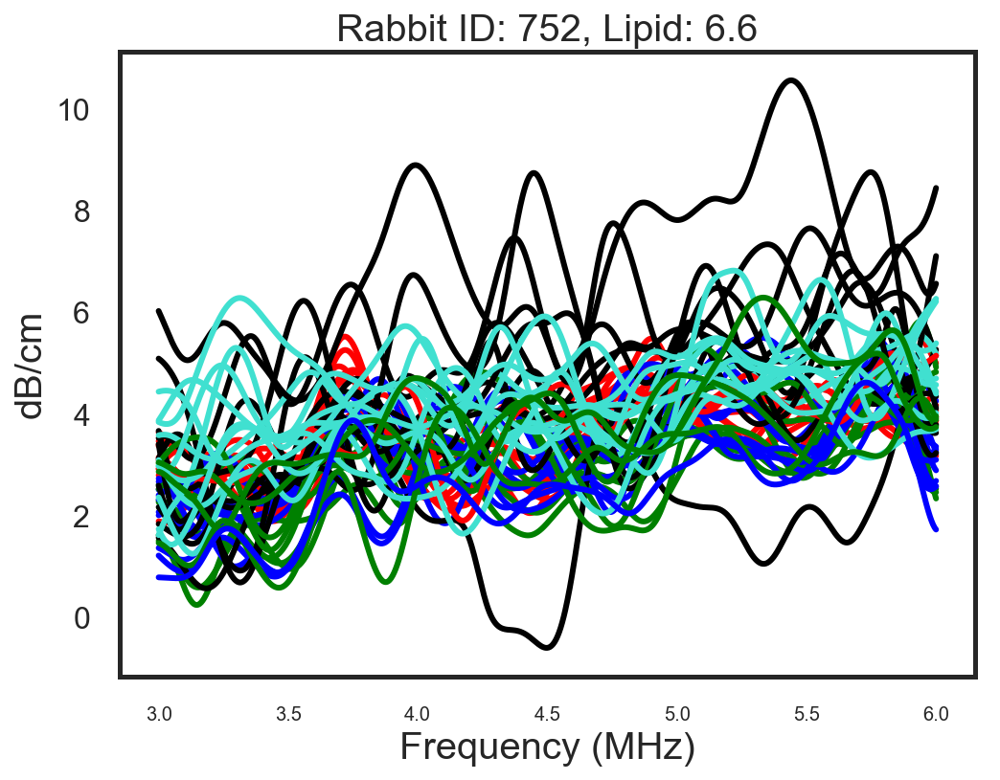

775


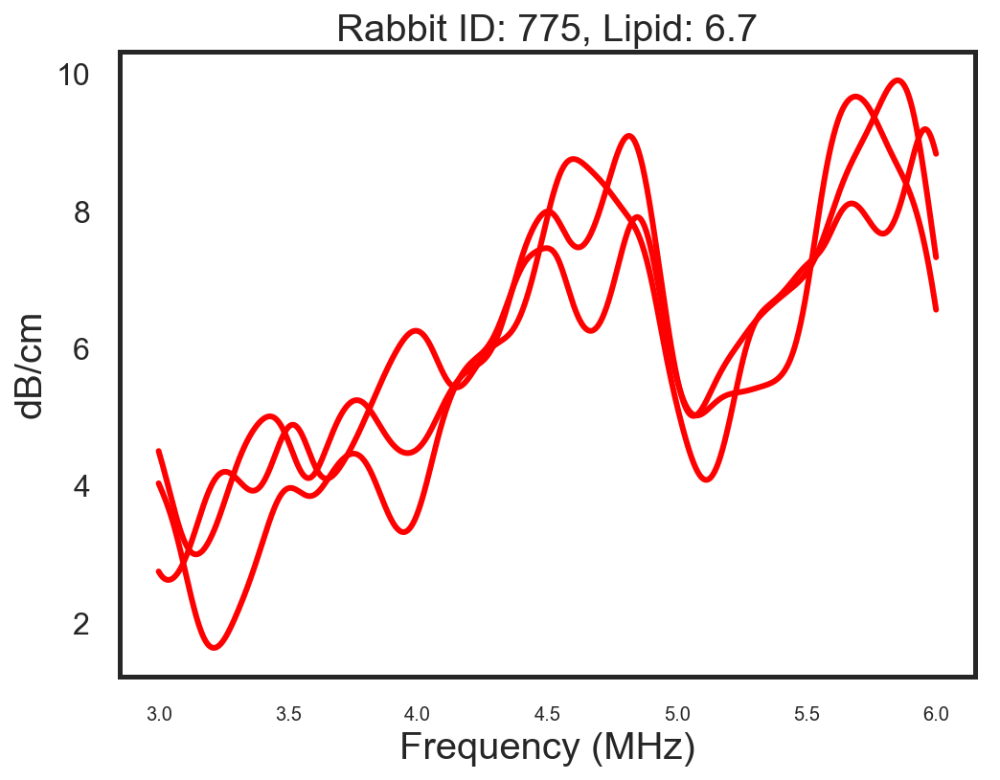

765


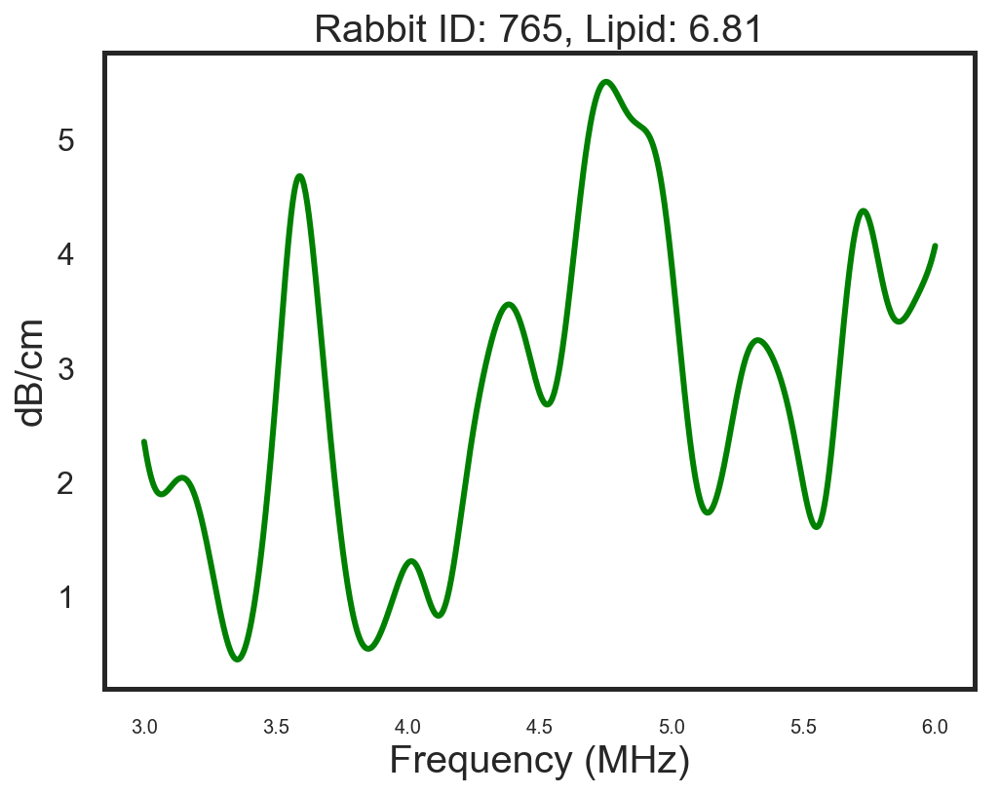

730


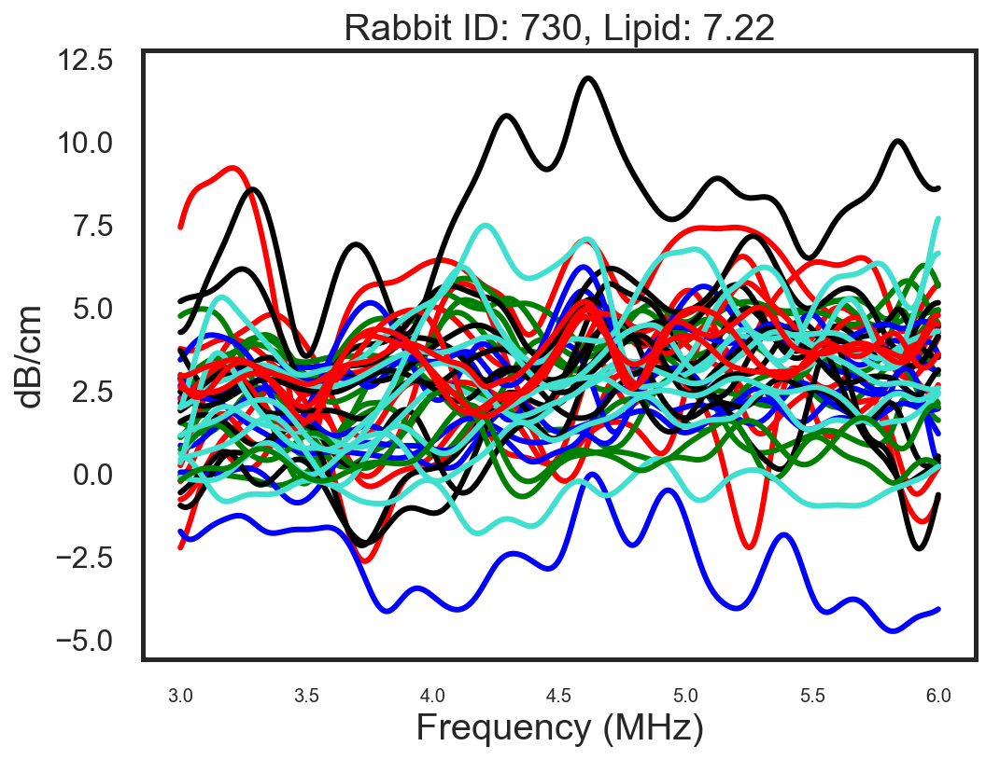

739


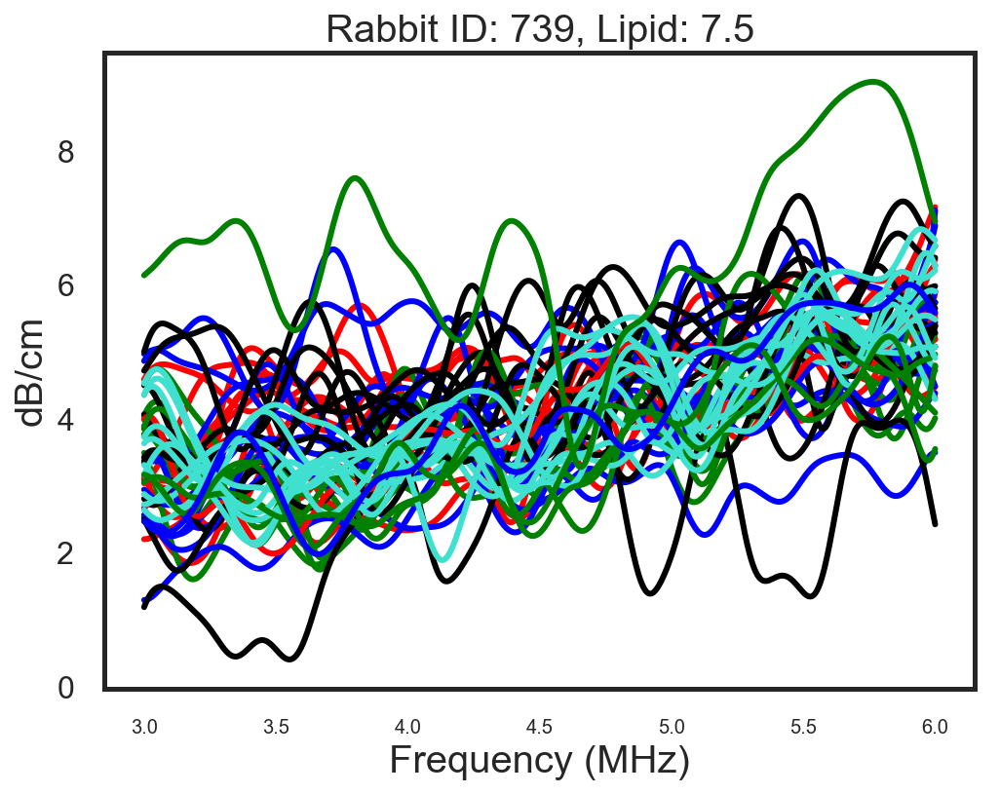

784


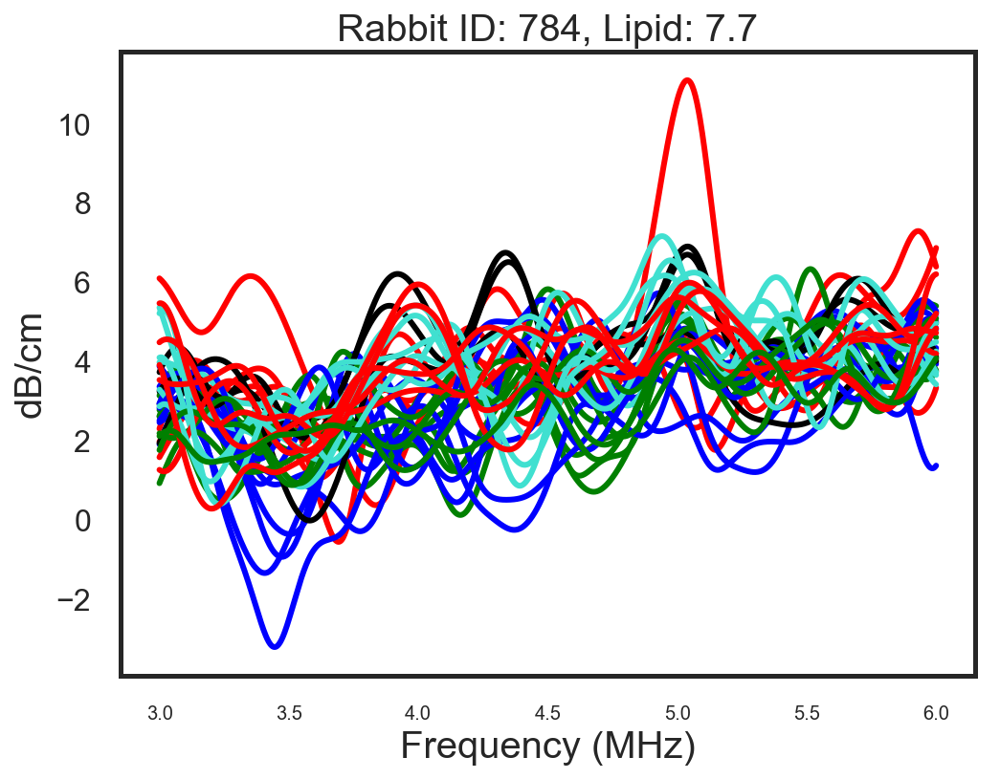

751


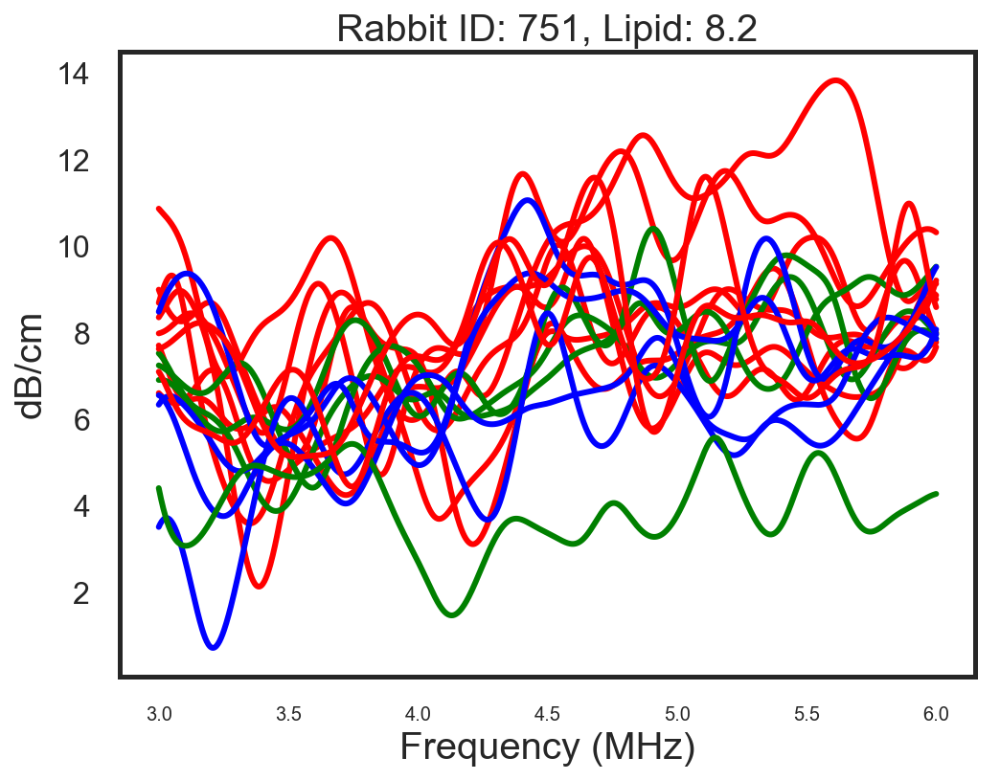

746


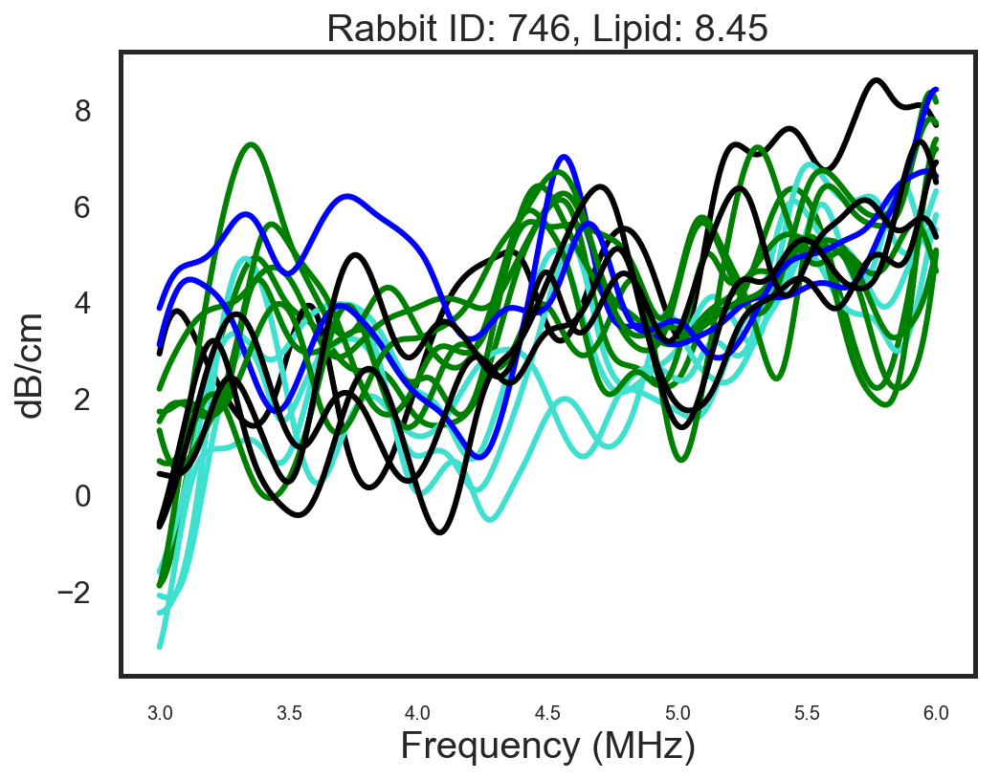

788


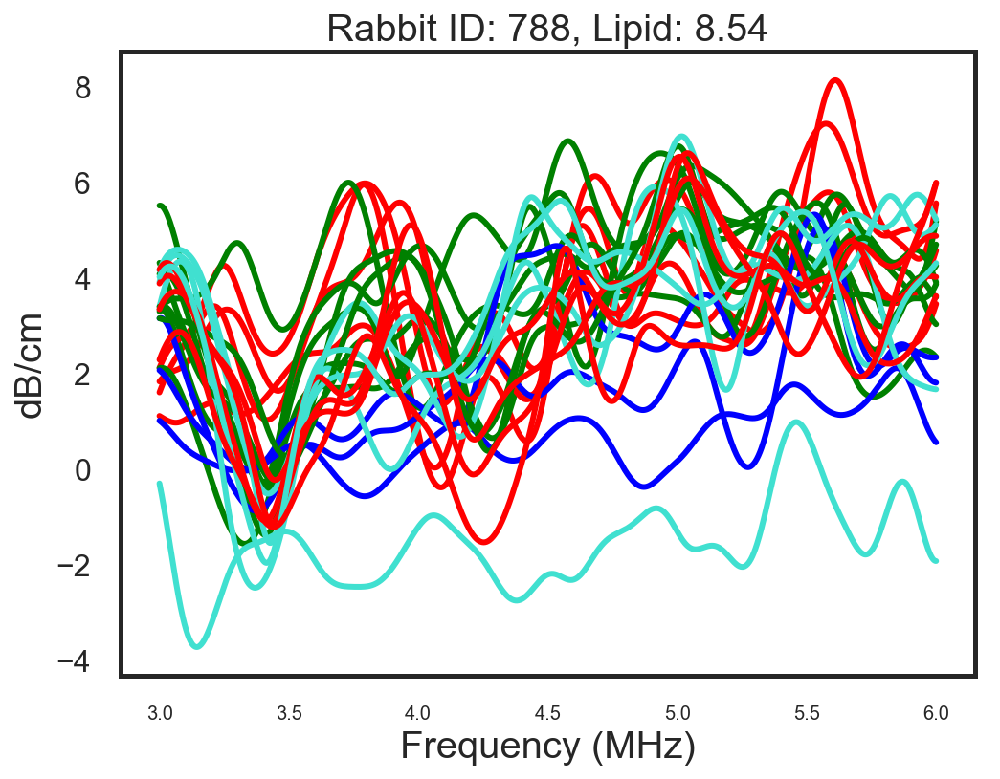

747
NY747
754


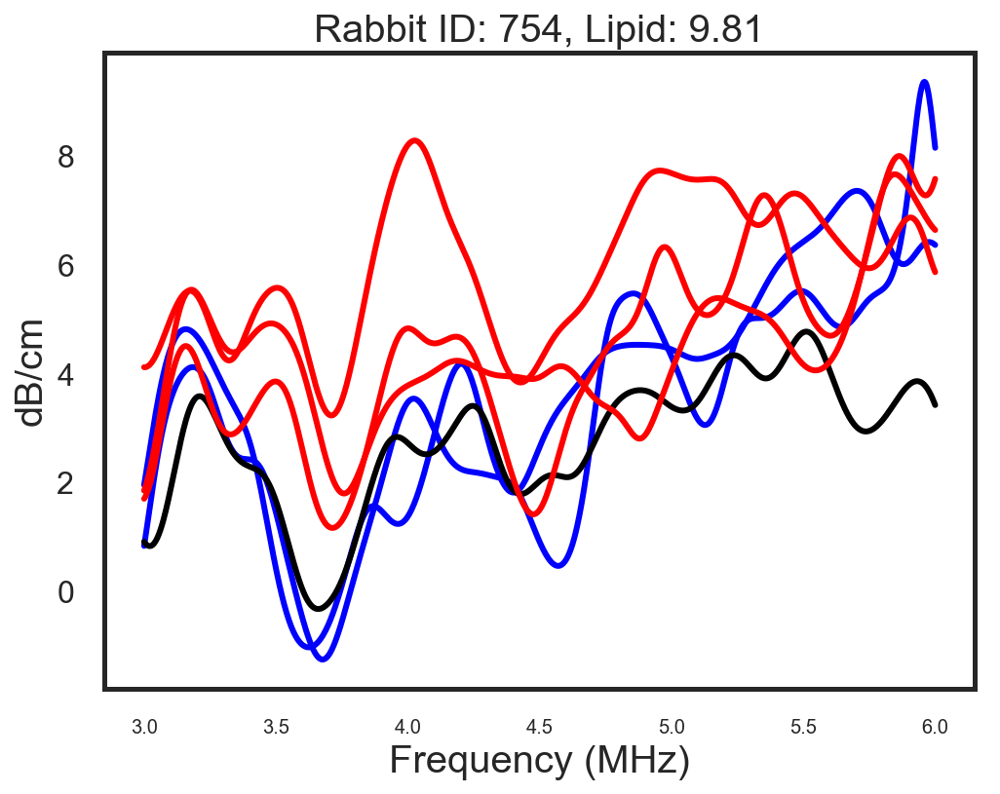

745
NY745
753


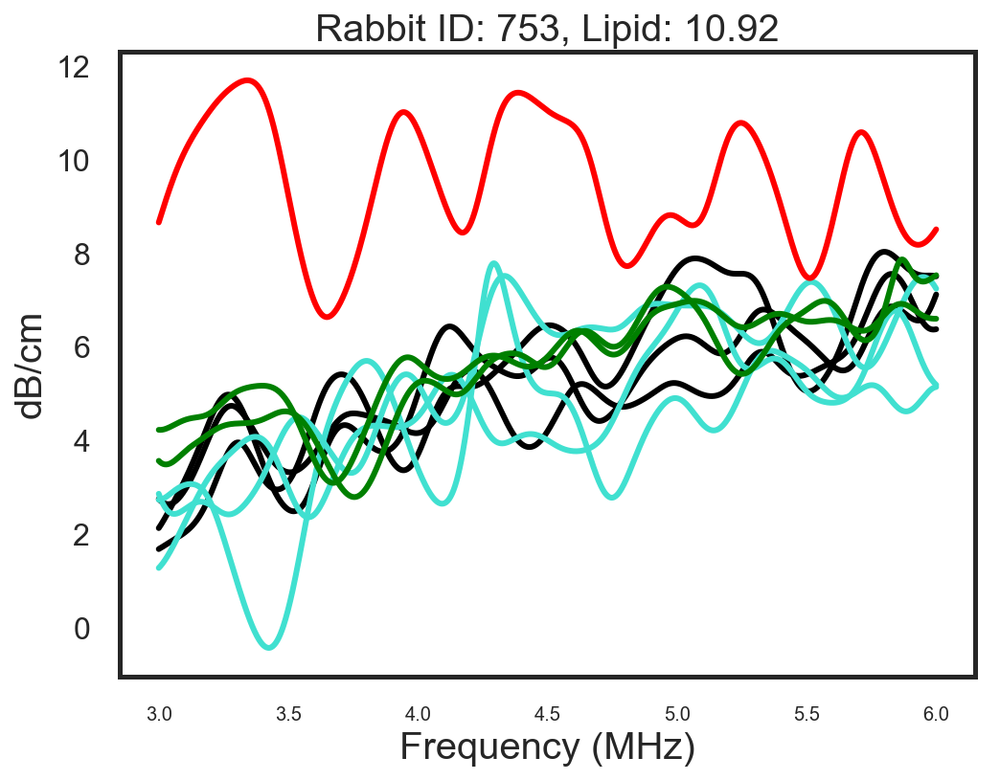

743


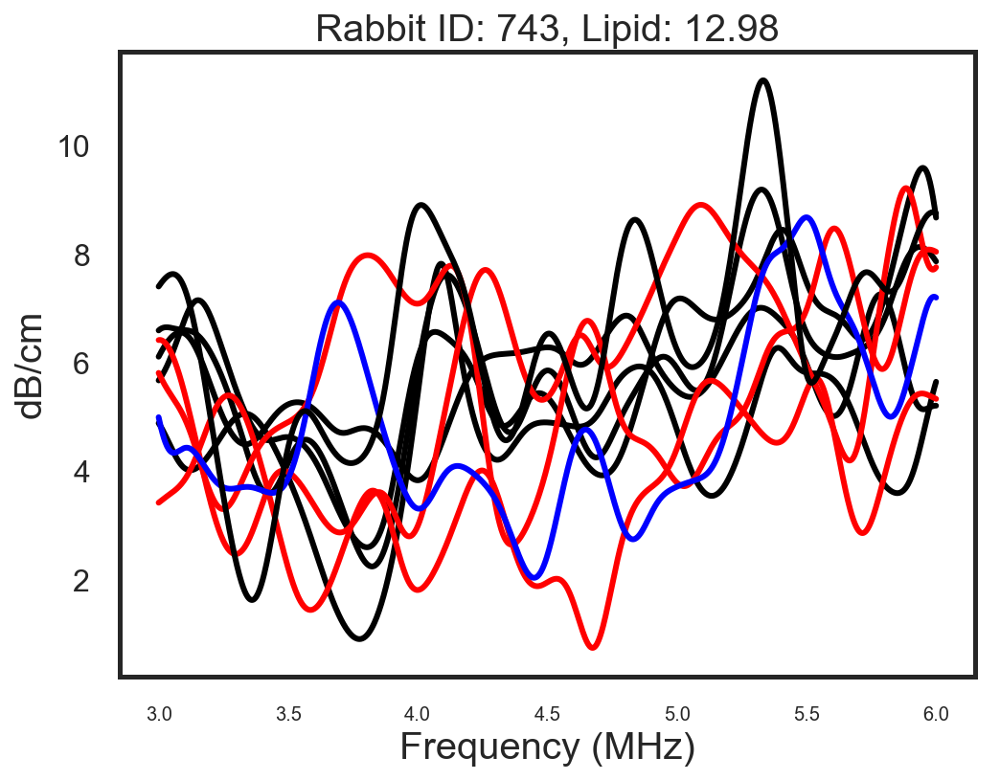

740


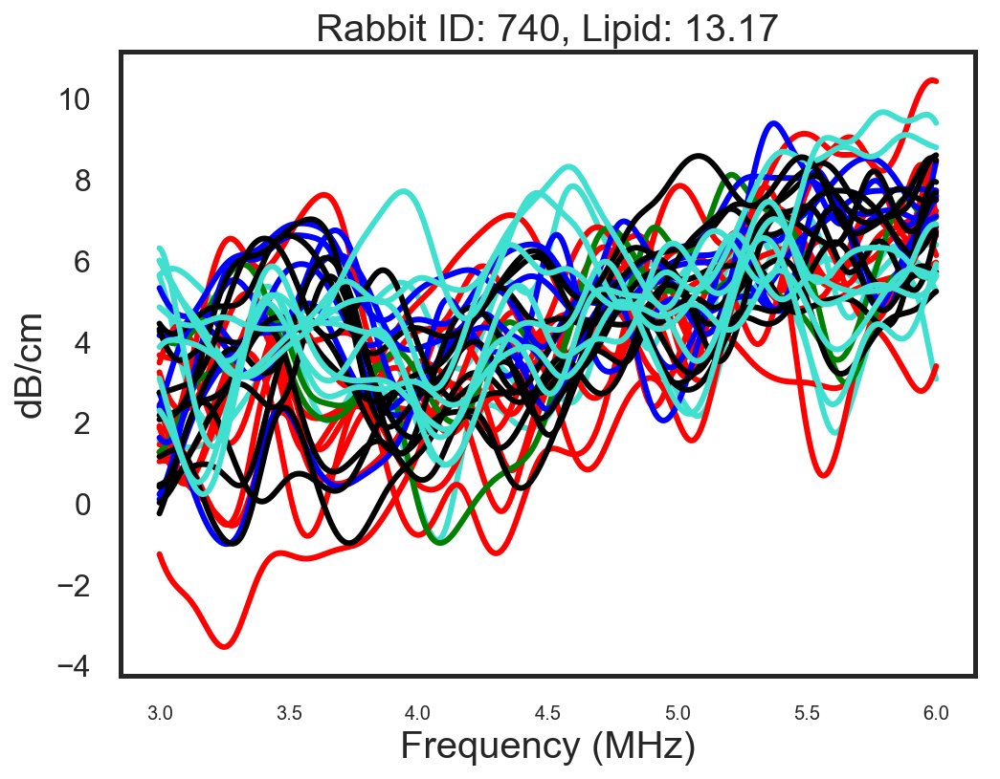

731


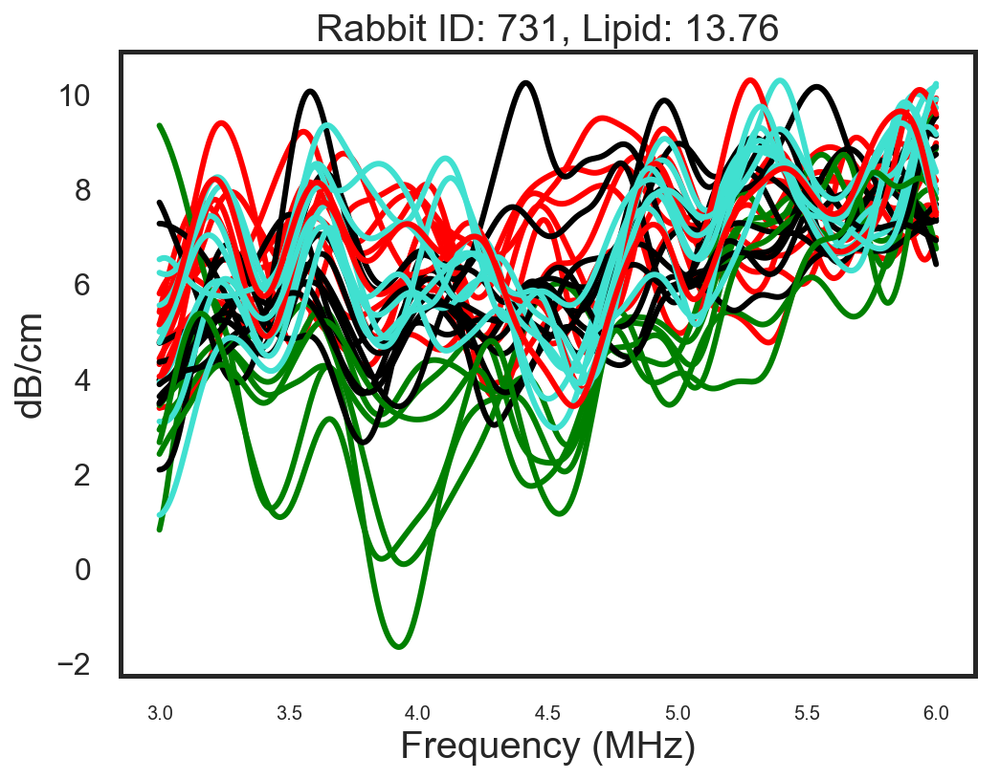

755


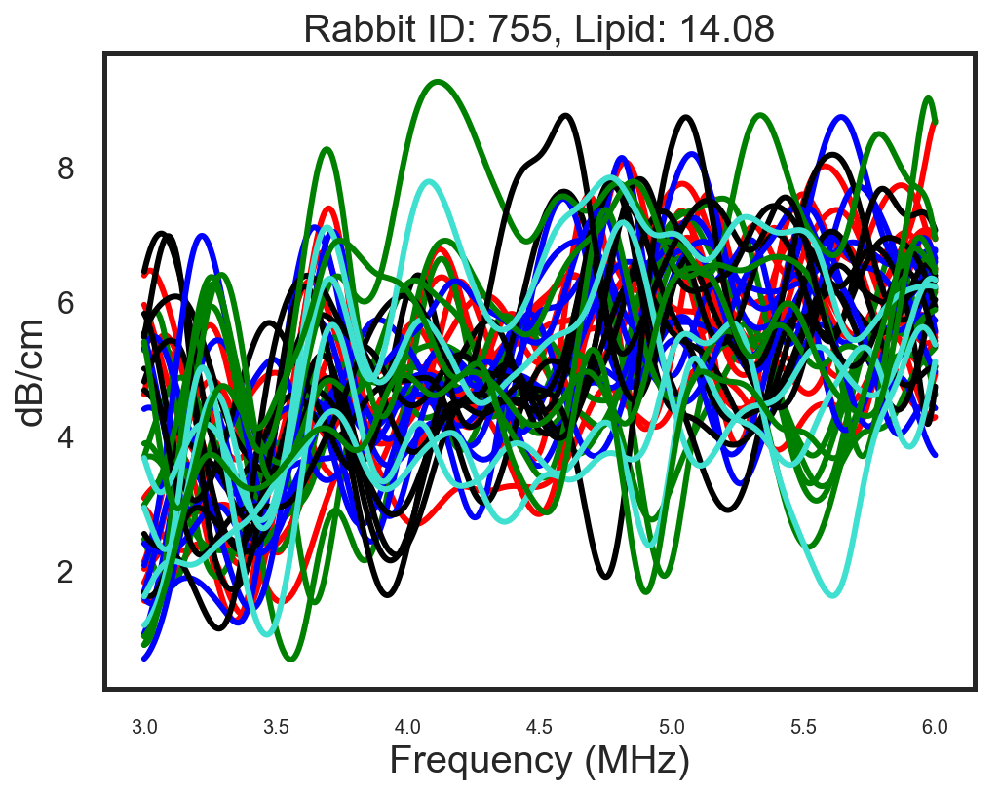

757


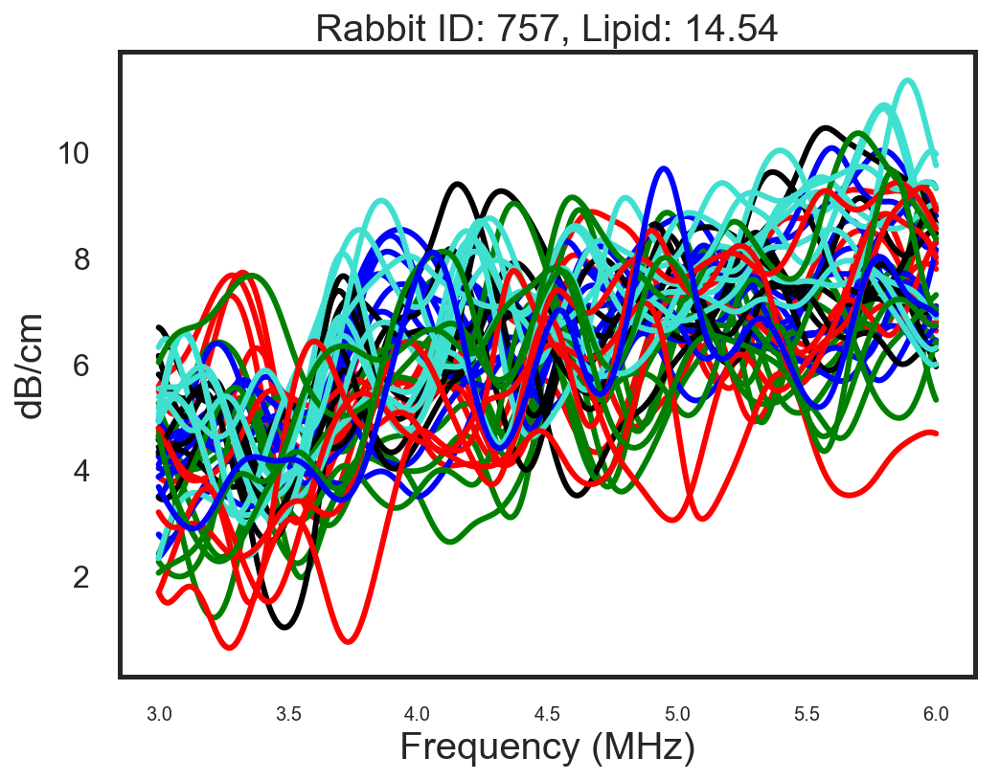

756


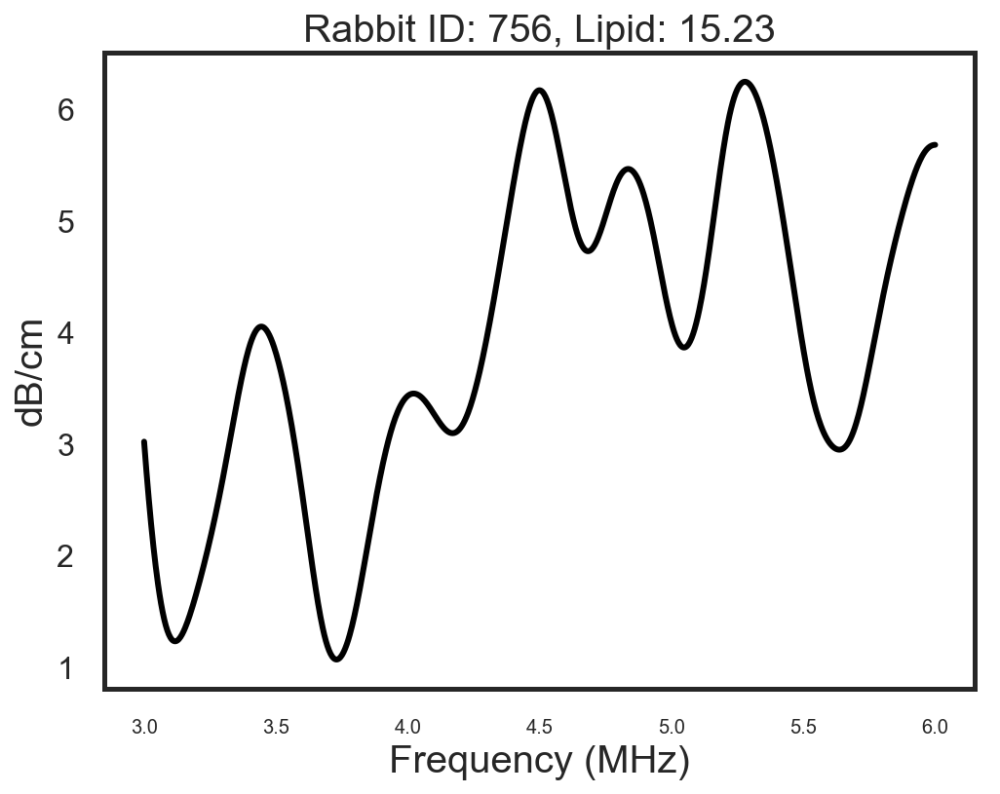

758


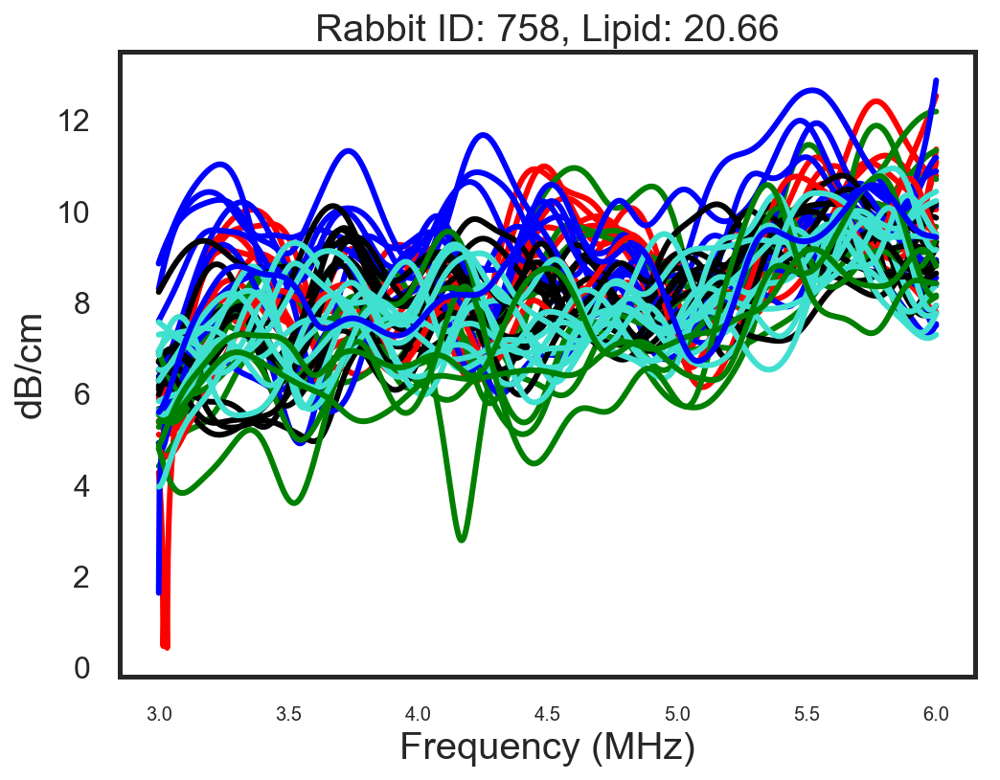

In [36]:
for idx, row in dataBase.iterrows():
    lipid = row.Lipid
    rabbit_number = str(int(row.Rabbit))
    atts = ATTs_dict[rabbit_number]
    depth = depth_dict[rabbit_number]
    print(rabbit_number)
    if (len(atts) == 0):
        print("NY" + rabbit_number)
        continue
    freq_key = next(iter(freq_att_dict[rabbit_number]))
    freq = freq_att_dict[rabbit_number][freq_key].flatten()
  
    plt.figure(figsize = (8, 6))
    for frame_ in atts:
        if (atts[frame_].shape[1] > 0):
            avg_att = np.mean(atts[frame_], axis = 1)
            #no_rois = bscs[frame_].shape[1]
            #mean_depth = np.round(np.max(depth[frame_]))
            #if (no_rois >0):
            plt.plot(freq, avg_att, color = filter_frame(frame_))
    plt.title("Rabbit ID: " + rabbit_number + ", Lipid: " + str(lipid))
    
    #plt.legend(bbox_to_anchor=(1.1, 1.05), ncol=3)
    plt.xlabel('Frequency (MHz)')
    plt.ylabel('dB/cm')
    plt.show()

In [405]:
atts = ATTs_dict['729']

In [ ]:
for key in atts:
    plt.figure()
    print(atts[key].shape)
    plt.plot(atts[key])

import holoviews as hv
hv.extension('bokeh')

In [46]:
def filter_class(x):
    if x > 10:
        color = 'red'
    else:
        color = 'blue'
    return color

In [23]:
from helper_brl.ml_preprocessing import percentageVariance, cal_accuracy, randomize_and_filter

In [28]:
X_train, y_train = get_training_data(dataBase, testing_idx, ATTs_dict, freq_att_dict, depth_dict,False)
X_test, y_test, frame_idx, frame_break = get_testing_data(dataBase, testing_idx, ATTs_dict, freq_att_dict, depth_dict, False)

X_train, y_train, X_test, y_test, idxs1, idxs2 = randomize_and_filter(X_train, y_train, \
                                                                      X_test, y_test)   



729,749,750,Skip,730,739,751,754,753,740,731,755,757,756,758,Skip, Skip, Skip, 752,Skip, Skip, Skip, Skip, Skip, Skip, Skip, Skip, Skip, Skip, Skip, 

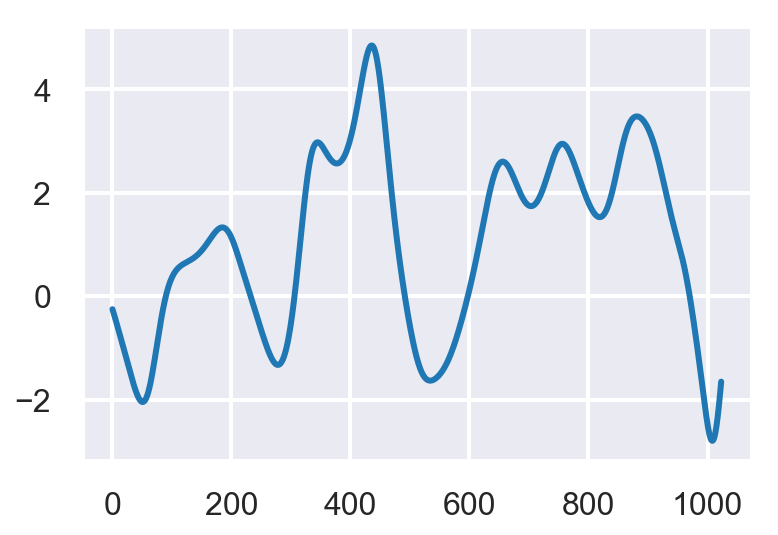

In [31]:
plt.plot(X_train[900,:])

In [30]:
X_test.shape

(228, 1024)

In [59]:
from helper_brl.combineFeatures import combine_bscs_atts  

testing_idx = [752]
X_train, y_train = combine_bscs_atts(dataBase, testing_idx, freq, \
                                         BSCs_dict, ATTs_dict, training = True)



In [19]:
all_idx = dataBase.Rabbit.as_matrix()

In [20]:
from sklearn.linear_model import LogisticRegression

In [21]:
lg_accuracy = np.zeros((15,2))
weights_lg = np.zeros((15, 2))
svm_accuracy = np.zeros((15, 2))
for i in range(15):
    #testing_idx = all_idx[i*no_test_rabbits:i*no_test_rabbits+no_test_rabbits]
    testing_idx = [all_idx[i]]
    print(testing_idx)
    
    X_train, y_train = combine_bscs_atts(dataBase, testing_idx, freq, \
                                         BSCs_dict, ATTs_dict, training = True)

    X_test, y_test = combine_bscs_atts(dataBase, testing_idx, freq, \
                                         BSCs_dict, ATTs_dict, training = False)
    clf_svm = svm.SVC(C=1.0, kernel='linear', gamma=1) #{'C': 10, 'gamma': 0.1}
    clf_svm.fit(X_train[:,2:], y_train)
    
    clf_lg = LogisticRegression()
    clf_lg.fit(X_train[:,2:],y_train)
    weights_lg[i, :] = clf_lg.coef_.squeeze()
    #width = 0.35       # the width of the bars: can also be len(x) sequence
    #p1 = plt.bar(np.arange(4) , clf_lg.coef_.squeeze(), width)
    #plt.title('Weights of each features')
    #sup_t = plt.xticks(ind, ('ESD', 'EAC', 'att slope', 'att mid-band fit'))
    #plt.show()
    print('Intercept')
    print(clf_lg.intercept_)
    y_predict_lg = clf_lg.predict(X_test[:,2:])
    y_predict_svm = clf_svm.predict(X_test[:,2:])
    
    lg_accuracy[i, 0] = accuracy_score(y_test, y_predict_lg)
    lg_accuracy[i, 1] = accuracy_score(y_train, clf_lg.predict(X_train[:,2:]))
    
    svm_accuracy[i, 0] = accuracy_score(y_test, y_predict_svm)
    svm_accuracy[i, 1] = accuracy_score(y_train, clf_svm.predict(X_train[:,2:]))
    print(lg_accuracy[i, 0], lg_accuracy[i, 1], svm_accuracy[i, 0], svm_accuracy[i, 1])

[729]
Intercept
[-4.72613652]
0.7974683544303798 0.787052810902896 0.7848101265822784 0.7915956842703009
[749]
Intercept
[-4.05603768]
0.9178082191780822 0.7622739018087855 0.9006849315068494 0.7655038759689923
[750]
Intercept
[-4.5157865]
1.0 0.7835450027609056 1.0 0.7852015461071231
[752]
Intercept
[-4.16276958]
0.909952606635071 0.7691835481890731 0.9052132701421801 0.7722529158993248
[730]
Intercept
[-4.48573668]
0.8709677419354839 0.7756410256410257 0.8467741935483871 0.7843822843822844
[739]
Intercept
[-4.11481192]
0.7396593673965937 0.7970608817354794 0.7396593673965937 0.7977606717984604
[751]
Intercept
[-5.00916837]
0.05555555555555555 0.8032150776053215 0.05555555555555555 0.802660753880266
[754]
Intercept
[-4.65587765]
0.09090909090909091 0.7895024603608529 0.18181818181818182 0.7922361946418808
[753]
Intercept
[-4.62680554]
0.5641025641025641 0.79011660188784 0.5384615384615384 0.7890061077179344
[740]
Intercept
[-4.99166816]
0.1724137931034483 0.7991021324354658 0.20689655

In [22]:
np.mean(lg_accuracy, axis = 0)

array([0.54141158, 0.78555527])

In [23]:
np.mean(svm_accuracy, axis = 0)

array([0.5152862 , 0.78708119])

In [44]:
mean_weights = np.mean(weights_lg, axis = 0)

std_weights = np.std(weights_lg, axis = 0)

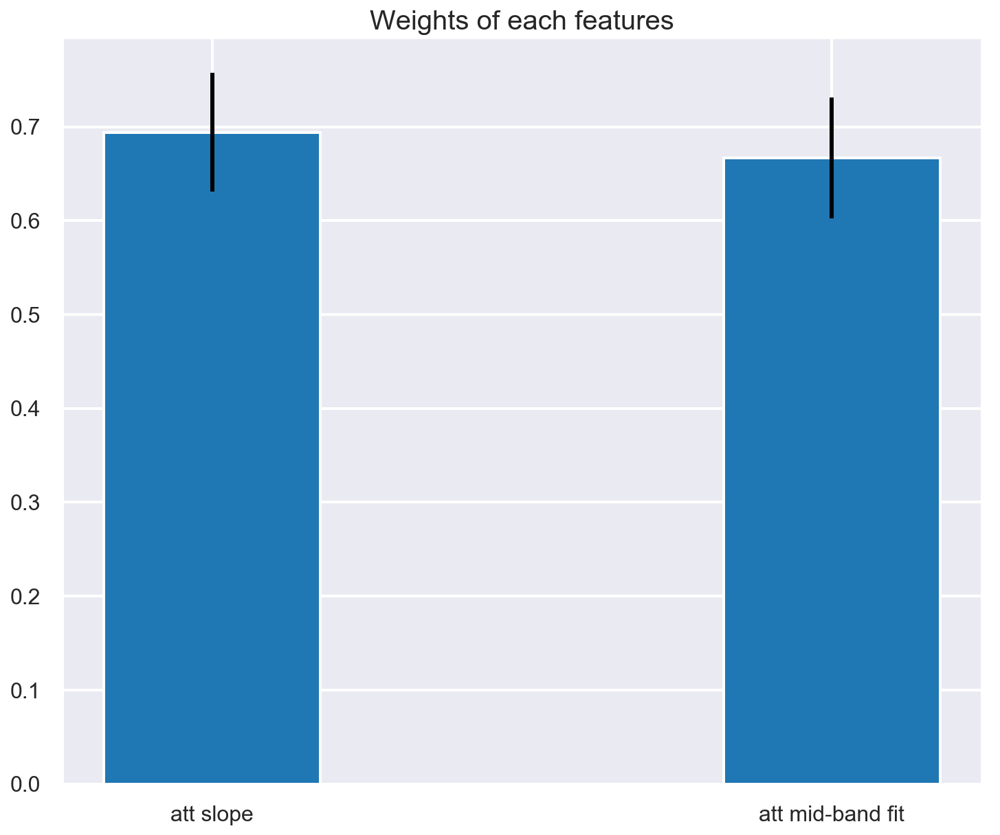

In [47]:
plt.figure(figsize = (12, 10))
width = 0.35       # the width of the bars: can also be len(x) sequence
p1 = plt.bar(np.arange(2) , mean_weights, width, yerr = std_weights)
plt.title('Weights of each features')
sup_t = plt.xticks(np.arange(2), ('att slope', 'att mid-band fit'))

In [48]:
X_train.shape

(1580, 4)

In [49]:
X_test.shape

(260, 4)

In [51]:
l1 = np.where(y_train == 0)[0]
l2 = np.where(y_train == 1)[0]
l3 = np.where(y_test == 0) [0]
l4 = np.where(y_test == 1) [0]

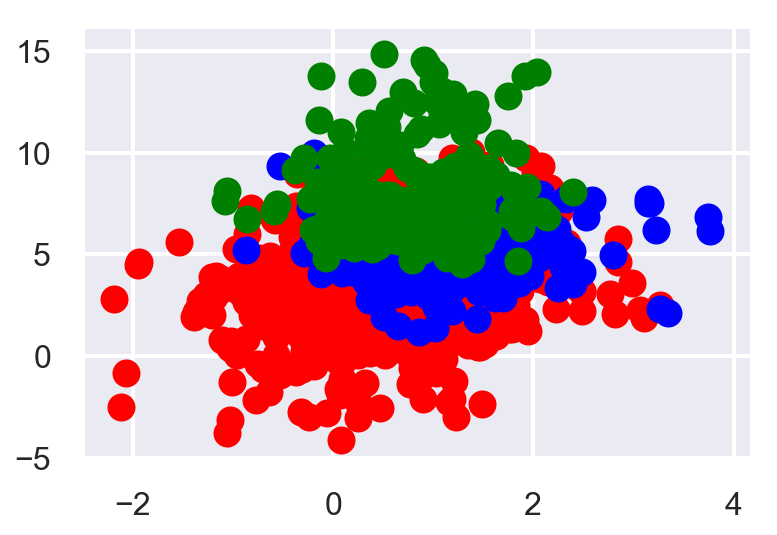

In [52]:
plt.scatter(X_train[l1,2], X_train[l1,3], c = 'r')
plt.scatter(X_train[l2,2], X_train[l2,3], c = 'b')
plt.scatter(X_test[:,2], X_test[:, 3], c= 'g')

Threshold lipid 9.000000


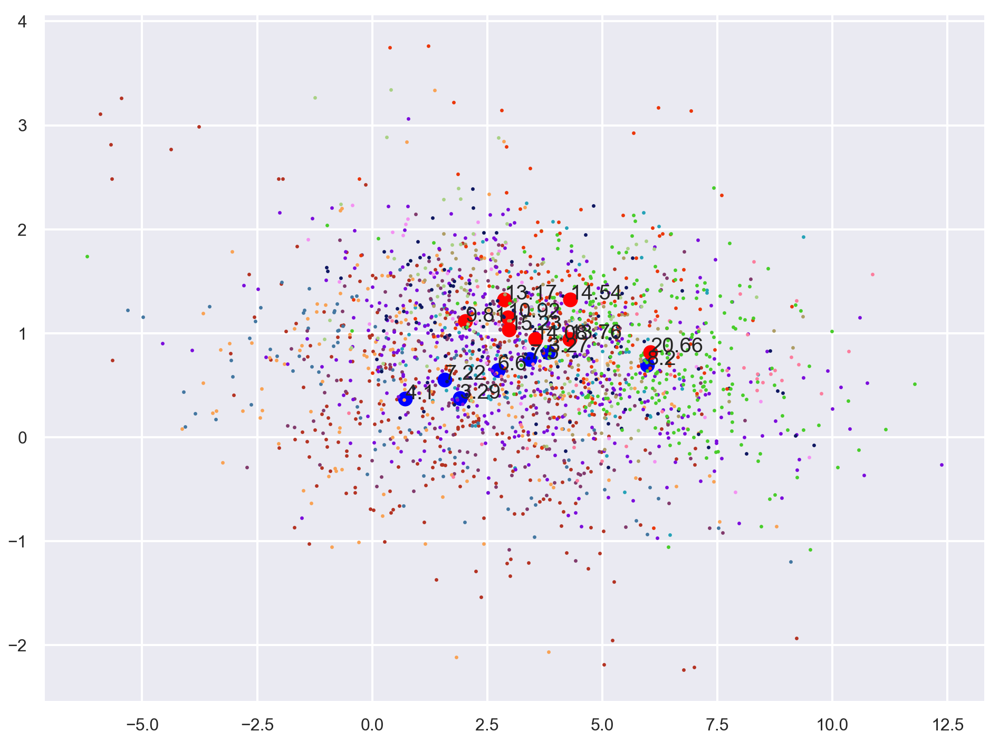

In [36]:
#f, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize = (16, 12))
plt.figure(figsize = (16, 12))
mean_att_red  = []
mean_att_blue = []
slope_intercept_att = np.zeros((15, 2))
print("Threshold lipid %f" % threshold_lipid )
for idx, row in dataBase.iterrows():
    lipid = row.Lipid
    rabbit_number = str(int(row.Rabbit))
    color = np.random.rand(3,)
    #if row['bad Rabbit']:
    #    continue
    atts = ATTs_dict[rabbit_number]
    if (len(atts) == 0):
        continue 
        print(rabbit_number)
    freq_key = next(iter(freq_att_dict[rabbit_number]))
    freq = freq_att_dict[rabbit_number][freq_key].flatten()
    idx = (freq >=4.0) & (freq <=5.0)
    rabbit_att = []
    temp1 = []
    temp2 = []
    for frame_ in atts:
        if (atts[frame_].shape[1] > 0):
            bottom_depth = att_bottom[rabbit_number][frame_].flatten()
            filter_att = []
            for idx in range(bottom_depth.shape[0]): # goes through all the ROIs
                if ((bottom_depth[idx] < 37) and (bottom_depth[idx] >5)):
                    single_att = atts[frame_][:,idx]
                    filter_att.append(single_att)
                    slope, intercept = np.polyfit(freq, single_att, 1)
                    temp1.append(slope)
                    temp2.append(single_att[idx].mean())
                    plt.scatter(single_att[idx].mean(), slope, c = color, s = 2)
            if not filter_att:
                continue
            avg_att = np.mean(np.vstack(filter_att), axis = 0)
            rabbit_att.append(avg_att) #mean att in each frame
    if lipid >=9:
        plt.scatter(np.mean(np.array(temp2)), np.mean(np.array(temp1)), c = 'r')
        plt.text(np.mean(np.array(temp2)), np.mean(np.array(temp1)), str(lipid))
    else:
        plt.scatter(np.mean(np.array(temp2)), np.mean(np.array(temp1)), c = 'b')
        plt.text(np.mean(np.array(temp2)), np.mean(np.array(temp1)), str(lipid))
    #break

In [21]:
single_att.shape

(1024,)

In [ ]:

    if not rabbit_att:
        print(rabbit_number)
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'bad Rabbit'] = True
        continue
    rabbit_att  = np.mean(np.vstack(rabbit_att), axis = 0) #mean att for each rabbit
    idx = (freq >=4.0) & (freq <=5.0)
    if (lipid > threshold_lipid):
        ax1.plot(freq, rabbit_att, color = 'red') 
        ax3.plot(freq, rabbit_att, color = 'red') 
        
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att slope'] = slope
        dataBase.loc[dataBase.Rabbit == row.Rabbit,'att intercept'] = intercept
        dataBase.loc[dataBase.Rabbit == row.Rabbit, 'midband fit'] = rabbit_att[idx].mean()
        mean_att_red.append(rabbit_att)
        ax1.text(freq[-1] + 0.1, rabbit_att[-1], str(lipid), fontsize = 12)
    else:

        ax2.plot(freq, rabbit_att, color = 'blue')
        ax3.plot(freq, rabbit_att, color = 'blue') 
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
            mean_att_blue.append(rabbit_att)
        slope, intercept = np.polyfit(freq, rabbit_att, 1)
        ax2.text(freq[-1] , rabbit_att[-1], str(lipid), fontsize = 12)

